<img src="https://encrypted-tbn0.gstatic.com/images?q=tbn:ANd9GcTaJWG7PzF3toxaRMB1-JicpqMgJuEXATd0fg&" style="width: 150px;margin-top:30px;" align ="center">

<div style= "font-size: 40px;font-weight:bold; font-family: 'Avenir Next LT Pro', sans-serif;"><center>To grant or not to grant:</center></div> <br>
<div style= "font-size: 40px;font-weight:bold; font-family: 'Avenir Next LT Pro', sans-serif;"><center>Deciding on compensation benefits</center></div>

<div style= "font-size: 27px;font-weight:bold;line-height: 1.1; margin-top:40px; font-family: 'Avenir Next LT Pro', sans-serif;"><center>Machine Learning 2024/2025</center></div> <br>

   <div style= "font-size: 20px;font-weight:bold; font-family: 'Avenir Next LT Pro', sans-serif;"><center> Group 50:</center></div>
   <div><center> Eldar Medvedev | r20181162 </center></div>
   <div><center> Jéssica Cristas | 20240488 </center></div>
   <div><center> Joshua Wehr | 20240501 </center></div>
   <div><center> Guilherme Godinho | 20211552 </center></div>
   <div><center> Umeima Adam | 20240543 </center></div>

<!DOCTYPE html>
<html lang="en">
<head>
    <meta charset="UTF-8">
    <meta name="viewport" content="width=device-width, initial-scale=1.0">
    <style>
        body {
            font-family: Arial, sans-serif;
            background-color: #f4f4f4;
            color: #333;
            margin: 0;
            padding: 20px;
            line-height: 1.6;
        }
        ol {
            counter-reset: section 2; /* Start counting from 3 */            
            list-style: none;
            padding-left: 0;
        }
        /* First-level list */
        ol > li {
            counter-increment: section;
            margin-bottom: 10px;
            padding-left: 0;
        }
        ol > li::before {
            content: counters(section, ".") " ";
            font-weight: bold;
        }
        /* Second-level list */
        ol ol {
            counter-reset: subsection;
            padding-left: 20px;
            margin-top: 5px;
        }
        ol ol > li {
            counter-increment: subsection;
            margin-bottom: 5px;
            padding-left: 10px;
        }
        ol ol > li::before {
            content: counters(section, ".") "." counter(subsection) " ";
            font-weight: bold;
        }
        a {
            text-decoration: none;
            color: #007BFF;
            font-weight: bold;
        }
        a:hover {
            color: #0056b3;
        }
        footer {
            margin-top: 50px;
        }
    </style>
</head>
<body>

<h2><b>Index</b></h2>
<ol>
    <li><a href="#3">Data Preprocessing Functions</a> </li>
        <ol>
        <li><a href="#3.1">Functions | Initial steps</a> </li> 
        <li><a href="#3.2">Functions | Support </a> </li> 
        <li><a href="#3.3">Functions | KNN</a> </li>
        <li><a href="#3.4">Functions | Dates</a> </li>
        <li><a href="#3.5">Functions | Additional Preprocessing</a> </li>
        <li><a href="#3.6">Functions | Feature Selection</a> </li>
        <li><a href="#3.7">Functions | Modelling</a> </li>
        </ol>
    <li><a href="#4">Modelling</a> </li>
    <li><a href="#5">Evaluation</a> </li>
    <li><a href="#6">Open Ended Section</a> </li>
</ol>

<footer></footer>

</body>
</html>

## **Note:**


This notebook is our final code, it covers all the steps of the preprocessing, feature selection, modeling, optimizing and resampling.

---

# <a class='anchor' id='3'></a>

> # **3. Data Preprocessing Application** 

#### Importing Data and Libraries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings("ignore")
#Suppress LightGBM warnings
warnings.filterwarnings("ignore", category=UserWarning, module='lightgbm')
pd.set_option('display.max_columns', None)

In [2]:
train = pd.read_csv('train_data.csv')
test = pd.read_csv('test_data.csv')
ar = pd.read_csv('test_ar.csv')
test['Agreement Reached'] = ar['Agreement Reached']

# <a class='anchor' id='3.1'></a>

## **Functions: Initial steps**

In [3]:
def init_():
    """    
    The purpose of init_ function is to extract id (Claim Identifier) from the train and test datasets 
    and target (Claim Injury Type) from train.
    
    """
    # Save train and test id
    train_id = pd.DataFrame(train['Claim Identifier'])
    test_id = pd.DataFrame(test['Claim Identifier'])
    
    # Save target
    target = pd.DataFrame(train['Claim Injury Type'])

    return train_id, test_id, target

In [4]:
def incoherences_between(data_train, data_test, target):
    """ 
    The function aims to make the column structures of the train and test datasets consistent, 
    except for the target column, by dropping columns that do not exist in both datasets.
    
    Parameters:
    - data_train: pd.DataFrame - DataFrame containing the training data.
    - data_test: pd.DataFrame - DataFrame containing the test data.
    - target: pd.DataFrame -
    
    Returns:
    - data_train, data_test - DataFrames without different columns
    
    """
    
    # Columns that exist in the test dataset but are not in the train dataset.
    test_train_inc = [col for col in list(data_test.columns) if col not in list(data_train.columns)]
    
    # Columns that exist in the train dataset but are not in the test dataset.
    train_test_inc = [col for col in list(data_train.columns) if col not in list(data_test.columns)]
    
    # Drop columns that exist in just one dataset (except target)
    train_test_inc.remove(target.columns[0])
        
    data_train = data_train.drop(columns=train_test_inc)
    data_test = data_test.drop(columns=test_train_inc)
    
    return data_train, data_test

In [5]:
def incoherences_within(data, data_id):
    """    
    Cleans a dataset by addressing three types of inconsistencies
    1. Removing rows with too many missing values.
    2. Removing columns with too many missing values.
    3. Removing duplicate rows based on an identifier column.
    
    Parameters:
    - data: pd.DataFrame - DataFrame on which the function is applied
    - data_id: pd.DataFrame - DataFrame with ID 
    
    Returns:
    - data: pd.DataFrame - DataFrame cleaned
    
    """
    # Filter rows with more than 60% missing values
    data = data.loc[data.isna().mean(axis=1) < 0.6]

    # Filter columns with more than 90% missing values
    data = data.loc[:, data.isna().mean(axis=0) < 0.9]

    # Remove duplicate rows based on the `data_id` column
    data = data.drop_duplicates(subset=data_id.columns[0], keep='first')

    return data

In [6]:
def transform_data(data, data_id):
    """
    Processes and transforms the columns of a DataFrame based on their data type and unique value characteristics. 
    Its goal is to prepare the data for analysis and modeling by applying transformations like 
    date conversion, binary mapping, or handling rare categories. 
    Features that could be tranformed to a boolean but have more than 2 unique values are handled with ZeroR 
    (Attorney/Representative, Gender, etc...).
    
    Parameters:
    - data: pd.DataFrame - DataFrame on which the function is applied
    - data_id: pd.DataFrame - DataFrame with ID 
    
    Returns:
    - data: pd.DataFrame - DataFrame with columns transformed
    """

    for col in data.columns:
        
        # Check if column is ID
        if col == data_id.columns[0]:
            print(f"Column '{col}' is ID, no transformation needed")
            
        # Check if the column is of type 'object'
        elif data[col].dtype == 'object':
            
            # If column is of type 'object' attempt to convert to datetime format
            try:
                data[col] = pd.to_datetime(data[col], errors='raise')
                print(f"Column '{col}' is a date, converted to datetime format.")
            except Exception:
                
                # If an error occurs, try transforming the column
                unique_values = data[col].dropna().unique()
                
                if set(unique_values) == {'Y', 'N'}:  # Check if it only has 'Y' and 'N'
                    data[col] = data[col].map({'Y': 1, 'N': 0})
                    print(f"Column '{col}': Transformed Y to 1, N to 0")
                    
                # If there are exactly 2 unique values that are not 'Y' and 'N'
                elif len(unique_values) == 2 and set(unique_values) != {'Y', 'N'}:
                    most_frequent_value = data[col].mode()[0]
                    least_frequent_value = data[col].value_counts().idxmin()
                    
                    # Assign 1 to most frequent value, 0 to another 
                    data[col] = data[col].map({most_frequent_value: 1, least_frequent_value: 0})
                    print(f"Column '{col}': Transformed '{most_frequent_value}' to 1, '{least_frequent_value}' to 0")
                    
                # If there are more than 2 unique values but less or equal to 4
                # If % of some unique values is low, we replace it by ZeroR value and transform column to boolean.
                elif 2 < len(unique_values) <= 4:
                    most_frequent_value = data[col].mode()[0]

                    # Get the normalized value counts and identify values with counts lower than 0.001
                    normalized_counts = data[col].value_counts(normalize=True)

                    # Filter values with normalized counts lower than 0.001
                    values_to_transform = normalized_counts[normalized_counts < 0.001].index

                    # Replace these values with the most frequent value (ZeroR)
                    data[col] = data[col].replace(values_to_transform, most_frequent_value)
                    
                    # Replace Unknown with the most frequent value (ZeroR)
                    data[col] = data[col].replace('U', most_frequent_value)
                    least_frequent_value = data[col].value_counts().idxmin()
                    
                    # Re-check unique values and attempt transformation again
                    unique_values = data[col].dropna().unique()
                    if len(unique_values) == 2 and set(unique_values) != {'Y', 'N'}:
                        data[col] = data[col].map({most_frequent_value: 1, least_frequent_value: 0})
                        print(f"Column '{col}': Transformed '{most_frequent_value}' to 1, {least_frequent_value} to 0")

                    elif set(unique_values) == {'Y', 'N'}:
                        data[col] = data[col].map({'Y': 1, 'N': 0})
                        print(f"Column '{col}': Transformed Y to 1, N to 0")
                        
                    else:
                        print(f"Column '{col}' with <=4 unique values, no further transformation applied.")
                        
                # If column cannot be handled with this function, we skip it       
                else:
                    print(f"Column '{col}' cannot be converted. Skipping...")
                    
        # If column is numerical, we skip it
        elif data[col].dtype in ['float64', 'int64']:
            print(f"Column '{col}' is numerical, no transformation needed")
    
    return data


# <a class='anchor' id='3.2'></a>
## **Functions: Support**

In [7]:
import operator

def redflags(data, cols, conditions, bounds):
    """
    Adds Red Flag columns for either:
    - Multiple columns (one condition per column) or
    - A single column (multiple conditions combined).

    Parameters:
    - data: pd.DataFrame - DataFrame where the Red Flags will be added.
    - cols: str or list -  Column(s) to apply conditions on.
    - conditions: list -  List of conditions (e.g., ['>', '<']).
    - bounds: list - List of bounds corresponding to each condition.

    Returns:
    - data: pd.DataFrame - Updated DataFrame with the Red Flag columns.
    """
    
    # Map condition strings to corresponding operator functions
    operations = {
        '<': operator.lt,
        '>': operator.gt,
        '==': operator.eq,
        '<=': operator.le,
        '>=': operator.ge,
        '!=': operator.ne,
    }

    # Case 1: Single Column (Apply multiple conditions to one column)
    if isinstance(cols, str):
        # Ensure that the number of conditions matches the number of bounds
        if len(conditions) != len(bounds):
            raise ValueError("The number of conditions must match the number of bounds for a single column.")
        
        # Create a new column for Red Flags, initialize it to 0 (no flags initially)
        flag_col_name = f'Red_Flag_{cols}'
        data[flag_col_name] = 0  # Start with all zeros
        
        # Apply each condition and update the Red Flag column
        for condition, bound in zip(conditions, bounds):
            op_func = operations.get(condition) # Get the corresponding operator function
            if op_func is None:
                raise ValueError(f"Invalid condition: {condition}")
            
           # Update Red Flag column using logical OR to combine multiple conditions
            data[flag_col_name] |= op_func(data[cols], bound).astype(int)

    # Case 2: Multiple Columns (Each column gets its own condition and bound)
    elif isinstance(cols, list):
        # Ensure the lengths of `cols`, `conditions`, and `bounds` match
        if len(cols) != len(conditions) or len(cols) != len(bounds):
            raise ValueError("For multiple columns, `cols`, `conditions`, and `bounds` must have the same length.")
        
        # Iterate over each column and apply its condition and bound
        for col, condition, bound in zip(cols, conditions, bounds):
            op_func = operations.get(condition)
            if op_func is None:
                raise ValueError(f"Invalid condition: {condition}")
            
            # Create a separate Red Flag column for each column
            data[f'Red_Flag_{col}'] = op_func(data[col], bound).astype(int)
            
    # Case 3: Invalid `cols` type
    else:
        raise ValueError("`cols` must be a string (for a single column) or a list (for multiple columns).")
    
    return data

In [8]:
def fill_with_0(data,cols):
    """
    Fills missing values (NaN) with 0 for specified columns in a DataFrame.

    Parameters:
    - data: pd.DataFrame - The input DataFrame where missing values will be filled.
    - cols: list - A list of column names to process.

    Returns:
    - data: pd.DataFrame - The updated DataFrame with missing values replaced by 0 in the specified columns.
    """

    for col in cols:
        data[col] = data[col].fillna(0)
        
    return data

In [9]:
def missing_cols(data, cols):
    """
    Creates new binary columns to indicate missing values in the specified columns.

    Parameters:
    - data: pd.DataFrame - Input DataFrame where missing value indicators will be added.
    - cols: list - List of column names to check for missing values.

    Returns:
    - data: pd.DataFrame -  Updated DataFrame with additional 'Missing_<col>' binary columns.
    """
    
    for col in cols:
        
        # Create a new column 'Missing_<col>' that is 1 if the value is missing, 0 otherwise
        data['Missing_'+ col] = data[col].isnull().astype(int)

    return data

In [10]:
def outlier_identifier(data , col):
    """
    Identifies outlier thresholds for a given column using the Interquartile Range (IQR).
    Also calculates a separate upper limit for positive values (> 0).

    Parameters:
    - data: pd.DataFrame - The input DataFrame.
    - col: str - The name of the column for which outlier thresholds will be calculated.

    Returns:
    - tuple: A tuple containing:
            - lower_limit: The lower threshold for outliers.
            - upper_limit: The upper threshold for outliers.
            - upper_limit_bigger_0: The upper threshold for outliers among positive values (> 0),
              or None if there are no positive values.
    """
    
    Q1 = data[col].quantile(0.25)
    Q3 = data[col].quantile(0.75)
    IQR = Q3 - Q1
    lower_limit = Q1 - 1.5 * IQR
    upper_limit = Q3 + 1.5 * IQR

    # Calculate the upper limit for positive values, if any exist
    data_positive = data[data[col] > 0]
    if not data_positive.empty:  # Check if there are positive values
        Q3_positive = data_positive[col].quantile(0.75)
        IQR_positive = Q3_positive - data_positive[col].quantile(0.25)
        upper_limit_bigger_0 = Q3_positive + 1.5 * IQR_positive
    else:
        upper_limit_bigger_0 = None  # Set to None if no positive values exist

    return lower_limit, upper_limit, upper_limit_bigger_0



In [11]:
def drop_col(data, cols):
    """
    Drops specified columns from a DataFrame, ignoring errors if a column does not exist.

    Parameters:
    - data: pd.DataFrame - The input DataFrame.
    - cols: list - List of column names to drop.

    Returns:
    data: pd.DataFrame - Updated DataFrame with specified columns removed.
    """

    for col in cols:
        try:
            data = data.drop(columns=[col])
        except:
                pass
    
    return data

In [12]:
def change_types(data):
    """
    Changes the data types of specified columns in a DataFrame to ensure 
    consistency. (Used for debugging)

    Parameters:
    - data: pd.DataFrame - The input DataFrame with columns to convert.

    Returns:
    - data: pd.DataFrame - Updated DataFrame with specified columns converted to target data types.
    """

    data['Alternative Dispute Resolution'] = data['Alternative Dispute Resolution'].astype('int32', errors='ignore')
    data['Is Weekend'] = data['Is Weekend'].astype('int32', errors='ignore')
    data['Age at Injury'] = data['Age at Injury'].astype('int64', errors='ignore')
    data['Attorney/Representative'] = data['Attorney/Representative'].astype('int32', errors='ignore')
    data['COVID-19 Indicator'] = data['COVID-19 Indicator'].astype('int32', errors='ignore')
    data['IME-4 Count'] = data['IME-4 Count'].astype('int64', errors='ignore')
    
    return data

In [13]:
def join_bool(data, cols, name):
    """
    Creates a new column in the data DataFrame that aggregates the values from a list of specified columns (cols). 
    This will be used for dealing with one-hot encoded columns.
    
    Parameters:
    - data: pd.DataFrame - DataFrame on which the function is applied
    - cols: list - Target columns for joining
    - name: str - Name of a new column
    
    Returns:
    - data: pd.DataFrame - DataFrame with joined column 
    """
    # Initialize the new column with 0s
    data[name] = 0
    
    for col in cols:
        if col in data.columns:
            # Add the values of the existing column to the new column
            data[name] += data[col]
    
    return data

    

In [14]:
def remove_first_and_last(string):
    """
    Removes the first and last words from a given string.
    
    Parameters:
    - string: str - The input string.
        
    Returns:
    - str: The string with the first and last words removed. If the input has
           two or fewer words, returns an empty string.
    """
    
    words = string.split()  # Split the string into a list of words
    if len(words) <= 2:     # If there are 2 or fewer words, return an empty string
        return ""
    
    return " ".join(words[1:-1])

In [15]:
def encode_columns(cols, data_train, data_test, test, method="frequency"):
    """
    Encodes specified columns in training and testing datasets using either 
    frequency encoding or one-hot encoding.

    Parameters:
    - cols: list - List of column names to encode.
    - data_train: pd.DataFrame - Training dataset.
    - data_test: pd.DataFrame - Testing dataset.
    - test: pd.DataFrame - Testing dataset for kaggle submission.
    - method: str - Encoding method, either "frequency" or "onehot" (Default = frequency).

    Returns:
    - data_train, data_test, test - Updated training and testing DataFrames with encoded columns.

    Raises:
    - ValueError: If the `method` is not "frequency" or "onehot".
    """
    
    if method not in ["frequency", "onehot"]:
        raise ValueError("The method must be 'frequency' or 'onehot'.")

    if method == "frequency":
        for col in cols:
            # Create frequency encoding
            frequency_encoding = data_train[col].value_counts().to_dict()
            data_train[col + " Frequency"] = data_train[col].map(frequency_encoding)

            data_test[col + " Frequency"] = data_test[col].map(frequency_encoding)
            # In case if there are values that exist in test but does not exist in train
            data_test[col + " Frequency"] = data_test[col + " Frequency"].fillna(0)

            test[col + " Frequency"] = test[col].map(frequency_encoding)
            # In case if there are values that exist in test but does not exist in train
            test[col + " Frequency"] = test[col + " Frequency"].fillna(0)
    
    
    elif method == "onehot":
        for col in cols:
            prefix = col.split()[0]

            # Apply one-hot encoding to both data and test
            one_hot_encoded_train = pd.get_dummies(data_train[col], prefix=prefix, drop_first=False)
            one_hot_encoded_test = pd.get_dummies(data_test[col], prefix=prefix, drop_first=False)

            one_hot_encoded_test_kaggle = pd.get_dummies(test[col], prefix=prefix, drop_first=False)

            # Concatenate the one-hot encoded columns back to the original DataFrame
            data_train = pd.concat([data_train, one_hot_encoded_train], axis=1)
            data_test = pd.concat([data_test, one_hot_encoded_test], axis=1)

            test = pd.concat([test, one_hot_encoded_test_kaggle], axis=1)

    return data_train, data_test, test


In [16]:
def split_data(X, y, test_size=0.25, random_state=42):
    """
    Splits the dataset into training and test sets.

    Parameters:
    - X (pd.DataFrame or np.array): Features dataset.
    - y (pd.Series or np.array): Target labels.
    - test_size (float): Proportion of the dataset to include in the test split.
    - random_state (int): Random seed for reproducibility.
    - stratify (bool): Whether to stratify the split based on `y`.

    Returns:
    - X_train, X_test, y_train, y_test: Split datasets.
    """

    X_train, X_test, y_train, y_test = train_test_split(
            X, y, test_size=test_size, random_state=random_state, stratify=y
        )


    print(f"Data split complete: Training size = {len(X_train)}, Test size = {len(X_test)}")
    return X_train, X_test, y_train, y_test


# <a class='anchor' id='3.3'></a>
## **Functions: KNN**

In [17]:
def get_corr(data, target_col, n_corr=5):
    """
    Identifies the columns in a dataset (data) that have the strongest correlations
    with a specified target column (target_col). It selects a specified number (n_corr) of the most correlated columns,
    prioritizing boolean-like columns, while excluding columns with missing values and IME-4 Count excluded columns.
    IME-4 Count is excluded due to empirical research. Missing IME-4 Count is more prefered and they have high correlation.
    
    Parameters:
    - data: pd.DataFrame - DataFrame on which the function is applied
    - target_col: str - Target column name
    - n_corr: int - Number of columns with highest correlation (default = 5)
    
    Returns:
    - selected_columns: list - List of highest correlation columns
    
    """
    
    correlations = data.corr()[target_col].abs().sort_values(ascending=False)
    
    # Exclude the target column itself and the IME-4 Count
    top_columns = correlations.index[1:] # Start from 1 to exclude the target column
    exclude_cols = [col for col in data.columns if data[col].isnull().any()] + ['IME-4 Count']
    top_columns = [col for col in top_columns if col not in exclude_cols]
    
    # Identify boolean-like columns (int with only values 0 and 1)
    boolean_columns = [col for col in top_columns if data[col].nunique() == 2 and sorted(data[col].unique()) == [0, 1]]
    non_boolean_columns = [col for col in top_columns if col not in boolean_columns]
    
    # Take up to 2 boolean columns
    selected_boolean_columns = boolean_columns[:2]
    
    # Take the remaining columns from non-boolean ones to complete n_corr
    remaining_count = n_corr - len(selected_boolean_columns)
    selected_non_boolean_columns = non_boolean_columns[:remaining_count]
    
    # Combine the selections
    selected_columns = selected_boolean_columns + selected_non_boolean_columns
    
    print(f"Our '{target_col}' has the highest correlation with {selected_columns}.")
    
    return selected_columns

In [18]:
def knn_features(data):
    """
    Combines a lists of features from get_corr function for every column with missing values
    in order to give to knn function a list of unique features without repetitions.
    
    Parameters:
    - data: pd.DataFrame - DataFrame on which the function is applied.
    
    Returns:
    - features_for_knn: list - List of features with highest correlations without repetitions 
    
    """
    columns_with_nan = [col for col in data.columns if data[col].isnull().any()]

    features_for_knn = []
    
    for col in columns_with_nan:
        features_for_knn.append(get_corr(data, col))

    features_for_knn = list(set(item for sublist in features_for_knn for item in sublist))

    return features_for_knn

In [19]:
from sklearn.impute import KNNImputer
from sklearn.preprocessing import MinMaxScaler


def knn(data_train, data_test, test, target_cols, features, n_neighbors=5):
    """
    Imputes missing values using KNN, applying Min-Max Scaling beforehand and reversing the scaling afterward, 
    ensuring no data leakage in the test set.

    Parameters:
    - data_train: pd.DataFrame - DataFrame containing the training data.
    - data_test: pd.DataFrame - DataFrame containing the test data.
    - test: pd.DataFrame - DataFrame containing the test data for kaggle submission.
    - target_cols: list - Target columns for imputation.
    - features: list - Feature columns to use for KNN.
    - n_neighbors: int - Number of neighbors for KNN. Default is 5.

    Returns:
    - data_train, data_test, test updated dataframes.
    """


    # Identify indexes of missing and non-missing values in train dataset
    missing_indices_train = data_train.loc[data_train[target_cols].isnull().any(axis=1)].index
    not_missing_indices_train = data_train.loc[data_train[target_cols].notnull().all(axis=1)].index

    # Sample 15% observations without missing values
    sampled_indices_train = np.random.choice(
        not_missing_indices_train, 
        size=max(1, int(0.15 * len(not_missing_indices_train))), 
        replace=False
    )

    # Combine our sample with missing rows
    combined_indices_train = np.concatenate([missing_indices_train, sampled_indices_train])

    # Train subset for knn. 
    subset_train = data_train.loc[combined_indices_train, target_cols + features]

    # Here we fit_transform MinMaxScaler for train
    scaler = MinMaxScaler()
    scaled_subset_train = pd.DataFrame(
        scaler.fit_transform(subset_train),
        columns=target_cols + features,
        index=combined_indices_train
    )

    # Prepare KNNImputer and fit just for train 
    knn_imputer = KNNImputer(n_neighbors=n_neighbors)
    knn_imputer.fit(scaled_subset_train)

    # Transform for train
    imputed_train = knn_imputer.transform(scaled_subset_train)

    # Unscaling train data
    imputed_data_unscaled_train = pd.DataFrame(
        scaler.inverse_transform(imputed_train),
        columns=target_cols + features,
        index=combined_indices_train
    )

    # Replace values imputed in data_train 
    data_train.loc[missing_indices_train, target_cols] = imputed_data_unscaled_train.loc[missing_indices_train, target_cols]

    # Test subset for knn
    subset_test = data_test[target_cols + features]
    subset_test_kaggle = test[target_cols + features]

    # Just transform MinMaxScaler for test
    scaled_test = pd.DataFrame(
        scaler.transform(subset_test),
        columns=target_cols + features,
        index=data_test.index
    )

    scaled_test_kaggle = pd.DataFrame(
        scaler.transform(subset_test_kaggle),
        columns=target_cols + features,
        index=test.index
    )


    # Just transform for test without fit
    imputed_test = knn_imputer.transform(scaled_test)

    imputed_test_kaggle = knn_imputer.transform(scaled_test_kaggle)

    # Unscaling test data
    imputed_data_unscaled_test = pd.DataFrame(
        scaler.inverse_transform(imputed_test),
        columns=target_cols + features,
        index=data_test.index
    )

    imputed_data_unscaled_test_kaggle = pd.DataFrame(
        scaler.inverse_transform(imputed_test_kaggle),
        columns=target_cols + features,
        index=test.index
    )

    # Replace values imputed in data_est
    data_test[target_cols] = imputed_data_unscaled_test[target_cols]

    test[target_cols] = imputed_data_unscaled_test_kaggle[target_cols]

    # Final ajustments (rounding Age and Industry Code Avg_Salary)
    data_train['Age at Injury'] = data_train['Age at Injury'].round()
    data_train['Industry Code Avg_Salary'] = data_train['Industry Code Avg_Salary'].round()

    data_test['Age at Injury'] = data_test['Age at Injury'].round()
    data_test['Industry Code Avg_Salary'] = data_test['Industry Code Avg_Salary'].round()

    test['Age at Injury'] = test['Age at Injury'].round()
    test['Industry Code Avg_Salary'] = test['Industry Code Avg_Salary'].round()

    return data_train, data_test, test


# <a class='anchor' id='3.4'></a>
## **Functions: Dates**

In [20]:
def greenflag_dates(data):
    """
    Adds a 'Greenflag Dates' column to indicate whether the dates are in "best" order.

    Parameters:
    - data: pd.DataFrame - Input DataFrame containing the relevant date columns.

    Returns:
    - data: pd.DataFrame - Updated DataFrame with a new binary 'Greenflag Dates' column.
    """

    data['Greenflag Dates'] = (
    (data['Accident Date'] <= data['C-2 Date']) &
    (data['C-2 Date'] <= data['Assembly Date']) &
    (data['Assembly Date'] <= data['C-3 Date'])&
    (data['C-3 Date'] <= data['First Hearing Date'])
    ).astype(int) # Convert boolean values to 1 (True) or 0 (False)

    return data

In [21]:
from itertools import permutations

def create_date_sequence_columns(data, date_columns):
    """
    Creates new columns to validate all permutations of a sequence of date columns.

    Parameters:
    - data: pd.DataFrame - The input DataFrame containing date columns.
    - date_columns: list - List of column names representing date columns.

    Returns:
    - data: pd.DataFrame - Updated DataFrame with new boolean columns for each date sequence.
    """   

    # Generate all permutations of the date columns
    sequences = list(permutations(date_columns))
    
    # Iterate over each permutation of the date columns
    for seq in sequences:
        col_name = ' - '.join(seq)  # Name for the new column
        data[col_name] = (data[seq[0]] <= data[seq[1]]) & (data[seq[1]] <= data[seq[2]])  # Check the correct order for the sequence
    
    return data

In [22]:
def dates_null_comparison(data, cols):
    """
    Creates binary indicator columns to check combinations of missing and non-missing values
    between two specified columns.

    Parameters:
    - data: pd.DataFrame - The input DataFrame where the checks will be applied.
    - cols: list - A list containing exactly two column names [col1, col2].

    Returns:
    - data: pd.DataFrame - Updated DataFrame with four new binary columns.
    """
    
    # Extract the two column names for readability
    col1 = cols[0]
    col2 = cols[1]
    
    # 1. Create a column indicating when col1 is NOT missing and col2 IS missing
    data[f'{col1}_Not_Missing_{col2}_Missing'] = (~data[col1].isna()) & (data[col2].isna())
    
    # 2. Create a column indicating when col1 IS missing and col2 is NOT missing
    data[f'{col2}_Not_Missing_{col1}_Missing'] = (data[col1].isna()) & (~data[col2].isna())
    
    # 3. Create a column indicating when both col1 and col2 are NOT missing
    data[f'{col1}_Not_Missing_{col2}_Not_Missing'] = (~data[col1].isna()) & (~data[col2].isna())
    
    # 4. Create a column indicating when both col1 and col2 ARE missing
    data[f'{col1}_Missing_{col2}_Missing'] = (data[col1].isna()) & (data[col2].isna())
    
    return data


In [23]:
def fill_nan_with_assembly(data, cols):
    """
    Fills NaN (missing) values in specified columns with values from the 'Assembly Date' column.

    Parameters:
    - data: pd.DataFrame - The input DataFrame where missing values will be filled.
    - cols: list - List of column names where NaN values will be replaced.

    Returns:
    - data: pd.DataFrame - Updated DataFrame with NaN values replaced in the specified columns.
    """
    
    for col in cols:
        # Replace NaN values in the current column with values from 'Assembly Date'
        data[col] = data[col].fillna(data['Assembly Date'])
        
    return data

In [24]:
def creating_gaps(data, column_pairs): 
    """
    Creates new columns to calculate the difference in days between pairs of date columns.

    Parameters:
    - data: pd.DataFrame - The input DataFrame containing date columns.
    - column_pairs: list of tuples - List of column pairs (col1, col2) where gaps will be calculated.
                                     Each tuple should contain two column names.

    Returns:
    - data: pd.DataFrame - Updated DataFrame with new columns representing day differences between the column pairs.
    """    
    
    for col1, col2 in column_pairs:
        # Create a new column representing the difference in days between col1 and col2
        data[f'{col2}_to_{col1} Days'] = (data[col1] - data[col2]).dt.days
        
    return data

In [25]:
def Follow_The_C2_Rules(data):
    """
    Creates a binary column to indicate whether the gap between 'Accident Date' and 'C-2 Date'
    follows the WCIO rule: C-2 document should be sent in 10 days.

    Parameters:
    - data: pd.DataFrame - The input DataFrame, which must include a column 'Accident Date_to_C-2 Date Days' with day differences.

    Returns:
    - data: pd.DataFrame - Updated DataFrame with a binary column indicating rule compliance.
    """
    
    data['Accident Date_to_C-2 Date Days'].apply(lambda x: 1 if ((x <= 10) & (x >= 0)) else 0)

    return data

In [26]:
def Follow_The_C3_Rules(data):
    """
    Creates a binary column to indicate whether the gap between 'Accident Date' and 'C-3 Date'
    follows the WCIO rule: C-3 document should be sent in 2 years.

    Parameters:
    - data: pd.DataFrame - The input DataFrame, which must include a column 'Accident Date_to_C-3 Date Days' with day differences.
                           
    Returns:
    - data: pd.DataFrame - Updated DataFrame with a binary column indicating rule compliance.
    """
    
    data['Follow_The_C3_Rules'] = data['Accident Date_to_C-3 Date Days'].apply(lambda x: 1 if ((x <= 730) & (x >= 0)) else 0)
    
    return data

In [27]:
def extract_info_from_accident_date(data):
    """
    Extracts and processes date-related features from the 'Accident Date' column in the DataFrame.

    Parameters:
    - data: pd.DataFrame - Input DataFrame containing the 'Accident Date' column as a datetime object.

    Returns:
    - data: pd.DataFrame - Updated DataFrame with additional date-related features:
                         - 'Year': The year extracted from 'Accident Date'.
                         - 'Season': Categorical season (Winter, Spring, Summer, Autumn) based on the month.
                         - 'Is Weekend': Binary flag indicating if the date falls on a weekend.
    """
    
    data['Year'] = data['Accident Date'].dt.year
    data['Month'] = data['Accident Date'].dt.month

    # Check for weekends (Saturday=5, Sunday=6)
    data['Is Weekend'] = data['Accident Date'].dt.dayofweek >= 5

    data.loc[data['Month'].isin([ 1, 2, 12]), 'Month'] = 1 # Winter
    data.loc[data['Month'].isin([3, 4, 5]), 'Month'] = 2 # Spring
    data.loc[data['Month'].isin([6, 7, 8]), 'Month'] = 3 # Summer
    data.loc[data['Month'].isin([9, 10, 11]), 'Month'] = 4 # Autumn

    data = data.rename(columns={'Month': 'Season'})

    return data

In [28]:
def age_incoherences(data_train, data_test, test):
    """
    Fixes inconsistencies in the 'Age at Injury' column based on the 'Birth Year' and 'Year' columns.
    Also handles outliers and ensures valid age values in both training and testing datasets.

    Parameters:
    - data_train: pd.DataFrame - The training DataFrame containing 'Age at Injury', 'Birth Year', and 'Year' columns.
    - data_test: pd.DataFrame - The testing DataFrame containing the same columns as `data_train`.
    - test: pd.DataFrame - The testing DataFrame containing the same columns as `data_train` for kaggle submission.

    Returns:
    - data_train, data_test, test - Updated Dataframes
    """

    data_train.loc[(data_train['Birth Year'] == 0) & (data_train['Age at Injury'] == 0), 'Age at Injury'] = np.nan
    data_test.loc[(data_test['Birth Year'] == 0) & (data_test['Age at Injury'] == 0), 'Age at Injury'] = np.nan

    data_train.loc[data_train['Age at Injury'] == 0, 'Age at Injury'] = (data_train['Year'] - data_train['Birth Year'])
    data_test.loc[data_test['Age at Injury'] == 0, 'Age at Injury'] = (data_test['Year'] - data_test['Birth Year'])

    data_train.loc[(data_train['Age at Injury'] > outlier_identifier(data_train ,'Age at Injury')[1]) | (data_train['Age at Injury'] < 16), 'Age at Injury'] = np.nan
    data_test.loc[(data_test['Age at Injury'] > outlier_identifier(data_train ,'Age at Injury')[1]) | (data_test['Age at Injury'] < 16), 'Age at Injury'] = np.nan


    test.loc[(test['Birth Year'] == 0) & (test['Age at Injury'] == 0), 'Age at Injury'] = np.nan

    test.loc[test['Age at Injury'] == 0, 'Age at Injury'] = (test['Year'] - test['Birth Year'])

    test.loc[(test['Age at Injury'] > outlier_identifier(test ,'Age at Injury')[1]) | (test['Age at Injury'] < 16), 'Age at Injury'] = np.nan
    
    
    return data_train, data_test, test

# <a class='anchor' id='3.5'></a>
## **Functions: Additional preprocessing**

In [29]:
def Zip_Code(data):
    """
    Cleans and processes the 'Zip Code' column by handling missing values, identifying invalid zip codes, 
    and creating additional derived features. 

    Parameters:
    - data: pd.DataFrame - Input DataFrame containing the 'Zip Code' column.

    Returns:
    - data: pd.DataFrame - Updated DataFrame with cleaned 'Zip Code' and additional derived columns.
    """
    
    # Step 1: Fill missing 'Zip Code' values with an empty string
    data['Zip Code'] = data['Zip Code'].fillna('')

    # Step 2: Convert 'Zip Code' to string and remove trailing '.0' (common with float representations of zip codes)
    data['Zip Code'] = data['Zip Code'].astype(str).str.replace(r'\.0$', '', regex=True)

    # Step 3: Create a 'Red_Flag Zip Code' column to flag invalid zip codes
    data['Red_Flag Zip Code'] = (
    # Condition 1: Not purely numeric, not empty, and not 6 characters long
    ((~data['Zip Code'].str.match(r'^\d+$')) & (data['Zip Code'] != '') & (data['Zip Code'].str.len() != 6))
    |
    # Condition 2: Not 5 characters long and not already flagged
    ((data['Zip Code'].str.len() != 5) & (data['Zip Code'] != ''))
    ).astype(int)  # Convert the boolean result into integer (1 for invalid, 0 for valid)

    # Step 4: Replace invalid or empty zip codes with 'Unknown'
    data['Zip Code'] = np.where(
    (data['Red_Flag Zip Code'] == 1) | (data['Zip Code'] == ''),  # If flagged or empty
    'Unknown',  # Replace with 'Unknown'
    data['Zip Code']  # Otherwise, retain the original value
    )

    # Step 5: Create a derived column 'Zip Code (2 & 3)'
    # Empirical research indicates that Zip Codes starting with 2 or 3 are associated with minority classes.
    data['Zip Code (2 & 3)'] = ((data['Zip Code'].str[:1] == '2') | (data['Zip Code'].str[:1] == '3')).astype(int)

    return data

In [30]:
def process_wcio_and_industry_features(data_train, data_test, test, cols, y_train):
    """
    Automates the processing of WCIOs And Industry Code Descroptions, including normalized counts, 
    filling missing values, and applying the normalized values to the training and testing datasets.

    Parameters:
    - data_train: pd.DataFrame - Training DataFrame.
    - data_test: pd.DataFrame - Testing DataFrame.
    - cols: list - List of WCIO and Industry columns to process.
    - y_train: pd.Series - Series containing the target values for the training set.
    - test: pd.DataFrame - Testing DataFrame for kaggle submission.

    Returns:
    - data_train, data_test, test - Processed training and testing DataFrames.
    """
    # Define the name of the target
    target = y_train.name

    # Temporary add target to data_train for processing
    data_train_temp = data_train.copy()
    data_train_temp[target] = y_train

    # Iterate through WCIO and Industry columns
    for col in cols:
        # Fill missing values with 'Unknown'
        data_train_temp[col] = data_train_temp[col].fillna('Unknown')
        data_train[col] = data_train[col].fillna('Unknown')
        data_test[col] = data_test[col].fillna('Unknown')

        test[col] = test[col].fillna('Unknown')


        # Grouping and calculating normalized counts
        grouped = data_train_temp.groupby([col, target]).size()
        normalized_counts = grouped / grouped.groupby(level=0).sum()
        result_df = normalized_counts.unstack(fill_value=0).reset_index()

        # Rename Columns
        result_df.columns = [result_df.columns[0]] + [f"{col}_{str(val)}" for val in result_df.columns[1:]]

        # Merge dos normalized results with original DataFrames
        data_train = pd.merge(data_train, result_df, on=col, how='left')
        data_test = pd.merge(data_test, result_df, on=col, how='left')

        test = pd.merge(test, result_df, on=col, how='left')

        # In case there are values that exist in test and does not exist in train
        data_test[result_df.columns] = data_test[result_df.columns].fillna(0)

        test[result_df.columns] = test[result_df.columns].fillna(0)

    return data_train, data_test, test


In [31]:
def salaries_ny(data):
    """
    Maps average salaries for various industries in New York to a new column
    'Industry Code Avg_Salary' based on the 'Industry Code Description' column.

    Parameters:
    - data: pd.DataFrame - Input DataFrame containing the column 'Industry Code Description'.

    Returns:
    - data: pd.DataFrame - Updated DataFrame with a new column 'Industry Code Avg_Salary'.
    """
    
    salaries_NY = {
    'RETAIL TRADE': 45000,
    'CONSTRUCTION': 70000,
    'ADMINISTRATIVE AND SUPPORT AND WASTE MANAGEMENT AND REMEDIAT': 50000,
    'HEALTH CARE AND SOCIAL ASSISTANCE': 60000,
    'ACCOMMODATION AND FOOD SERVICES': 35000,
    'EDUCATIONAL SERVICES': 65000,
    'INFORMATION': 91660,
    'MANUFACTURING': 76000,
    'TRANSPORTATION AND WAREHOUSING': 55000,
    'WHOLESALE TRADE': 60000,
    'REAL ESTATE AND RENTAL AND LEASING': 55000,
    'FINANCE AND INSURANCE': 120000,
    'OTHER SERVICES (EXCEPT PUBLIC ADMINISTRATION)': 40000,
    'PUBLIC ADMINISTRATION': 65000,
    'PROFESSIONAL, SCIENTIFIC, AND TECHNICAL SERVICES': 97700,
    'ARTS, ENTERTAINMENT, AND RECREATION': 40000,
    'UTILITIES': 80000,
    'AGRICULTURE, FORESTRY, FISHING AND HUNTING': 30000,
    'MINING': 70000,
    'MANAGEMENT OF COMPANIES AND ENTERPRISES': 100000
    }

    data['Industry Code Avg_Salary'] = data['Industry Code Description'].map(salaries_NY)

    return data

In [32]:
def industry_injury_map(data):
    """
    Maps industry descriptions to injury risk categories and adds a new column 
    'Injury_Category' to the DataFrame. Unknown descriptions are handled as 'Unknown'.

    Parameters:
    - data: pd.DataFrame - Input DataFrame containing the column 'Industry Code Description'.

    Returns:
    - data: pd.DataFrame - Updated DataFrame with a new column 'Injury_Category'.
    """
    industry_injury_MAP = {
        'RETAIL TRADE': 'Customer-Facing Services',
        'CONSTRUCTION': 'Physical Labor & High Risk',
        'ADMINISTRATIVE AND SUPPORT AND WASTE MANAGEMENT AND REMEDIAT': 'Office-Based Professions',
        'HEALTH CARE AND SOCIAL ASSISTANCE': 'Public Interaction & Environmental Risk',
        'ACCOMMODATION AND FOOD SERVICES': 'Customer-Facing Services',
        'EDUCATIONAL SERVICES': 'Public Interaction & Environmental Risk',
        'INFORMATION': 'Creative & Low Risk',
        'MANUFACTURING': 'Physical Labor & High Risk',
        'TRANSPORTATION AND WAREHOUSING': 'Physical Labor & High Risk',
        'WHOLESALE TRADE': 'Customer-Facing Services',
        'REAL ESTATE AND RENTAL AND LEASING': 'Customer-Facing Services',
        'FINANCE AND INSURANCE': 'Office-Based Professions',
        'OTHER SERVICES (EXCEPT PUBLIC ADMINISTRATION)': 'Miscellaneous/Other Services',
        'PUBLIC ADMINISTRATION': 'Public Interaction & Environmental Risk',
        'PROFESSIONAL, SCIENTIFIC, AND TECHNICAL SERVICES': 'Office-Based Professions',
        'ARTS, ENTERTAINMENT, AND RECREATION': 'Creative & Low Risk',
        'UTILITIES': 'Physical Labor & High Risk',
        'AGRICULTURE, FORESTRY, FISHING AND HUNTING': 'Physical Labor & High Risk',
        'MINING': 'Physical Labor & High Risk',
        'MANAGEMENT OF COMPANIES AND ENTERPRISES': 'Office-Based Professions'
        }

    # Temporary column that we are going to one-hot encode 
    data['Injury_Category'] = data['Industry Code Description'].map(industry_injury_MAP)

    data['Injury_Category'] = data['Injury_Category'].fillna('Unknown')

    return data

In [33]:
def avg_weekly_wage_outliers_treatment(data_train, data_test, test):
    """
    Treats outliers in the 'Average Weekly Wage' column for both training and testing datasets
    by capping values exceeding the upper limit of the interquartile range (IQR).

    Parameters:
    - data_train: pd.DataFrame - Training dataset.
    - data_test: pd.DataFrame - Testing dataset.
    - test: pd.DataFrame - Testing dataset for kaggle submission.

    Returns:
    - data_train, data_test, test - Updated training and testing DataFrames with capped 'Average Weekly Wage' values.
    """

    # Calculate the upper limit for outliers in the training data using the IQR method
    upper_limit = outlier_identifier(data_train,'Average Weekly Wage')[1]
    
    # Cap 'Average Weekly Wage' values in the training dataset
    # If the value is greater than the upper limit and greater than 0, replace it with the upper limit
    data_train['Average Weekly Wage'] = np.where(
    (data_train['Average Weekly Wage'] > upper_limit) & (data_train['Average Weekly Wage'] > 0), 
    upper_limit,
    data_train['Average Weekly Wage']
    )

    data_test['Average Weekly Wage'] = np.where(
    (data_test['Average Weekly Wage'] > upper_limit) & (data_test['Average Weekly Wage'] > 0), 
    upper_limit,
    data_test['Average Weekly Wage']
    )

    test['Average Weekly Wage'] = np.where(
    (test['Average Weekly Wage'] > upper_limit) & (test['Average Weekly Wage'] > 0), 
    upper_limit,
    test['Average Weekly Wage']
    )
    
    return data_train, data_test, test

In [34]:
def process_ptd(data_train, data_test, y_train, test, category_columns):
    """
    Processes categorical columns to detect occurrences of PTD and normalizes occurrence values 
    based on the training set, including generic values for the test set.

    Parameters:
    - data_train: pd.DataFrame - Training dataset.
    - data_test: pd.DataFrame - Testing dataset.
    - y_train: pd.Series - Series containing the target values for the training set.
    - test: pd.DataFrame - Testing dataset for kaggle submission.
    - category_columns: list - List of categorical columns to process.

    Returns:
    - data_train, data_test - Processed training and testing DataFrames.
    """

    # Get the name of the target column
    target_column = y_train.name

    # Create a temporary copy of data_train with the target included
    data_train_temp = data_train.copy()
    data_train_temp[target_column] = y_train

    # Count the total occurrences of '7. PTD' in the training set
    total_ptd_count = len(data_train_temp[data_train_temp[target_column] == '7. PTD'])

    # Filter rows in the training set with '7. PTD'
    ptd_rows = data_train_temp[data_train_temp[target_column] == '7. PTD']

    for col in category_columns:
        # Identify which values in each column have at least one occurrence of PTD
        unique_ptd_values = ptd_rows[col].unique()
        data_train[f'Has_PTD_{col}'] = data_train[col].isin(unique_ptd_values)
        data_test[f'Has_PTD_{col}'] = data_test[col].isin(unique_ptd_values)

        test[f'Has_PTD_{col}'] = test[col].isin(unique_ptd_values)

        # Count how many times each value appears in PTD rows in the training set
        value_counts = ptd_rows[col].value_counts()

        # Map the calculated values to the training set
        data_train[f'{col}_ptd_pc'] = data_train[col].map(value_counts)

        # Normalize the values by the total PTD count in the training set
        data_train[f'{col}_ptd_pc'] = data_train[f'{col}_ptd_pc'] / total_ptd_count

        # Map the same calculated values to the test set
        data_test[f'{col}_ptd_pc'] = data_test[col].map(value_counts)
        test[f'{col}_ptd_pc'] = test[col].map(value_counts)

        # Normalize the test set values
        data_test[f'{col}_ptd_pc'] = data_test[f'{col}_ptd_pc'] / total_ptd_count
        test[f'{col}_ptd_pc'] = test[f'{col}_ptd_pc'] / total_ptd_count

        # Fill missing values in the test set with a default percentage (e.g., 0)
        data_test[f'{col}_ptd_pc'] = data_test[f'{col}_ptd_pc'].fillna(0)
        data_train[f'{col}_ptd_pc'] = data_train[f'{col}_ptd_pc'].fillna(0)
        
        test[f'{col}_ptd_pc'] = test[f'{col}_ptd_pc'].fillna(0)
        

    return data_train, data_test, test


In [35]:
def new_features_wage(data):
    """
    Creates new features related to wages in the provided DataFrame.

    Parameters:
    - data: pd.DataFrame - The input DataFrame containing a column 'Average Weekly Wage'.

    Returns:
    - data: pd.DataFrame - The updated DataFrame with two new columns:
                         - 'Wage Indicator': A binary flag (0 or 1) indicating whether the 'Average Weekly Wage' 
                            is greater than or equal to 1757.19.
                         - 'is_employeed': A binary flag (0 or 1) indicating whether the 'Average Weekly Wage' 
                            is greater than 0.
    """
    
    data['Wage Indicator'] = (data['Average Weekly Wage'] >= 1757.19).astype(int) 
    data['is_employeed'] = data['Average Weekly Wage'].apply(lambda x: 1 if x > 0 else 0)
    
    return data

In [36]:
mapping = {
    '2. NON-COMP': 1,
    '4. TEMPORARY': 3,
    '3. MED ONLY': 2,
    '5. PPD SCH LOSS': 4,
    '1. CANCELLED': 0,
    '6. PPD NSL': 5,
    '8. DEATH': 7,
    '7. PTD': 6 }

def toggle_mapping(data, mapping = mapping):
    """
    Toggles between applying a mapping or its reverse to a pandas Series.
    
    Parameters:
    - data: pd.Series - The input pandas Series to be mapped.
    - mapping: dict - Dictionary defining the mapping. Default is a predefined mapping.

    Returns:
    - data: pd.Series - The Series with the mapping (or reverse mapping) applied.
    """ 
    
    # Get the first value of the Series to determine if it's already mapped
    sample_value = data.iloc[0]

    # Check if the first value is in the mapping keys
    if sample_value in mapping:
        # Apply the direct mapping to the entire Series
        data = data.replace(mapping)

    else:
        # Create a reverse mapping: values become keys, keys become values
        reverse_mapping = {v: k for k, v in mapping.items()}
        # Apply the reverse mapping to the entire Series
        data = data.replace(reverse_mapping)

    return data

# <a class='anchor' id='3.6'></a>
## **Functions: Feature Selection**

In [37]:
from sklearn.feature_selection import mutual_info_classif

def feature_selection_with_mi(X_train, X_test, y_train, test, mi_threshold=0.02, plot=True):
    """
    Perform feature selection using Mutual Information (MI).
    Returns the reduced X_train and X_test datasets.

    Parameters:
    - X_train, X_test, test: Training and test feature sets.
    - y_train: Training target labels.
    - mi_threshold (float): Threshold for selecting features based on MI scores.
    - plot (bool): Whether to plot the MI scores for the features.

    Returns:
    - X_train_reduced, X_test_reduced, test: Reduced datasets after MI-based selection.
    """
    
    # Step 1: Calculate Mutual Information Scores
    mi_scores = mutual_info_classif(X_train, y_train, random_state=42)
    mi_df = pd.DataFrame({
        'feature': X_train.columns,
        'mi_score': mi_scores
    }).sort_values(by='mi_score', ascending=False)

    # Step 2: Select features based on MI threshold
    selected_features = mi_df[mi_df['mi_score'] > mi_threshold]['feature']
    print(f"Selected Features from MI (MI > {mi_threshold}): {len(selected_features)}")
    print(selected_features.tolist())

    # Reduce datasets to selected features
    X_train_reduced = X_train[selected_features]
    X_test_reduced = X_test[selected_features]
    test = test[selected_features]

    # Step 3: Plot MI Scores
    if plot:
        plt.figure(figsize=(10, 6))
        plt.barh(mi_df['feature'], mi_df['mi_score'])
        plt.title("MI Scores for Features")
        plt.xlabel("Mutual Information Score")
        plt.ylabel("Features")
        plt.gca().invert_yaxis()
        plt.grid()
        plt.show()

    return X_train_reduced, X_test_reduced, test


In [38]:
def feature_selection_with_lasso(X_train, y_train, threshold=0.01, max_iter=10000, C=0.1):
    """
    Perform feature selection using Lasso (Logistic Regression with L1 regularization).

    Parameters:
    - X_train (pd.DataFrame): Training feature set.
    - y_train (pd.Series or np.array): Target labels.
    - threshold (float): Threshold for feature importance to select features.
    - max_iter (int): Maximum number of iterations for logistic regression solver.
    - C (float): Inverse regularization strength (smaller values apply stronger regularization).

    Returns:
    - list: List of selected features.
    """
    
    # Step 1: Apply Min-Max Scaling
    scaler = MinMaxScaler()
    X_train_scaled = scaler.fit_transform(X_train)

    # Step 2: Train Lasso (Logistic Regression with L1)
    lasso = LogisticRegression(
        penalty='l1',
        solver='saga',
        multi_class='multinomial',
        random_state=42,
        max_iter=max_iter,
        C=C
    )
    lasso.fit(X_train_scaled, y_train)

    # Step 3: Get feature coefficients
    coef_lasso = np.abs(lasso.coef_).sum(axis=0)  # Sum of absolute coefficients across classes
    feature_importance_df = pd.DataFrame({
        'feature': X_train.columns,
        'importance': coef_lasso
    }).sort_values(by='importance', ascending=False)

    # Step 4: Select features based on threshold
    selected_features_lasso = feature_importance_df[feature_importance_df['importance'] > threshold]['feature']

    # Print Results
    print(f"Number of iterations performed: {lasso.n_iter_}")
    print(f"Features selected by Lasso (Threshold > {threshold}): {len(selected_features_lasso)}")
    print(selected_features_lasso.tolist())

    # Step 5: Plot Importance of Selected Features
    plt.figure(figsize=(10, 6))
    plt.barh(feature_importance_df['feature'], feature_importance_df['importance'])
    plt.title("Feature Importance (Lasso)")
    plt.xlabel("Absolute Coefficient")
    plt.ylabel("Features")
    plt.gca().invert_yaxis()
    plt.grid()
    plt.show()


    selected_features_lasso = selected_features_lasso.tolist()

    return selected_features_lasso


In [39]:
from sklearn.feature_selection import RFE

def feature_selection_with_rfe(X_train, X_test, y_train, y_test, average ="macro"):
    """
    Perform feature selection using Recursive Feature Elimination (RFE).
    Returns the reduced X_train and X_test datasets.

    Parameters:
    - X_train, X_test: Training and test feature sets.
    - y_train, y_test: Training and test target labels.
    - step (int): Step size for removing features in RFE.

    Returns:
    - list: Final selected features.
    """
    # Step 1: Define the model
    model = XGBClassifier(random_state=42, n_jobs=-1)

    # Step 2: Apply RFE
    nof_list = np.arange(1, X_train.shape[1] + 1, 3)
    high_score = 0
    best_features_mask = None

    for n in nof_list:
        print(f"Testing {n} features with RFE...")
        rfe = RFE(estimator=model, n_features_to_select=n, step=5)
        X_train_rfe = rfe.fit_transform(X_train, y_train)
        X_test_rfe = rfe.transform(X_test)

        # Train the model with selected features
        model.fit(X_train_rfe, y_train)
        y_test_pred = model.predict(X_test_rfe)

        # Calculate F1 Macro Score
        test_score = f1_score(y_test, y_test_pred, average=average)

        # Save the best features mask
        if test_score > high_score:
            high_score = test_score
            best_features_mask = rfe.support_

    # Extract final selected features
    selected_features_rfe = X_train.columns[best_features_mask]
    print(f"Optimum number of features: {len(selected_features_rfe)}")
    print(f"Best F1 Macro Score: {high_score:.4f}")
    selected_features_rfe= selected_features_rfe.tolist()
    return selected_features_rfe


# <a class='anchor' id='3.7'></a>

## **Functions: Modelling**

In [40]:
import optuna
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.neural_network import MLPClassifier
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score, classification_report

def optimize_hyperparameters(X_train, y_train, X_val, y_val, n_trials=20):
    """
    Optimizes hyperparameters for multiple models using Optuna.
    Applies MinMaxScaler to Logistic Regression and MLP.

    Parameters:
    - X_train: Training set features.
    - y_train: Training set labels.
    - X_val: Validation set features.
    - y_val: Validation set labels.
    - n_trials: Number of iterations for each model in Optuna (default=20).

    Returns:
    - best_params: dict - Dictionary with the best parameters for each model.
    """

    # Dictionary to store the best parameters
    best_params = {}

    # Scaler for Logistic Regression and MLP
    scaler = MinMaxScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_val_scaled = scaler.transform(X_val)

    # Functions to optimize models
    
    def optimize_logistic_regression(trial):
        params = {
            "C": trial.suggest_loguniform("C", 1e-4, 1e2),
            "penalty": trial.suggest_categorical("penalty", ["l2", "none"]),
            "solver": trial.suggest_categorical(
                "solver", ["lbfgs", "sag", "saga"]
            ),
            "max_iter": trial.suggest_int("max_iter", 100, 1000),
            "multi_class": trial.suggest_categorical(
                "multi_class", ["ovr", "multinomial"]
            ),
        }
        model = LogisticRegression(**params, random_state=42)
        model.fit(X_train_scaled, y_train)
        y_pred = model.predict(X_val_scaled)
        return f1_score(y_val, y_pred, average="macro")

    def optimize_mlp(trial):
        params = {
            "hidden_layer_sizes": trial.suggest_categorical(
                "hidden_layer_sizes", [(50,), (100,), (100, 100), (200,)]
            ),
            "activation": trial.suggest_categorical(
                "activation", ["relu", "tanh", "logistic"]
            ),
            "solver": trial.suggest_categorical("solver", ["adam", "sgd", "lbfgs"]),
            "alpha": trial.suggest_float("alpha", 1e-5, 1.0, log=True),
            "learning_rate": trial.suggest_categorical(
                "learning_rate", ["constant", "invscaling", "adaptive"]
            ),
            "learning_rate_init": trial.suggest_float(
                "learning_rate_init", 1e-5, 1e-1, log=True
            ),
            "max_iter": trial.suggest_int("max_iter", 200, 1000),
        }
        model = MLPClassifier(**params, random_state=42)
        model.fit(X_train_scaled, y_train)
        y_pred = model.predict(X_val_scaled)
        return f1_score(y_val, y_pred, average="macro")

    def optimize_random_forest(trial):
        params = {
            "n_estimators": trial.suggest_int("n_estimators", 50, 300),
            "max_depth": trial.suggest_int("max_depth", 3, 10),
            "min_samples_split": trial.suggest_int("min_samples_split", 2, 20),
            "min_samples_leaf": trial.suggest_int("min_samples_leaf", 1, 20),
            "max_features": trial.suggest_categorical(
                "max_features", ["auto", "sqrt", "log2"]
            ),
            "bootstrap": trial.suggest_categorical("bootstrap", [True, False]),
        }
        model = RandomForestClassifier(**params, random_state=42)
        model.fit(X_train, y_train)
        y_pred = model.predict(X_val)
        return f1_score(y_val, y_pred, average="macro")

    def optimize_lightgbm(trial):
        params = {
            "objective": "multiclass",
            "metric": "multi_logloss",
            "num_class": len(set(y_train)),
            "max_depth": trial.suggest_int("max_depth", 3, 10),
            "learning_rate": trial.suggest_float(
                "learning_rate", 0.01, 0.3, log=True
            ),
            "n_estimators": trial.suggest_int("n_estimators", 50, 300),
            "num_leaves": trial.suggest_int("num_leaves", 31, 255),
            "min_child_samples": trial.suggest_int("min_child_samples", 10, 100),
            "subsample": trial.suggest_float("subsample", 0.5, 1.0),
            "colsample_bytree": trial.suggest_float("colsample_bytree", 0.5, 1.0),
            "lambda_l1": trial.suggest_float("lambda_l1", 1e-8, 1.0, log=True),
            "lambda_l2": trial.suggest_float("lambda_l2", 1e-8, 1.0, log=True),
            "scale_pos_weight": trial.suggest_float("scale_pos_weight", 1.0, 10.0),
        }
        model = LGBMClassifier(**params, random_state=42)
        model.fit(X_train, y_train)
        y_pred = model.predict(X_val)
        return f1_score(y_val, y_pred, average="macro")

    def optimize_xgboost(trial):
        params = {
            "max_depth": trial.suggest_int("max_depth", 3, 10),
            "learning_rate": trial.suggest_float(
                "learning_rate", 0.01, 0.3, log=True
            ),
            "n_estimators": trial.suggest_int("n_estimators", 50, 300),
            "min_child_weight": trial.suggest_int("min_child_weight", 1, 10),
            "gamma": trial.suggest_float("gamma", 0, 1),
            "subsample": trial.suggest_float("subsample", 0.5, 1.0),
            "colsample_bytree": trial.suggest_float("colsample_bytree", 0.5, 1.0),
            "reg_alpha": trial.suggest_float("reg_alpha", 1e-8, 1.0, log=True),
            "reg_lambda": trial.suggest_float("reg_lambda", 1e-8, 1.0, log=True),
        }
        model = XGBClassifier(**params, use_label_encoder=False, eval_metric="logloss")
        model.fit(X_train, y_train)
        y_pred = model.predict(X_val)
        return f1_score(y_val, y_pred, average="macro")

    # List of optimizations
    optimizations = [
        ("log", optimize_logistic_regression),
        ("mlp", optimize_mlp),
        ("rf", optimize_random_forest),
        ("lgbm", optimize_lightgbm),
        ("xgb", optimize_xgboost),
    ]

    # Perform optimization for each model
    for model_name, optimize_function in optimizations:
        print(f"Otimização para {model_name}...")
        study = optuna.create_study(direction="maximize")
        study.optimize(optimize_function, n_trials=n_trials)
        best_params[model_name] = study.best_params

    return best_params


In [41]:
def fit_all_models(X_train, y_train, X_test, y_test, X_train_scaled, X_test_scaled, test, test_scaled, best_params):
    """
    Trains multiple models with the best parameters and evaluates their performance.

    Parameters:
    - X_train: Features of the training set
    - y_train: Labels of the training set
    - X_test: Features of the test set
    - y_test: Labels of the test set
    - best_params: Dictionary with the best parameters for each model
    - X_train_2: Optional alternative training set for scaling
    - t_f: Boolean flag indicating whether to use alternative scaling

    Returns:
    - results_df: DataFrame with the metrics where the index are the metrics and the columns are the models
    - f1_per_class_df: DataFrame with the F1-Scores per class where the index are the classes and the columns are the models
    - ensemble: DataFrame with the predictions of each model
    - trained_models: Dictionary containing the trained models
    """
    # List of models with best parameters
    models = [
        ("Logistic Regression", LogisticRegression(**best_params["log"], random_state=42, n_jobs=-1)),
        ("Random Forest", RandomForestClassifier(**best_params["rf"], random_state=42, n_jobs=-1)),
        ("XGBoost", XGBClassifier(**best_params["xgb"], random_state=42, n_jobs=-1)),
        ("LightGBM", LGBMClassifier(**best_params["lgbm"], random_state=42, n_jobs=-1)),
        ("MLP Classifier", MLPClassifier(**best_params["mlp"], random_state=42)),
    ]

    # Dictionary for saving metrics
    metrics = {
        "Accuracy": [],
        "F1 Score (Macro)": [],
        "F1 Score (Weighted)": [],
        "Precision": [],
        "Recall": [],
    }

    # Dictionary for f1 for each target value
    f1_per_class = {}

    # Dictionary to store trained models
    trained_models = {}

    ensemble = pd.DataFrame()
    ensemble_kaggle = pd.DataFrame()

    # Loop to train and evaluate each model
    for name, model in models:
        if name in ["MLP Classifier", "Logistic Regression"]:
            print(f"Training model: {name}")
            model.fit(X_train_scaled, y_train)
            y_pred = model.predict(X_test_scaled)
            y_pred_kaggle = model.predict(test_scaled)
        else:
            print(f"Training model: {name}")
            model.fit(X_train, y_train)
            y_pred = model.predict(X_test)
            y_pred_kaggle = model.predict(test)

        # Save the trained model
        trained_models[name] = model

        ensemble[name] = y_pred
        ensemble_kaggle[name] = y_pred_kaggle

        # Calculate overall metrics
        acc = accuracy_score(y_test, y_pred)
        f1_macro = f1_score(y_test, y_pred, average='macro')
        f1_weighted = f1_score(y_test, y_pred, average='weighted')
        precision = precision_score(y_test, y_pred, average='weighted')
        recall = recall_score(y_test, y_pred, average='weighted')

        metrics["Accuracy"].append(acc)
        metrics["F1 Score (Macro)"].append(f1_macro)
        metrics["F1 Score (Weighted)"].append(f1_weighted)
        metrics["Precision"].append(precision)
        metrics["Recall"].append(recall)

        # Calculate F1-Score per class
        f1_by_class = f1_score(y_test, y_pred, average=None)
        f1_per_class[name] = f1_by_class

        print(f"{name} - Accuracy: {acc:.4f}, F1 Macro: {f1_macro:.4f}, F1 Weighted: {f1_weighted:.4f}, Precision: {precision:.4f}, Recall: {recall:.4f}")

    # Convert overall metrics to DataFrame
    results_df = pd.DataFrame(metrics, index=[name for name, _ in models]).T

    # Convert F1-Score per class to DataFrame
    class_labels = [f"Class {cls}" for cls in range(len(f1_by_class))]
    f1_per_class_df = pd.DataFrame(f1_per_class, index=class_labels)

    return results_df, f1_per_class_df, ensemble, ensemble_kaggle, trained_models

In [42]:
from collections import Counter
from imblearn.under_sampling import RandomUnderSampler
from imblearn.over_sampling import SMOTE

def apply_smote_and_random_undersampling(X_train, y_train, X_test, y_test, best_params, name= 'Claim Injury Type', random_state=42, k_neighbors=5):
    """
    Apply SMOTE to oversample the minority classes and RandomUnderSampler to undersample majority classes
    with optimized sampling strategies using Optuna to maximize the F1-macro score of an XGBoost model on test data.

    Parameters:
        X_train (pd.DataFrame): Features of the training dataset.
        y_train (pd.Series): Target variable of the training dataset.
        X_test (pd.DataFrame): Features of the test dataset.
        y_test (pd.Series): Target variable of the test dataset.
        best_params (dict): Best parameters for the XGBoost model.
        random_state (int): Random state for reproducibility.
        k_neighbors (int): Number of nearest neighbors for SMOTE.

    Returns:
        pd.DataFrame: Final balanced features.
        pd.Series: Final balanced target variable.
    """
    # Ensure the features are in float format
    X_train = X_train.astype(float)

    # Check the original class distribution
    original_distribution = Counter(y_train)
    print("Original class distribution:", original_distribution)

    # Define objective function for Optuna
    def objective(trial):
        # SMOTE sampling strategy
        smote_strategy = {
            0: original_distribution[0] + trial.suggest_int("smote_increase_class_0", 0, (original_distribution[0] * 2)),
            1: original_distribution[1],
            2: original_distribution[2] + trial.suggest_int("smote_increase_class_2", 0, (original_distribution[2] * 2)),
            3: original_distribution[3],
            4: original_distribution[4],
            5: original_distribution[5] + trial.suggest_int("smote_increase_class_5", 0, (original_distribution[5] * 4)),
            6: original_distribution[6] + trial.suggest_int("smote_increase_class_6", 0, (original_distribution[6] * 10)),
            7: original_distribution[7] + trial.suggest_int("smote_increase_class_7", 0, (original_distribution[7] * 5)),
        }


        # Apply SMOTE
        smote = SMOTE(random_state=random_state, k_neighbors=k_neighbors, sampling_strategy=smote_strategy)
        try:
            os_data_X, os_data_y = smote.fit_resample(X_train, y_train)
        except ValueError:
            return 0  # Skip invalid configurations

        # Random undersampling strategy
        undersampling_strategy = {
            cls: max(int(count * trial.suggest_float(f"undersample_factor_class_{cls}", 0.3, 0.7)), 1)
            if cls in [1, 3] else count
            for cls, count in Counter(os_data_y).items()
        }

        # Apply RandomUnderSampler
        undersampler = RandomUnderSampler(sampling_strategy=undersampling_strategy, random_state=random_state)
        try:
            final_X, final_y = undersampler.fit_resample(os_data_X, os_data_y)
        except ValueError:
            return 0

        # Train XGBoost and evaluate F1-macro on test data
        model = XGBClassifier(**best_params["xgb"], random_state=random_state)
        model.fit(final_X, final_y)
        y_pred = model.predict(X_test)
        f1_macro = f1_score(y_test, y_pred, average='macro')
        return f1_macro

    # Optimize using Optuna
    study = optuna.create_study(direction="maximize")
    study.optimize(objective, n_trials=30)

    # Best parameters for SMOTE and undersampling
    print("Best parameters:", study.best_params)

    # Apply SMOTE with best parameters
    best_smote_strategy = {
        0: original_distribution[0] + study.best_params["smote_increase_class_0"],
        1: original_distribution[1],
        2: original_distribution[2] + study.best_params["smote_increase_class_2"],
        3: original_distribution[3],
        4: original_distribution[4],
        5: original_distribution[5] + study.best_params["smote_increase_class_5"],
        6: original_distribution[6] + study.best_params["smote_increase_class_6"],
        7: original_distribution[7] + study.best_params["smote_increase_class_7"],
    }
    smote = SMOTE(random_state=random_state, k_neighbors=k_neighbors, sampling_strategy=best_smote_strategy)
    os_data_X, os_data_y = smote.fit_resample(X_train, y_train)

    # Apply RandomUnderSampler with best parameters
    best_undersampling_strategy = {
        cls: int(count * study.best_params[f"undersample_factor_class_{cls}"])
        if cls in [1, 3] else count
        for cls, count in Counter(os_data_y).items()
    }
    undersampler = RandomUnderSampler(sampling_strategy=best_undersampling_strategy, random_state=random_state)
    final_X, final_y = undersampler.fit_resample(os_data_X, os_data_y)

    # Convert final data to DataFrame and Series
    final_X = pd.DataFrame(data=final_X, columns=X_train.columns)
    final_y = pd.Series(data=final_y, name=name)

    # Print final class distribution
    print("Final class distribution:", Counter(final_y))

    return final_X, final_y


In [43]:
def final_ensemble(trained_models, X_test, X_test_scaled, y_test, kaggle_test, kaggle_test_scaled):
    """
    Perform ensemble learning by combining predictions of multiple models with weighted probabilities.

    Parameters:
    - trained_models: Dictionary of trained models with their names as keys.
    - X_test: Test set features.
    - X_test_scaled: Scaled version of test set features.
    - y_test: Test set labels.
    - kaggle_test: Kaggle test set features.
    - kaggle_test_scaled: Scaled version of Kaggle test set features.

    Returns:
    - Final predictions on validation set (X_test), evaluation metrics, 
      final predictions on Kaggle test set, and the optimized weights.
    """
    # Get predictions for each model on validation set
    rf_probs = trained_models["Random Forest"].predict_proba(X_test)
    xgb_probs = trained_models["XGBoost"].predict_proba(X_test)
    lgbm_probs = trained_models["LightGBM"].predict_proba(X_test)
    log_reg_probs = trained_models["Logistic Regression"].predict_proba(X_test_scaled)
    mlp_probs = trained_models["MLP Classifier"].predict_proba(X_test_scaled)

    # Objective function for Optuna
    def objective(trial):
        # Suggest integer weights for each model
        weight_rf = trial.suggest_int("weight_rf", 0, 10)
        weight_xgb = trial.suggest_int("weight_xgb", 0, 10)
        weight_lgbm = trial.suggest_int("weight_lgbm", 0, 10)
        weight_log_reg = trial.suggest_int("weight_log_reg", 0, 10)
        weight_mlp = trial.suggest_int("weight_mlp", 0, 10)

        # Normalize weights
        total_weight = weight_rf + weight_xgb + weight_lgbm + weight_log_reg + weight_mlp
        if total_weight == 0:
            return 0.0

        weight_rf /= total_weight
        weight_xgb /= total_weight
        weight_lgbm /= total_weight
        weight_log_reg /= total_weight
        weight_mlp /= total_weight

        # Combine probabilities
        combined_probs = (
            weight_rf * rf_probs +
            weight_xgb * xgb_probs +
            weight_lgbm * lgbm_probs +
            weight_log_reg * log_reg_probs +
            weight_mlp * mlp_probs
        )

        # Final predictions
        final_predictions = np.argmax(combined_probs, axis=1)

        # Regularization
        regularization = abs(weight_rf) + abs(weight_xgb) + abs(weight_lgbm) + abs(weight_log_reg) + abs(weight_mlp)

        # F1-Score (macro) with regularization penalty
        f1_macro = f1_score(y_test, final_predictions, average='macro') - 0.01 * regularization
        return f1_macro

    # Optimize weights with Optuna
    study = optuna.create_study(direction="maximize")
    study.optimize(objective, n_trials=700)

    # Best weights
    best_weights = study.best_params
    print("Best Weights Found:", best_weights)

    # Normalize best weights
    total_weight = sum(best_weights.values())
    final_weights = {k: v / total_weight for k, v in best_weights.items()}

    # Compute final combined probabilities on validation set
    final_combined_probs = (
        final_weights["weight_rf"] * rf_probs +
        final_weights["weight_xgb"] * xgb_probs +
        final_weights["weight_lgbm"] * lgbm_probs +
        final_weights["weight_log_reg"] * log_reg_probs +
        final_weights["weight_mlp"] * mlp_probs
    )

    # Final predictions on validation set
    y_pred_test = np.argmax(final_combined_probs, axis=1)

    # Evaluation
    accuracy = accuracy_score(y_test, y_pred_test)
    f1 = f1_score(y_test, y_pred_test, average='macro')
    print(f"Validation F1 Macro: {f1:.4f}")
    print(f"Validation Accuracy: {accuracy:.4f}")

    # Get predictions for each model on Kaggle test set
    rf_kaggle_probs = trained_models["Random Forest"].predict_proba(kaggle_test)
    xgb_kaggle_probs = trained_models["XGBoost"].predict_proba(kaggle_test)
    lgbm_kaggle_probs = trained_models["LightGBM"].predict_proba(kaggle_test)
    log_reg_kaggle_probs = trained_models["Logistic Regression"].predict_proba(kaggle_test_scaled)
    mlp_kaggle_probs = trained_models["MLP Classifier"].predict_proba(kaggle_test_scaled)

    # Compute final combined probabilities on Kaggle test set
    final_kaggle_probs = (
        final_weights["weight_rf"] * rf_kaggle_probs +
        final_weights["weight_xgb"] * xgb_kaggle_probs +
        final_weights["weight_lgbm"] * lgbm_kaggle_probs +
        final_weights["weight_log_reg"] * log_reg_kaggle_probs +
        final_weights["weight_mlp"] * mlp_kaggle_probs
    )

    # Final predictions on Kaggle test set
    y_pred_kaggle = np.argmax(final_kaggle_probs, axis=1)

    return y_pred_test, final_weights, y_pred_kaggle, f1


In [44]:
def scaler(fit_data, transform_data):

    scaler = MinMaxScaler()
    scaler.fit(fit_data)
    
    fit_data_scaled = scaler.transform(fit_data)
    transform_data_scaled = scaler.transform(transform_data)

    return fit_data_scaled, transform_data_scaled

# <a class='anchor' id='4'></a>

# **Modelling - EXODIA**

In [45]:
def Exodia(X_train, X_test, y_train, y_test, test):
    
    print(f"X_train shape: {X_train.shape}, X_test shape: {X_test.shape}")

    X_train = transform_data(X_train, train_id)
    X_test = transform_data(X_test, test_id)
    test = transform_data(test, test_id)
    
    X_train = missing_cols(X_train, [col for col in X_train.columns if X_train[col].isnull().any()])
    X_test = missing_cols(X_test, [col for col in X_test.columns if X_test[col].isnull().any()])
    print("Columns with missing values marked:", [col for col in X_train.columns if X_train[col].isnull().any()])
    test = missing_cols(test, [col for col in test.columns if test[col].isnull().any()])
    
    X_train = fill_with_0(X_train, ['IME-4 Count'])
    X_test = fill_with_0(X_test, ['IME-4 Count'])
    test = fill_with_0(test, ['IME-4 Count'])

    X_train = create_date_sequence_columns(X_train, ['Accident Date', 'Assembly Date', 'C-2 Date'])
    X_test = create_date_sequence_columns(X_test, ['Accident Date', 'Assembly Date', 'C-2 Date'])
    test = create_date_sequence_columns(test, ['Accident Date', 'Assembly Date', 'C-2 Date'])
    
    X_train = dates_null_comparison(X_train, ['C-3 Date', 'First Hearing Date'])
    X_test = dates_null_comparison(X_test, ['C-3 Date', 'First Hearing Date'])
    test = dates_null_comparison(test, ['C-3 Date', 'First Hearing Date'])
    
    X_train = greenflag_dates(X_train)
    X_test = greenflag_dates(X_test)
    test = greenflag_dates(test)
    
    X_train = fill_nan_with_assembly(X_train, ['C-2 Date', 'Accident Date'])
    X_test = fill_nan_with_assembly(X_test, ['C-2 Date', 'Accident Date'])
    test = fill_nan_with_assembly(test, ['C-2 Date', 'Accident Date'])

    X_train = creating_gaps(
        X_train, [
            ('Assembly Date', 'C-2 Date'), 
            ('C-2 Date', 'Accident Date'),
            ('C-3 Date', 'Assembly Date'),
            ('C-3 Date', 'Accident Date'),
            ('Assembly Date', 'Accident Date')
        ]
    )
    X_test = creating_gaps(
        X_test, [
            ('Assembly Date', 'C-2 Date'), 
            ('C-2 Date', 'Accident Date'),
            ('C-3 Date', 'Assembly Date'),
            ('C-3 Date', 'Accident Date'),
            ('Assembly Date', 'Accident Date')
        ]
    )
    test = creating_gaps(
        test, [
            ('Assembly Date', 'C-2 Date'), 
            ('C-2 Date', 'Accident Date'),
            ('C-3 Date', 'Assembly Date'),
            ('C-3 Date', 'Accident Date'),
            ('Assembly Date', 'Accident Date')
        ]
    )
    
    X_train = Follow_The_C2_Rules(X_train)
    X_test = Follow_The_C2_Rules(X_test)
    test = Follow_The_C2_Rules(test)

    X_train = Follow_The_C3_Rules(X_train)
    X_test = Follow_The_C3_Rules(X_test)
    test = Follow_The_C3_Rules(test)
    
    X_train = redflags(X_train, ['Assembly Date_to_C-3 Date Days', 'Accident Date_to_C-3 Date Days'], conditions=['<','<'], bounds=[0,0])
    X_test = redflags(X_test, ['Assembly Date_to_C-3 Date Days', 'Accident Date_to_C-3 Date Days'], conditions=['<','<'], bounds=[0,0])
    test = redflags(test, ['Assembly Date_to_C-3 Date Days', 'Accident Date_to_C-3 Date Days'], conditions=['<','<'], bounds=[0,0])
    
    X_train = redflags(X_train, ['Accident Date_to_C-2 Date Days', 'C-2 Date_to_Assembly Date Days'],conditions=['<','<'], bounds=[0,0])
    X_test = redflags(X_test, ['Accident Date_to_C-2 Date Days', 'C-2 Date_to_Assembly Date Days'],conditions=['<','<'], bounds=[0,0])
    test = redflags(test, ['Accident Date_to_C-2 Date Days', 'C-2 Date_to_Assembly Date Days'],conditions=['<','<'], bounds=[0,0])

    X_train = extract_info_from_accident_date(X_train)
    X_test = extract_info_from_accident_date(X_test)
    test = extract_info_from_accident_date(test)

    X_train = redflags(X_train, ['Year'],conditions=['<'], bounds=[outlier_identifier(X_train,'Year')[0]])
    X_test = redflags(X_test, ['Year'],conditions=['<'], bounds=[outlier_identifier(X_train,'Year')[0]])
    test = redflags(test, ['Year'],conditions=['<'], bounds=[outlier_identifier(X_train,'Year')[0]])

    X_train = fill_with_0(X_train, ['Birth Year'])
    X_test = fill_with_0(X_test, ['Birth Year'])
    test = fill_with_0(test, ['Birth Year'])

    X_train = redflags(X_train, 'Age at Injury', conditions= ['>','<'], 
                       bounds=[outlier_identifier(X_train,'Age at Injury')[1], 18])
    
    X_test = redflags(X_test, 'Age at Injury', conditions= ['>','<'], 
                      bounds=[outlier_identifier(X_train,'Age at Injury')[1], 18])
    test = redflags(test, 'Age at Injury', conditions= ['>','<'], 
                      bounds=[outlier_identifier(X_train,'Age at Injury')[1], 18])

    X_train, X_test, test = age_incoherences(X_train, X_test, test) 

    X_train = drop_col(X_train, ['Accident Date','C-2 Date','C-3 Date','Birth Year','First Hearing Date','Assembly Date','Assembly Date_to_C-3 Date Days','Accident Date_to_C-3 Date Days'])
    X_test = drop_col(X_test, ['Accident Date','C-2 Date','C-3 Date','Birth Year','First Hearing Date','Assembly Date','Assembly Date_to_C-3 Date Days','Accident Date_to_C-3 Date Days'])
    test = drop_col(test, ['Accident Date','C-2 Date','C-3 Date','Birth Year','First Hearing Date','Assembly Date','Assembly Date_to_C-3 Date Days','Accident Date_to_C-3 Date Days'])
    
    X_train = change_types(X_train)
    X_test = change_types(X_test)
    test = change_types(test)

    X_train = Zip_Code(X_train)
    X_test = Zip_Code(X_test)
    test = Zip_Code(test)

    X_train, X_test, test = encode_columns(['Carrier Name', 'District Name', 'County of Injury', 'Zip Code'], X_train, X_test,test)

    X_train, X_test, test = encode_columns(['Medical Fee Region'], X_train, X_test,test, method='onehot')  # mudamos 

    X_train = drop_col(X_train, ['Carrier Name', 'District Name', 'County of Injury',
                                 'Zip Code', 'Medical Fee Region', 'Medical_UK'])

    X_test = drop_col(X_test, ['Carrier Name', 'District Name', 'County of Injury',
                               'Zip Code', 'Medical Fee Region', 'Medical_UK'])
    
    test = drop_col(test, ['Carrier Name', 'District Name', 'County of Injury',
                               'Zip Code', 'Medical Fee Region', 'Medical_UK'])

    X_train = salaries_ny(X_train)
    X_test = salaries_ny(X_test)
    test = salaries_ny(test)

    X_train = industry_injury_map(X_train)
    X_test = industry_injury_map(X_test)
    test = industry_injury_map(test)

    X_train, X_test, test = encode_columns(['Injury_Category'], X_train, X_test, test, method='onehot')

    X_train, X_test, test = process_wcio_and_industry_features(X_train, X_test, test,['WCIO Cause of Injury Description','WCIO Nature of Injury Description','WCIO Part Of Body Description', 'Industry Code Description'], y_train)
    
    X_train, X_test, test = process_ptd(X_train, X_test, y_train,test, category_columns=['WCIO Cause of Injury Description','WCIO Nature of Injury Description','WCIO Part Of Body Description','Industry Code Description'])
    
    X_train = drop_col(X_train, ['Industry Code Description',
                             'Industry Code',
                             'Injury_Category',
                             "WCIO Cause of Injury Code",
                             "WCIO Cause of Injury Description",
                             "WCIO Nature of Injury Code",
                             "WCIO Nature of Injury Description",
                             "WCIO Part Of Body Code",
                             "WCIO Part Of Body Description"
                            ]) 
    
    X_test = drop_col(X_test, ['Industry Code Description',
                             'Industry Code',
                             'Injury_Category',
                             "WCIO Cause of Injury Code",
                             "WCIO Cause of Injury Description",
                             "WCIO Nature of Injury Code",
                             "WCIO Nature of Injury Description",
                             "WCIO Part Of Body Code",
                             "WCIO Part Of Body Description"
                            ]) 
    test = drop_col(test, ['Industry Code Description',
                             'Industry Code',
                             'Injury_Category',
                             "WCIO Cause of Injury Code",
                             "WCIO Cause of Injury Description",
                             "WCIO Nature of Injury Code",
                             "WCIO Nature of Injury Description",
                             "WCIO Part Of Body Code",
                             "WCIO Part Of Body Description"
                            ]) 

    X_train, X_test, test = encode_columns(['Carrier Type'], X_train, X_test,test, method='onehot')

    X_train = drop_col(X_train, ['Carrier Type']) 
    X_test = drop_col(X_test, ['Carrier Type'])
    test = drop_col(test, ['Carrier Type']) 

    X_train = join_bool(X_train,["Carrier_5A. SPECIAL FUND - CONS. COMM. (SECT. 25-A)",
                           "Carrier_5C. SPECIAL FUND - POI CARRIER WCB MENANDS",
                           "Carrier_5D. SPECIAL FUND - UNKNOWN"],"Carrier_5 SPECIAL FUND")
    
    X_test = join_bool(X_test,["Carrier_5A. SPECIAL FUND - CONS. COMM. (SECT. 25-A)",
                           "Carrier_5C. SPECIAL FUND - POI CARRIER WCB MENANDS",
                           "Carrier_5D. SPECIAL FUND - UNKNOWN"],"Carrier_5 SPECIAL FUND")
    test = join_bool(test,["Carrier_5A. SPECIAL FUND - CONS. COMM. (SECT. 25-A)",
                           "Carrier_5C. SPECIAL FUND - POI CARRIER WCB MENANDS",
                           "Carrier_5D. SPECIAL FUND - UNKNOWN"],"Carrier_5 SPECIAL FUND")
    
    X_train = drop_col(X_train, ["Carrier_5A. SPECIAL FUND - CONS. COMM. (SECT. 25-A)",
                           "Carrier_5C. SPECIAL FUND - POI CARRIER WCB MENANDS",
                           "Carrier_5D. SPECIAL FUND - UNKNOWN"])
    
    X_test = drop_col(X_test, ["Carrier_5A. SPECIAL FUND - CONS. COMM. (SECT. 25-A)",
                           "Carrier_5C. SPECIAL FUND - POI CARRIER WCB MENANDS",
                           "Carrier_5D. SPECIAL FUND - UNKNOWN"])
    
    test = drop_col(test, ["Carrier_5A. SPECIAL FUND - CONS. COMM. (SECT. 25-A)",
                           "Carrier_5C. SPECIAL FUND - POI CARRIER WCB MENANDS",
                           "Carrier_5D. SPECIAL FUND - UNKNOWN"])
   
    X_train, X_test, test = knn(X_train, X_test, test, [col for col in X_train.columns if X_train[col].isnull().any()], knn_features(X_train))
    
    X_train = new_features_wage(X_train)
    X_test = new_features_wage(X_test)
    test = new_features_wage(test)
    
    X_train = redflags(X_train,'Average Weekly Wage', conditions=['>'], bounds=[outlier_identifier(X_train,'Average Weekly Wage')[2]])
    X_test = redflags(X_test,'Average Weekly Wage', conditions=['>'], bounds=[outlier_identifier(X_train,'Average Weekly Wage')[2]])
    test = redflags(test,'Average Weekly Wage', conditions=['>'], bounds=[outlier_identifier(X_train,'Average Weekly Wage')[2]])

    X_train, X_test, test = avg_weekly_wage_outliers_treatment(X_train, X_test, test)

    y_train = toggle_mapping(y_train)
    y_test = toggle_mapping(y_test)
    
    X_train_sample, X_test_sample, y_train_sample, y_test_sample = split_data(X_train, y_train,test_size=0.80, random_state=42)

    X_train_reduced, X_test_reduced, test = feature_selection_with_mi(X_train_sample, X_test_sample, y_train_sample, test)

    selected_features_rfe = feature_selection_with_rfe(X_train_reduced, X_test_reduced, y_train_sample, y_test_sample) 

    selected_features_lasso = feature_selection_with_lasso(X_train_reduced,y_train_sample)

    final_selected_features = list(set(selected_features_rfe) & set(selected_features_lasso))

    X_train_reduced = X_train_reduced[final_selected_features]
    X_test_reduced = X_test_reduced[final_selected_features]
    X_train = X_train[final_selected_features]
    X_test = X_test[final_selected_features]
    test = test[final_selected_features]

    best_params = optimize_hyperparameters(X_train_reduced, y_train_sample, X_test_reduced, y_test_sample, n_trials = 25)

    X_train_scaled, X_test_scaled = scaler(X_train, X_test)    
    X_train_scaled, test_scaled = scaler(X_train, test)    

    results_df, f1_per_class_df, ensemble, ensemble_kaggle, trained_models = fit_all_models(X_train, y_train, X_test, y_test, X_train_scaled, X_test_scaled, test, test_scaled, best_params)

    y_pred_test, final_weights, y_pred_kaggle, f1 = final_ensemble(trained_models,X_test, X_test_scaled, y_test,test, test_scaled)

    final_X, final_y = apply_smote_and_random_undersampling(X_train, y_train, X_test, y_test, best_params)
    
    X_train_scaled, final_X_scaled = scaler(X_train, final_X)

    results_df_rs, f1_per_class_df_rs, ensemble_rs, ensemble_kaggle_rs, trained_models_rs = fit_all_models(final_X, final_y, X_test, y_test, final_X_scaled, X_test_scaled, test, test_scaled, best_params)

    y_pred_test_rs, final_weights_rs, y_pred_kaggle_rs, f1_rs= final_ensemble(trained_models_rs, X_test, X_test_scaled, y_test, test, test_scaled)

    kaggle = pd.DataFrame(test_id['Claim Identifier'])

    kaggle['Claim Injury Type'] = y_pred_kaggle

    kaggle['Claim Injury Type'] = toggle_mapping(kaggle['Claim Injury Type'])

    kaggle_rs = pd.DataFrame(test_id['Claim Identifier'])

    kaggle_rs['Claim Injury Type'] = y_pred_kaggle_rs

    kaggle_rs['Claim Injury Type'] = toggle_mapping(kaggle_rs['Claim Injury Type'])


    return X_train, X_test, y_train, y_test, best_params, selected_features_rfe, selected_features_lasso, final_selected_features, results_df,f1_per_class_df, ensemble,\
    ensemble_kaggle, trained_models,final_X, final_y, results_df_rs, f1_per_class_df_rs, ensemble_rs, ensemble_kaggle_rs, trained_models_rs, y_pred_test, final_weights,\
    y_pred_kaggle, y_pred_test_rs, final_weights_rs, y_pred_kaggle_rs, kaggle, kaggle_rs, f1, f1_rs

In [46]:
train_id, test_id, target = init_()

train = incoherences_within(train, train_id)
    
train, test = incoherences_between(train, test, target)
train_id, test_id, target = init_()
train = train.drop(columns='Claim Identifier')
test = test.drop(columns='Claim Identifier')

X = train.drop(columns='Claim Injury Type')
y = train['Claim Injury Type']


--- Fold 1 ---
X_train shape: (382684, 29), X_test shape: (191342, 29)
Column 'Accident Date' is a date, converted to datetime format.
Column 'Age at Injury' is numerical, no transformation needed
Column 'Alternative Dispute Resolution': Transformed Y to 1, N to 0
Column 'Assembly Date' is a date, converted to datetime format.
Column 'Attorney/Representative': Transformed Y to 1, N to 0
Column 'Average Weekly Wage' is numerical, no transformation needed
Column 'Birth Year' is numerical, no transformation needed
Column 'C-2 Date' is a date, converted to datetime format.
Column 'C-3 Date' is a date, converted to datetime format.
Column 'Carrier Name' cannot be converted. Skipping...
Column 'Carrier Type' cannot be converted. Skipping...
Column 'County of Injury' cannot be converted. Skipping...
Column 'COVID-19 Indicator': Transformed Y to 1, N to 0
Column 'District Name' cannot be converted. Skipping...
Column 'First Hearing Date' is a date, converted to datetime format.
Column 'Gender'

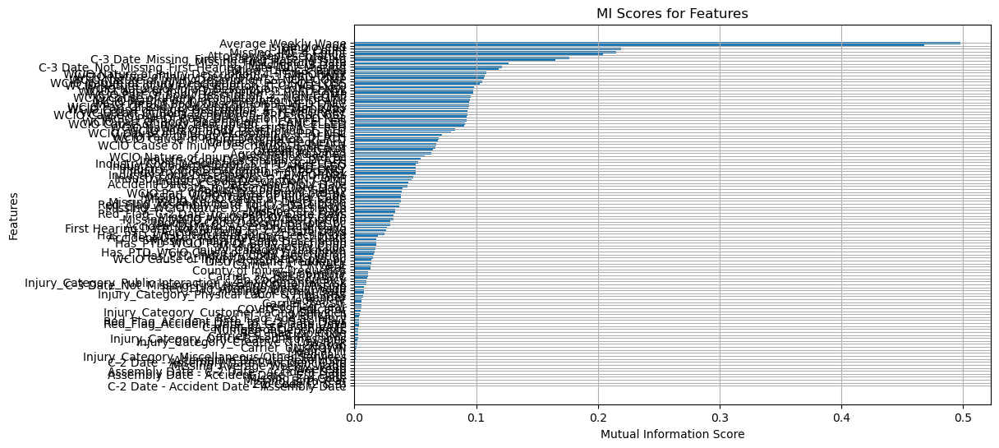

Testing 1 features with RFE...
Testing 4 features with RFE...
Testing 7 features with RFE...
Testing 10 features with RFE...
Testing 13 features with RFE...
Testing 16 features with RFE...
Testing 19 features with RFE...
Testing 22 features with RFE...
Testing 25 features with RFE...
Testing 28 features with RFE...
Testing 31 features with RFE...
Testing 34 features with RFE...
Testing 37 features with RFE...
Testing 40 features with RFE...
Testing 43 features with RFE...
Testing 46 features with RFE...
Testing 49 features with RFE...
Testing 52 features with RFE...
Testing 55 features with RFE...
Testing 58 features with RFE...
Testing 61 features with RFE...
Testing 64 features with RFE...
Optimum number of features: 43
Best F1 Macro Score: 0.4467
Number of iterations performed: [78]
Features selected by Lasso (Threshold > 0.01): 52
['Agreement Reached', 'is_employeed', 'IME-4 Count', 'Average Weekly Wage', 'Missing_IME-4 Count', 'Attorney/Representative', 'WCIO Part Of Body Descript

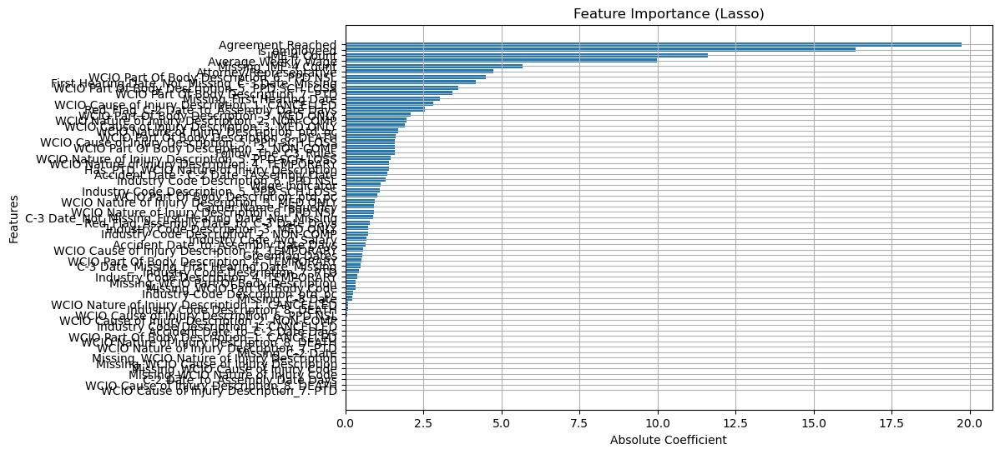

[I 2024-12-21 17:44:58,619] A new study created in memory with name: no-name-fec1a0d5-fdff-4965-b4ae-6c2723fbc4ad


Otimização para log...


[I 2024-12-21 17:45:01,341] Trial 0 finished with value: 0.20355597944641146 and parameters: {'C': 0.000296924479483637, 'penalty': 'l2', 'solver': 'saga', 'max_iter': 927, 'multi_class': 'multinomial'}. Best is trial 0 with value: 0.20355597944641146.
[I 2024-12-21 17:45:06,264] Trial 1 finished with value: 0.21378252907800824 and parameters: {'C': 0.0006760636925374459, 'penalty': 'l2', 'solver': 'sag', 'max_iter': 397, 'multi_class': 'ovr'}. Best is trial 1 with value: 0.21378252907800824.
[I 2024-12-21 17:45:09,024] Trial 2 finished with value: 0.3286776723452199 and parameters: {'C': 0.022077996457053304, 'penalty': 'l2', 'solver': 'saga', 'max_iter': 957, 'multi_class': 'multinomial'}. Best is trial 2 with value: 0.3286776723452199.
[I 2024-12-21 17:46:19,593] Trial 3 finished with value: 0.3636080720732488 and parameters: {'C': 2.2155562336635586, 'penalty': 'l2', 'solver': 'saga', 'max_iter': 712, 'multi_class': 'ovr'}. Best is trial 3 with value: 0.3636080720732488.
[I 2024-12

Otimização para mlp...


[I 2024-12-21 17:58:20,066] Trial 0 finished with value: 0.08411647413251262 and parameters: {'hidden_layer_sizes': (50,), 'activation': 'logistic', 'solver': 'sgd', 'alpha': 0.0029474756514539756, 'learning_rate': 'invscaling', 'learning_rate_init': 2.182896340174453e-05, 'max_iter': 907}. Best is trial 0 with value: 0.08411647413251262.
[I 2024-12-21 17:59:45,013] Trial 1 finished with value: 0.33455508493408875 and parameters: {'hidden_layer_sizes': (100, 100), 'activation': 'relu', 'solver': 'adam', 'alpha': 0.8176386653718112, 'learning_rate': 'invscaling', 'learning_rate_init': 0.00018373566298740315, 'max_iter': 521}. Best is trial 1 with value: 0.33455508493408875.
[I 2024-12-21 18:03:05,786] Trial 2 finished with value: 0.4077956295536175 and parameters: {'hidden_layer_sizes': (200,), 'activation': 'tanh', 'solver': 'adam', 'alpha': 1.0020732610288404e-05, 'learning_rate': 'constant', 'learning_rate_init': 7.809029747626687e-05, 'max_iter': 392}. Best is trial 2 with value: 0.

Otimização para rf...


[I 2024-12-21 19:03:05,225] Trial 0 finished with value: 0.33779421901665985 and parameters: {'n_estimators': 226, 'max_depth': 7, 'min_samples_split': 9, 'min_samples_leaf': 8, 'max_features': 'sqrt', 'bootstrap': True}. Best is trial 0 with value: 0.33779421901665985.
[I 2024-12-21 19:03:34,638] Trial 1 finished with value: 0.349528012273396 and parameters: {'n_estimators': 274, 'max_depth': 9, 'min_samples_split': 6, 'min_samples_leaf': 8, 'max_features': 'log2', 'bootstrap': True}. Best is trial 1 with value: 0.349528012273396.
[I 2024-12-21 19:03:50,796] Trial 2 finished with value: 0.2978354877433318 and parameters: {'n_estimators': 227, 'max_depth': 5, 'min_samples_split': 16, 'min_samples_leaf': 8, 'max_features': 'log2', 'bootstrap': True}. Best is trial 1 with value: 0.349528012273396.
[I 2024-12-21 19:04:04,455] Trial 3 finished with value: 0.32341945668160743 and parameters: {'n_estimators': 136, 'max_depth': 6, 'min_samples_split': 18, 'min_samples_leaf': 6, 'max_features'

Otimização para lgbm...
[LightGBM] [Warning] lambda_l1 is set=1.0582851752132656e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0582851752132656e-05
[LightGBM] [Warning] lambda_l2 is set=0.004772250656780651, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.004772250656780651
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=1.0582851752132656e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0582851752132656e-05
[LightGBM] [Warning] lambda_l2 is set=0.004772250656780651, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.004772250656780651
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.004721 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1890
[LightGBM] [Info] Number of data points in the train set: 76536, number of use

[I 2024-12-21 19:08:58,066] Trial 0 finished with value: 0.4250381400688793 and parameters: {'max_depth': 8, 'learning_rate': 0.018291004542405787, 'n_estimators': 108, 'num_leaves': 177, 'min_child_samples': 88, 'subsample': 0.8920703697215022, 'colsample_bytree': 0.9581293538447286, 'lambda_l1': 1.0582851752132656e-05, 'lambda_l2': 0.004772250656780651, 'scale_pos_weight': 1.4487638718278546}. Best is trial 0 with value: 0.4250381400688793.


[LightGBM] [Warning] lambda_l1 is set=5.6275566893436896e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.6275566893436896e-05
[LightGBM] [Warning] lambda_l2 is set=2.5824843481213355e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5824843481213355e-08
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=5.6275566893436896e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.6275566893436896e-05
[LightGBM] [Warning] lambda_l2 is set=2.5824843481213355e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5824843481213355e-08
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.009377 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1890
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 39
[LightGBM] [Info] Start training from score -3.829138
[LightGBM] 

[I 2024-12-21 19:09:00,923] Trial 1 finished with value: 0.4011161806974941 and parameters: {'max_depth': 3, 'learning_rate': 0.2736381818162754, 'n_estimators': 72, 'num_leaves': 178, 'min_child_samples': 95, 'subsample': 0.6769033023412364, 'colsample_bytree': 0.9013213913577648, 'lambda_l1': 5.6275566893436896e-05, 'lambda_l2': 2.5824843481213355e-08, 'scale_pos_weight': 5.972810689703214}. Best is trial 0 with value: 0.4250381400688793.


[LightGBM] [Warning] lambda_l1 is set=7.609627683194806e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.609627683194806e-06
[LightGBM] [Warning] lambda_l2 is set=0.0010986823547298444, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0010986823547298444
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=7.609627683194806e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.609627683194806e-06
[LightGBM] [Warning] lambda_l2 is set=0.0010986823547298444, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0010986823547298444
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.009093 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1890
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 39
[LightGBM] [Info] Start training from score -3.829138
[LightGBM] [Info] S

[I 2024-12-21 19:09:09,222] Trial 2 finished with value: 0.43735968810664744 and parameters: {'max_depth': 9, 'learning_rate': 0.039534048599721, 'n_estimators': 99, 'num_leaves': 162, 'min_child_samples': 61, 'subsample': 0.7206633952934196, 'colsample_bytree': 0.695674665649038, 'lambda_l1': 7.609627683194806e-06, 'lambda_l2': 0.0010986823547298444, 'scale_pos_weight': 6.785130676947207}. Best is trial 2 with value: 0.43735968810664744.


[LightGBM] [Warning] lambda_l1 is set=0.29668100692491434, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.29668100692491434
[LightGBM] [Warning] lambda_l2 is set=3.363734408893405e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.363734408893405e-07
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=0.29668100692491434, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.29668100692491434
[LightGBM] [Warning] lambda_l2 is set=3.363734408893405e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.363734408893405e-07
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.008323 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1890
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 39
[LightGBM] [Info] Start training from score -3.829138
[LightGBM] [Info] Start tra

[I 2024-12-21 19:09:15,959] Trial 3 finished with value: 0.4169917371602723 and parameters: {'max_depth': 4, 'learning_rate': 0.017401697263684762, 'n_estimators': 163, 'num_leaves': 120, 'min_child_samples': 18, 'subsample': 0.6998196703937265, 'colsample_bytree': 0.7740485969588977, 'lambda_l1': 0.29668100692491434, 'lambda_l2': 3.363734408893405e-07, 'scale_pos_weight': 6.195033881048769}. Best is trial 2 with value: 0.43735968810664744.


[LightGBM] [Warning] lambda_l1 is set=0.03596924743722105, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.03596924743722105
[LightGBM] [Warning] lambda_l2 is set=0.0005804211416999061, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005804211416999061
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=0.03596924743722105, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.03596924743722105
[LightGBM] [Warning] lambda_l2 is set=0.0005804211416999061, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0005804211416999061
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.008639 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1890
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 39
[LightGBM] [Info] Start training from score -3.829138
[LightGBM] [Info] Start tra

[I 2024-12-21 19:09:27,160] Trial 4 finished with value: 0.33421172570129176 and parameters: {'max_depth': 7, 'learning_rate': 0.25547939166504546, 'n_estimators': 181, 'num_leaves': 95, 'min_child_samples': 12, 'subsample': 0.5205223746353828, 'colsample_bytree': 0.9294376241168096, 'lambda_l1': 0.03596924743722105, 'lambda_l2': 0.0005804211416999061, 'scale_pos_weight': 8.422288572950947}. Best is trial 2 with value: 0.43735968810664744.


[LightGBM] [Warning] lambda_l1 is set=1.7232407338210224e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7232407338210224e-05
[LightGBM] [Warning] lambda_l2 is set=0.001330677445850685, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.001330677445850685
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=1.7232407338210224e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.7232407338210224e-05
[LightGBM] [Warning] lambda_l2 is set=0.001330677445850685, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.001330677445850685
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.008665 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1890
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 39
[LightGBM] [Info] Start training from score -3.829138
[LightGBM] [Info] S

[I 2024-12-21 19:09:37,232] Trial 5 finished with value: 0.4221414860943671 and parameters: {'max_depth': 8, 'learning_rate': 0.01204213733639782, 'n_estimators': 131, 'num_leaves': 169, 'min_child_samples': 36, 'subsample': 0.820337668662767, 'colsample_bytree': 0.7123958704276143, 'lambda_l1': 1.7232407338210224e-05, 'lambda_l2': 0.001330677445850685, 'scale_pos_weight': 7.55517480936018}. Best is trial 2 with value: 0.43735968810664744.


[LightGBM] [Warning] lambda_l1 is set=9.386974403594647e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.386974403594647e-05
[LightGBM] [Warning] lambda_l2 is set=1.2120171001952509e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2120171001952509e-08
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=9.386974403594647e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.386974403594647e-05
[LightGBM] [Warning] lambda_l2 is set=1.2120171001952509e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.2120171001952509e-08
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.008675 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1890
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 39
[LightGBM] [Info] Start training from score -3.829138
[LightGBM] [Inf

[I 2024-12-21 19:09:43,008] Trial 6 finished with value: 0.40963801636098973 and parameters: {'max_depth': 8, 'learning_rate': 0.01726045770538533, 'n_estimators': 77, 'num_leaves': 143, 'min_child_samples': 88, 'subsample': 0.9009762847143591, 'colsample_bytree': 0.895287745784632, 'lambda_l1': 9.386974403594647e-05, 'lambda_l2': 1.2120171001952509e-08, 'scale_pos_weight': 6.5286127547815935}. Best is trial 2 with value: 0.43735968810664744.


[LightGBM] [Warning] lambda_l1 is set=3.737774133584584e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.737774133584584e-06
[LightGBM] [Warning] lambda_l2 is set=5.557863664523256e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.557863664523256e-07
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=3.737774133584584e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.737774133584584e-06
[LightGBM] [Warning] lambda_l2 is set=5.557863664523256e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.557863664523256e-07
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.009106 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1890
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 39
[LightGBM] [Info] Start training from score -3.829138
[LightGBM] [Info] S

[I 2024-12-21 19:09:55,717] Trial 7 finished with value: 0.43754531580056044 and parameters: {'max_depth': 8, 'learning_rate': 0.05526785454276079, 'n_estimators': 152, 'num_leaves': 235, 'min_child_samples': 34, 'subsample': 0.6628242270005342, 'colsample_bytree': 0.7500210193972758, 'lambda_l1': 3.737774133584584e-06, 'lambda_l2': 5.557863664523256e-07, 'scale_pos_weight': 2.939188845789264}. Best is trial 7 with value: 0.43754531580056044.


[LightGBM] [Warning] lambda_l1 is set=2.230861160741106e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.230861160741106e-08
[LightGBM] [Warning] lambda_l2 is set=0.0010380001493211267, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0010380001493211267
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=2.230861160741106e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=2.230861160741106e-08
[LightGBM] [Warning] lambda_l2 is set=0.0010380001493211267, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0010380001493211267
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.008877 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1890
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 39
[LightGBM] [Info] Start training from score -3.829138
[LightGBM] [Info] S

[I 2024-12-21 19:09:59,660] Trial 8 finished with value: 0.39352883693928875 and parameters: {'max_depth': 4, 'learning_rate': 0.19999211273155343, 'n_estimators': 82, 'num_leaves': 163, 'min_child_samples': 86, 'subsample': 0.5136520003684839, 'colsample_bytree': 0.5834520251047837, 'lambda_l1': 2.230861160741106e-08, 'lambda_l2': 0.0010380001493211267, 'scale_pos_weight': 9.499278377860287}. Best is trial 7 with value: 0.43754531580056044.


[LightGBM] [Warning] lambda_l1 is set=0.028587935524694744, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.028587935524694744
[LightGBM] [Warning] lambda_l2 is set=0.10686095766879632, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.10686095766879632
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=0.028587935524694744, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.028587935524694744
[LightGBM] [Warning] lambda_l2 is set=0.10686095766879632, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.10686095766879632
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.009025 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1890
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 39
[LightGBM] [Info] Start training from score -3.829138
[LightGBM] [Info] Start trainin

[I 2024-12-21 19:10:06,129] Trial 9 finished with value: 0.42806706246633464 and parameters: {'max_depth': 5, 'learning_rate': 0.030248408791396404, 'n_estimators': 121, 'num_leaves': 74, 'min_child_samples': 57, 'subsample': 0.6879285924777931, 'colsample_bytree': 0.9504997712617003, 'lambda_l1': 0.028587935524694744, 'lambda_l2': 0.10686095766879632, 'scale_pos_weight': 6.949638377941797}. Best is trial 7 with value: 0.43754531580056044.


[LightGBM] [Warning] lambda_l1 is set=8.941953202720712e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.941953202720712e-08
[LightGBM] [Warning] lambda_l2 is set=4.752229435212865e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.752229435212865e-06
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=8.941953202720712e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.941953202720712e-08
[LightGBM] [Warning] lambda_l2 is set=4.752229435212865e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.752229435212865e-06
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.008058 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1890
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 39
[LightGBM] [Info] Start training from score -3.829138
[LightGBM] [Info] S

[I 2024-12-21 19:10:44,008] Trial 10 finished with value: 0.38694748947600444 and parameters: {'max_depth': 10, 'learning_rate': 0.09679614927892077, 'n_estimators': 262, 'num_leaves': 242, 'min_child_samples': 41, 'subsample': 0.5921793491591398, 'colsample_bytree': 0.521163556172295, 'lambda_l1': 8.941953202720712e-08, 'lambda_l2': 4.752229435212865e-06, 'scale_pos_weight': 3.139647424209007}. Best is trial 7 with value: 0.43754531580056044.


[LightGBM] [Warning] lambda_l1 is set=8.029170588862155e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.029170588862155e-07
[LightGBM] [Warning] lambda_l2 is set=1.5315901086416388e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5315901086416388e-05
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=8.029170588862155e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=8.029170588862155e-07
[LightGBM] [Warning] lambda_l2 is set=1.5315901086416388e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.5315901086416388e-05
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.008734 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1890
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 39
[LightGBM] [Info] Start training from score -3.829138
[LightGBM] [Inf

[I 2024-12-21 19:11:05,583] Trial 11 finished with value: 0.4360094117358176 and parameters: {'max_depth': 10, 'learning_rate': 0.05998358826193976, 'n_estimators': 214, 'num_leaves': 252, 'min_child_samples': 64, 'subsample': 0.7845000083346566, 'colsample_bytree': 0.7167048770432476, 'lambda_l1': 8.029170588862155e-07, 'lambda_l2': 1.5315901086416388e-05, 'scale_pos_weight': 3.9642026217720403}. Best is trial 7 with value: 0.43754531580056044.


[LightGBM] [Warning] lambda_l1 is set=0.0012728399502632002, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0012728399502632002
[LightGBM] [Warning] lambda_l2 is set=0.2745447422368058, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2745447422368058
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=0.0012728399502632002, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0012728399502632002
[LightGBM] [Warning] lambda_l2 is set=0.2745447422368058, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2745447422368058
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.008341 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1890
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 39
[LightGBM] [Info] Start training from score -3.829138
[LightGBM] [Info] Start trainin

[I 2024-12-21 19:11:14,342] Trial 12 finished with value: 0.43926709134041414 and parameters: {'max_depth': 9, 'learning_rate': 0.047538193183007255, 'n_estimators': 160, 'num_leaves': 32, 'min_child_samples': 39, 'subsample': 0.622419653986663, 'colsample_bytree': 0.795831980200485, 'lambda_l1': 0.0012728399502632002, 'lambda_l2': 0.2745447422368058, 'scale_pos_weight': 4.582416707912191}. Best is trial 12 with value: 0.43926709134041414.


[LightGBM] [Warning] lambda_l1 is set=0.001579834047057804, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.001579834047057804
[LightGBM] [Warning] lambda_l2 is set=0.6632047781455602, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6632047781455602
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=0.001579834047057804, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.001579834047057804
[LightGBM] [Warning] lambda_l2 is set=0.6632047781455602, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.6632047781455602
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.008333 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1890
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 39
[LightGBM] [Info] Start training from score -3.829138
[LightGBM] [Info] Start training fr

[I 2024-12-21 19:11:25,361] Trial 13 finished with value: 0.43702724147703953 and parameters: {'max_depth': 6, 'learning_rate': 0.07619638639515211, 'n_estimators': 192, 'num_leaves': 39, 'min_child_samples': 33, 'subsample': 0.6092020666049648, 'colsample_bytree': 0.801203225738291, 'lambda_l1': 0.001579834047057804, 'lambda_l2': 0.6632047781455602, 'scale_pos_weight': 4.208225374560704}. Best is trial 12 with value: 0.43926709134041414.


[LightGBM] [Warning] lambda_l1 is set=0.0016039287751479685, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0016039287751479685
[LightGBM] [Warning] lambda_l2 is set=9.596211940989069e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.596211940989069e-07
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=0.0016039287751479685, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0016039287751479685
[LightGBM] [Warning] lambda_l2 is set=9.596211940989069e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.596211940989069e-07
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.008667 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1890
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 39
[LightGBM] [Info] Start training from score -3.829138
[LightGBM] [Info] S

[I 2024-12-21 19:11:49,179] Trial 14 finished with value: 0.3891807792975106 and parameters: {'max_depth': 9, 'learning_rate': 0.131765019602576, 'n_estimators': 231, 'num_leaves': 225, 'min_child_samples': 43, 'subsample': 0.9928131476759592, 'colsample_bytree': 0.8355619696453055, 'lambda_l1': 0.0016039287751479685, 'lambda_l2': 9.596211940989069e-07, 'scale_pos_weight': 1.9075646215922901}. Best is trial 12 with value: 0.43926709134041414.


[LightGBM] [Warning] lambda_l1 is set=0.0007947534402502323, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0007947534402502323
[LightGBM] [Warning] lambda_l2 is set=0.042143949502446154, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.042143949502446154
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=0.0007947534402502323, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0007947534402502323
[LightGBM] [Warning] lambda_l2 is set=0.042143949502446154, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.042143949502446154
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.009003 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1890
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 39
[LightGBM] [Info] Start training from score -3.829138
[LightGBM] [Info] Start

[I 2024-12-21 19:11:59,395] Trial 15 finished with value: 0.4314909743647244 and parameters: {'max_depth': 7, 'learning_rate': 0.037731610940022, 'n_estimators': 154, 'num_leaves': 209, 'min_child_samples': 23, 'subsample': 0.615537115858205, 'colsample_bytree': 0.6423513556657925, 'lambda_l1': 0.0007947534402502323, 'lambda_l2': 0.042143949502446154, 'scale_pos_weight': 4.505767987311321}. Best is trial 12 with value: 0.43926709134041414.


[LightGBM] [Warning] lambda_l1 is set=7.717534700211726e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.717534700211726e-07
[LightGBM] [Warning] lambda_l2 is set=4.017238581204738e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.017238581204738e-05
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=7.717534700211726e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.717534700211726e-07
[LightGBM] [Warning] lambda_l2 is set=4.017238581204738e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.017238581204738e-05
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.008661 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1890
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 39
[LightGBM] [Info] Start training from score -3.829138
[LightGBM] [Info] S

[I 2024-12-21 19:12:19,052] Trial 16 finished with value: 0.4339497371174677 and parameters: {'max_depth': 9, 'learning_rate': 0.053968655591997726, 'n_estimators': 279, 'num_leaves': 59, 'min_child_samples': 49, 'subsample': 0.5814995670905388, 'colsample_bytree': 0.8427671346793, 'lambda_l1': 7.717534700211726e-07, 'lambda_l2': 4.017238581204738e-05, 'scale_pos_weight': 2.8828580987553734}. Best is trial 12 with value: 0.43926709134041414.


[LightGBM] [Warning] lambda_l1 is set=5.948733318984002e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.948733318984002e-07
[LightGBM] [Warning] lambda_l2 is set=1.3610875751780425e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3610875751780425e-07
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=5.948733318984002e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.948733318984002e-07
[LightGBM] [Warning] lambda_l2 is set=1.3610875751780425e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.3610875751780425e-07
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.008699 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1890
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 39
[LightGBM] [Info] Start training from score -3.829138
[LightGBM] [Inf

[I 2024-12-21 19:12:29,136] Trial 17 finished with value: 0.3945226382346053 and parameters: {'max_depth': 6, 'learning_rate': 0.12362189744104729, 'n_estimators': 153, 'num_leaves': 115, 'min_child_samples': 71, 'subsample': 0.6580362326723883, 'colsample_bytree': 0.6530091576132402, 'lambda_l1': 5.948733318984002e-07, 'lambda_l2': 1.3610875751780425e-07, 'scale_pos_weight': 5.0211459860137255}. Best is trial 12 with value: 0.43926709134041414.


[LightGBM] [Warning] lambda_l1 is set=0.00041469672032327996, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00041469672032327996
[LightGBM] [Warning] lambda_l2 is set=2.546497349282785e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.546497349282785e-06
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=0.00041469672032327996, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00041469672032327996
[LightGBM] [Warning] lambda_l2 is set=2.546497349282785e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.546497349282785e-06
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.008245 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1890
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 39
[LightGBM] [Info] Start training from score -3.829138
[LightGBM] [Inf

[I 2024-12-21 19:12:50,525] Trial 18 finished with value: 0.4463213187989477 and parameters: {'max_depth': 10, 'learning_rate': 0.025491425288532512, 'n_estimators': 212, 'num_leaves': 205, 'min_child_samples': 29, 'subsample': 0.7614216359090876, 'colsample_bytree': 0.7681445417959237, 'lambda_l1': 0.00041469672032327996, 'lambda_l2': 2.546497349282785e-06, 'scale_pos_weight': 2.7569501333708972}. Best is trial 18 with value: 0.4463213187989477.


[LightGBM] [Warning] lambda_l1 is set=0.017976515110699136, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.017976515110699136
[LightGBM] [Warning] lambda_l2 is set=0.00011629567113374809, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00011629567113374809
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=0.017976515110699136, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.017976515110699136
[LightGBM] [Warning] lambda_l2 is set=0.00011629567113374809, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00011629567113374809
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.008877 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1890
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 39
[LightGBM] [Info] Start training from score -3.829138
[LightGBM] [Info] S

[I 2024-12-21 19:13:14,650] Trial 19 finished with value: 0.43862196903591844 and parameters: {'max_depth': 10, 'learning_rate': 0.026345038481427187, 'n_estimators': 235, 'num_leaves': 207, 'min_child_samples': 25, 'subsample': 0.7688792011595428, 'colsample_bytree': 0.8102135995519193, 'lambda_l1': 0.017976515110699136, 'lambda_l2': 0.00011629567113374809, 'scale_pos_weight': 2.1241662954813894}. Best is trial 18 with value: 0.4463213187989477.


[LightGBM] [Warning] lambda_l1 is set=0.0005908101983603869, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0005908101983603869
[LightGBM] [Warning] lambda_l2 is set=4.532719814298619e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.532719814298619e-06
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=0.0005908101983603869, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0005908101983603869
[LightGBM] [Warning] lambda_l2 is set=4.532719814298619e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.532719814298619e-06
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.009117 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1890
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 39
[LightGBM] [Info] Start training from score -3.829138
[LightGBM] [Info] S

[I 2024-12-21 19:13:25,566] Trial 20 finished with value: 0.42773040783820926 and parameters: {'max_depth': 9, 'learning_rate': 0.011878874271410982, 'n_estimators': 201, 'num_leaves': 34, 'min_child_samples': 50, 'subsample': 0.8544208503071814, 'colsample_bytree': 0.8729320627124619, 'lambda_l1': 0.0005908101983603869, 'lambda_l2': 4.532719814298619e-06, 'scale_pos_weight': 5.351630040583296}. Best is trial 18 with value: 0.4463213187989477.


[LightGBM] [Warning] lambda_l1 is set=0.021328607046867606, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.021328607046867606
[LightGBM] [Warning] lambda_l2 is set=0.00012034703489489134, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00012034703489489134
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=0.021328607046867606, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.021328607046867606
[LightGBM] [Warning] lambda_l2 is set=0.00012034703489489134, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00012034703489489134
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.007844 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1890
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 39
[LightGBM] [Info] Start training from score -3.829138
[LightGBM] [Info] S

[I 2024-12-21 19:13:48,723] Trial 21 finished with value: 0.44589324071525127 and parameters: {'max_depth': 10, 'learning_rate': 0.027028315175831475, 'n_estimators': 231, 'num_leaves': 197, 'min_child_samples': 25, 'subsample': 0.7546846492596282, 'colsample_bytree': 0.8048188696426336, 'lambda_l1': 0.021328607046867606, 'lambda_l2': 0.00012034703489489134, 'scale_pos_weight': 2.1269393427303647}. Best is trial 18 with value: 0.4463213187989477.


[LightGBM] [Warning] lambda_l1 is set=0.007029529897189692, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.007029529897189692
[LightGBM] [Warning] lambda_l2 is set=0.00013765567180210885, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00013765567180210885
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=0.007029529897189692, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.007029529897189692
[LightGBM] [Warning] lambda_l2 is set=0.00013765567180210885, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00013765567180210885
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.008827 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1890
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 39
[LightGBM] [Info] Start training from score -3.829138
[LightGBM] [Info] S

[I 2024-12-21 19:14:16,398] Trial 22 finished with value: 0.44171264952794914 and parameters: {'max_depth': 10, 'learning_rate': 0.02374255613067762, 'n_estimators': 244, 'num_leaves': 201, 'min_child_samples': 24, 'subsample': 0.7442221955823225, 'colsample_bytree': 0.769111878692537, 'lambda_l1': 0.007029529897189692, 'lambda_l2': 0.00013765567180210885, 'scale_pos_weight': 1.1385065014603217}. Best is trial 18 with value: 0.4463213187989477.


[LightGBM] [Warning] lambda_l1 is set=0.3564658442762986, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3564658442762986
[LightGBM] [Warning] lambda_l2 is set=0.00016022488988889474, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00016022488988889474
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=0.3564658442762986, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.3564658442762986
[LightGBM] [Warning] lambda_l2 is set=0.00016022488988889474, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00016022488988889474
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.008920 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1890
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 39
[LightGBM] [Info] Start training from score -3.829138
[LightGBM] [Info] Start tra

[I 2024-12-21 19:14:42,714] Trial 23 finished with value: 0.4301760396126439 and parameters: {'max_depth': 10, 'learning_rate': 0.02500793827550965, 'n_estimators': 250, 'num_leaves': 199, 'min_child_samples': 10, 'subsample': 0.7456332884518928, 'colsample_bytree': 0.7518139929444184, 'lambda_l1': 0.3564658442762986, 'lambda_l2': 0.00016022488988889474, 'scale_pos_weight': 1.0567750294722063}. Best is trial 18 with value: 0.4463213187989477.


[LightGBM] [Warning] lambda_l1 is set=0.007548914210176351, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.007548914210176351
[LightGBM] [Warning] lambda_l2 is set=0.014176557953134364, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.014176557953134364
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=0.007548914210176351, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.007548914210176351
[LightGBM] [Warning] lambda_l2 is set=0.014176557953134364, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.014176557953134364
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.009079 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1890
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 39
[LightGBM] [Info] Start training from score -3.829138
[LightGBM] [Info] Start tra

[I 2024-12-21 19:15:15,500] Trial 24 finished with value: 0.43700111188899965 and parameters: {'max_depth': 10, 'learning_rate': 0.021704451979514598, 'n_estimators': 296, 'num_leaves': 190, 'min_child_samples': 25, 'subsample': 0.79168538007219, 'colsample_bytree': 0.6527559935857776, 'lambda_l1': 0.007548914210176351, 'lambda_l2': 0.014176557953134364, 'scale_pos_weight': 2.280127075926268}. Best is trial 18 with value: 0.4463213187989477.
[I 2024-12-21 19:15:15,501] A new study created in memory with name: no-name-8bf454d1-4ce3-4cfb-bc37-2f07a233d77c


Otimização para xgb...


[I 2024-12-21 19:15:19,536] Trial 0 finished with value: 0.40877441976481005 and parameters: {'max_depth': 7, 'learning_rate': 0.05473524506729626, 'n_estimators': 70, 'min_child_weight': 8, 'gamma': 0.4328903290039948, 'subsample': 0.8192709831734724, 'colsample_bytree': 0.5337600028615349, 'reg_alpha': 0.0003946887527574683, 'reg_lambda': 0.048989558765861}. Best is trial 0 with value: 0.40877441976481005.
[I 2024-12-21 19:15:30,622] Trial 1 finished with value: 0.4217544912509351 and parameters: {'max_depth': 9, 'learning_rate': 0.01466331367301681, 'n_estimators': 180, 'min_child_weight': 4, 'gamma': 0.8174289040511642, 'subsample': 0.920975368606197, 'colsample_bytree': 0.7095305254815205, 'reg_alpha': 0.03856734933096055, 'reg_lambda': 9.648449104313214e-07}. Best is trial 1 with value: 0.4217544912509351.
[I 2024-12-21 19:15:46,233] Trial 2 finished with value: 0.4467163959338095 and parameters: {'max_depth': 7, 'learning_rate': 0.10017917750557992, 'n_estimators': 290, 'min_chi

Training model: Logistic Regression
Logistic Regression - Accuracy: 0.7808, F1 Macro: 0.3889, F1 Weighted: 0.7303, Precision: 0.7436, Recall: 0.7808
Training model: Random Forest
Random Forest - Accuracy: 0.7914, F1 Macro: 0.3605, F1 Weighted: 0.7393, Precision: 0.7781, Recall: 0.7914
Training model: XGBoost
XGBoost - Accuracy: 0.8018, F1 Macro: 0.4622, F1 Weighted: 0.7623, Precision: 0.7729, Recall: 0.8018
Training model: LightGBM
[LightGBM] [Warning] lambda_l1 is set=0.00041469672032327996, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00041469672032327996
[LightGBM] [Warning] lambda_l2 is set=2.546497349282785e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.546497349282785e-06
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=0.00041469672032327996, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00041469672032327996
[LightGBM] [Warning] lambda_l2 is set=2.546497349282785e-06, r

[I 2024-12-21 19:50:13,810] A new study created in memory with name: no-name-b6c1c441-caff-47b6-822a-147da7db5be7
[I 2024-12-21 19:50:13,931] Trial 0 finished with value: 0.42377438554408636 and parameters: {'weight_rf': 8, 'weight_xgb': 9, 'weight_lgbm': 2, 'weight_log_reg': 9, 'weight_mlp': 0}. Best is trial 0 with value: 0.42377438554408636.
[I 2024-12-21 19:50:14,043] Trial 1 finished with value: 0.4227169342605239 and parameters: {'weight_rf': 9, 'weight_xgb': 1, 'weight_lgbm': 6, 'weight_log_reg': 2, 'weight_mlp': 10}. Best is trial 0 with value: 0.42377438554408636.
[I 2024-12-21 19:50:14,164] Trial 2 finished with value: 0.41805241096628554 and parameters: {'weight_rf': 3, 'weight_xgb': 1, 'weight_lgbm': 4, 'weight_log_reg': 10, 'weight_mlp': 10}. Best is trial 0 with value: 0.42377438554408636.
[I 2024-12-21 19:50:14,276] Trial 3 finished with value: 0.45044667317270504 and parameters: {'weight_rf': 0, 'weight_xgb': 9, 'weight_lgbm': 5, 'weight_log_reg': 2, 'weight_mlp': 1}. B

Best Weights Found: {'weight_rf': 0, 'weight_xgb': 7, 'weight_lgbm': 2, 'weight_log_reg': 0, 'weight_mlp': 0}
Validation F1 Macro: 0.4655
Validation Accuracy: 0.8023
[LightGBM] [Warning] lambda_l1 is set=0.00041469672032327996, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00041469672032327996
[LightGBM] [Warning] lambda_l2 is set=2.546497349282785e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.546497349282785e-06


[I 2024-12-21 19:52:13,348] A new study created in memory with name: no-name-b43338ef-baa0-4d41-a061-17d53b13b43c


Original class distribution: Counter({1: 194052, 3: 99004, 2: 45938, 4: 32186, 0: 8318, 5: 2808, 7: 313, 6: 65})


[I 2024-12-21 19:53:20,356] Trial 0 finished with value: 0.4823522686765326 and parameters: {'smote_increase_class_0': 7010, 'smote_increase_class_2': 67951, 'smote_increase_class_5': 1031, 'smote_increase_class_6': 35, 'smote_increase_class_7': 1481, 'undersample_factor_class_3': 0.5855135995266788, 'undersample_factor_class_1': 0.5990038408703993}. Best is trial 0 with value: 0.4823522686765326.
[I 2024-12-21 19:54:23,169] Trial 1 finished with value: 0.48614303201984577 and parameters: {'smote_increase_class_0': 12568, 'smote_increase_class_2': 32577, 'smote_increase_class_5': 8719, 'smote_increase_class_6': 392, 'smote_increase_class_7': 627, 'undersample_factor_class_3': 0.6372881795221272, 'undersample_factor_class_1': 0.48032572390421113}. Best is trial 1 with value: 0.48614303201984577.
[I 2024-12-21 19:55:32,549] Trial 2 finished with value: 0.49313231811580965 and parameters: {'smote_increase_class_0': 8589, 'smote_increase_class_2': 86946, 'smote_increase_class_5': 9318, 'sm

Best parameters: {'smote_increase_class_0': 175, 'smote_increase_class_2': 44098, 'smote_increase_class_5': 100, 'smote_increase_class_6': 258, 'smote_increase_class_7': 1274, 'undersample_factor_class_3': 0.3300856113321697, 'undersample_factor_class_1': 0.4637194206807906}
Final class distribution: Counter({2: 90036, 1: 89985, 3: 32679, 4: 32186, 0: 8493, 5: 2908, 7: 1587, 6: 323})
Training model: Logistic Regression
Logistic Regression - Accuracy: 0.6663, F1 Macro: 0.4016, F1 Weighted: 0.6809, Precision: 0.7582, Recall: 0.6663
Training model: Random Forest
Random Forest - Accuracy: 0.7370, F1 Macro: 0.4441, F1 Weighted: 0.7343, Precision: 0.7505, Recall: 0.7370
Training model: XGBoost
XGBoost - Accuracy: 0.7675, F1 Macro: 0.4973, F1 Weighted: 0.7589, Precision: 0.7632, Recall: 0.7675
Training model: LightGBM
[LightGBM] [Warning] lambda_l1 is set=0.00041469672032327996, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00041469672032327996
[LightGBM] [Warning] lambda_l2 is se

[I 2024-12-21 20:42:17,089] A new study created in memory with name: no-name-c8558d49-ce7d-4262-b269-eca2b9d0b6f0
[I 2024-12-21 20:42:17,228] Trial 0 finished with value: 0.464058001648128 and parameters: {'weight_rf': 9, 'weight_xgb': 8, 'weight_lgbm': 9, 'weight_log_reg': 5, 'weight_mlp': 8}. Best is trial 0 with value: 0.464058001648128.
[I 2024-12-21 20:42:17,353] Trial 1 finished with value: 0.44952957138822136 and parameters: {'weight_rf': 7, 'weight_xgb': 8, 'weight_lgbm': 0, 'weight_log_reg': 10, 'weight_mlp': 5}. Best is trial 0 with value: 0.464058001648128.
[I 2024-12-21 20:42:17,467] Trial 2 finished with value: 0.4623278934917901 and parameters: {'weight_rf': 6, 'weight_xgb': 10, 'weight_lgbm': 8, 'weight_log_reg': 7, 'weight_mlp': 10}. Best is trial 0 with value: 0.464058001648128.
[I 2024-12-21 20:42:17,585] Trial 3 finished with value: 0.46420060373103783 and parameters: {'weight_rf': 3, 'weight_xgb': 0, 'weight_lgbm': 9, 'weight_log_reg': 3, 'weight_mlp': 6}. Best is t

Best Weights Found: {'weight_rf': 0, 'weight_xgb': 8, 'weight_lgbm': 0, 'weight_log_reg': 0, 'weight_mlp': 0}
Validation F1 Macro: 0.4973
Validation Accuracy: 0.7675
[LightGBM] [Warning] lambda_l1 is set=0.00041469672032327996, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00041469672032327996
[LightGBM] [Warning] lambda_l2 is set=2.546497349282785e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.546497349282785e-06
--- Fold 2 ---
X_train shape: (382684, 29), X_test shape: (191342, 29)
Column 'Accident Date' is a date, converted to datetime format.
Column 'Age at Injury' is numerical, no transformation needed
Column 'Alternative Dispute Resolution': Transformed Y to 1, N to 0
Column 'Assembly Date' is a date, converted to datetime format.
Column 'Attorney/Representative': Transformed Y to 1, N to 0
Column 'Average Weekly Wage' is numerical, no transformation needed
Column 'Birth Year' is numerical, no transformation needed
Column 'C-2 Date' is a date, convert

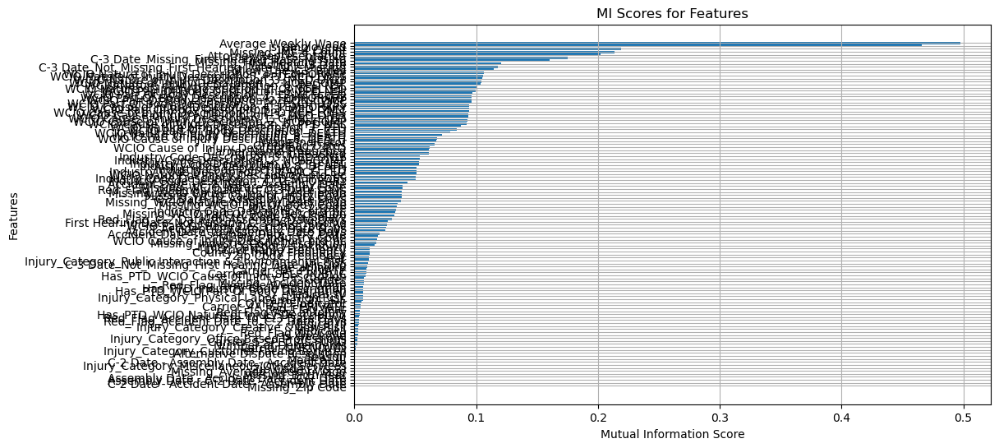

Testing 1 features with RFE...
Testing 4 features with RFE...
Testing 7 features with RFE...
Testing 10 features with RFE...
Testing 13 features with RFE...
Testing 16 features with RFE...
Testing 19 features with RFE...
Testing 22 features with RFE...
Testing 25 features with RFE...
Testing 28 features with RFE...
Testing 31 features with RFE...
Testing 34 features with RFE...
Testing 37 features with RFE...
Testing 40 features with RFE...
Testing 43 features with RFE...
Testing 46 features with RFE...
Testing 49 features with RFE...
Testing 52 features with RFE...
Testing 55 features with RFE...
Testing 58 features with RFE...
Testing 61 features with RFE...
Testing 64 features with RFE...
Optimum number of features: 37
Best F1 Macro Score: 0.4385
Number of iterations performed: [86]
Features selected by Lasso (Threshold > 0.01): 54
['Agreement Reached', 'is_employeed', 'IME-4 Count', 'Average Weekly Wage', 'Missing_IME-4 Count', 'First Hearing Date_Not_Missing_C-3 Date_Missing', 'At

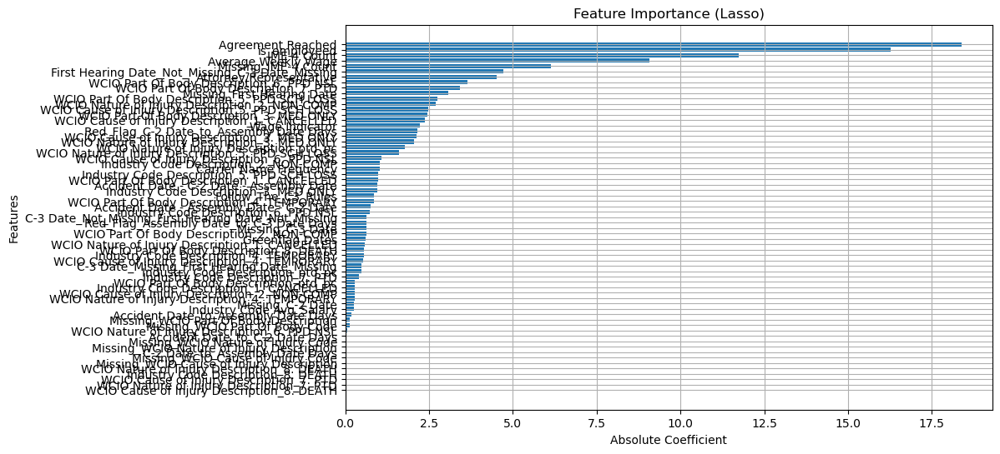

[I 2024-12-21 21:03:55,757] A new study created in memory with name: no-name-17166d7b-8878-4174-bf78-ca5581e8fa5b


Otimização para log...


[I 2024-12-21 21:04:09,220] Trial 0 finished with value: 0.3703435629001258 and parameters: {'C': 0.00010175668057392485, 'penalty': 'none', 'solver': 'lbfgs', 'max_iter': 215, 'multi_class': 'ovr'}. Best is trial 0 with value: 0.3703435629001258.
[I 2024-12-21 21:04:10,680] Trial 1 finished with value: 0.20532526803523693 and parameters: {'C': 0.00032960223320674983, 'penalty': 'l2', 'solver': 'sag', 'max_iter': 935, 'multi_class': 'multinomial'}. Best is trial 0 with value: 0.3703435629001258.
[I 2024-12-21 21:04:40,443] Trial 2 finished with value: 0.335142057290065 and parameters: {'C': 0.4896127593377033, 'penalty': 'l2', 'solver': 'saga', 'max_iter': 781, 'multi_class': 'ovr'}. Best is trial 0 with value: 0.3703435629001258.
[I 2024-12-21 21:08:59,272] Trial 3 finished with value: 0.3670625700102536 and parameters: {'C': 2.0149785542374374, 'penalty': 'none', 'solver': 'saga', 'max_iter': 737, 'multi_class': 'ovr'}. Best is trial 0 with value: 0.3703435629001258.
[I 2024-12-21 21

Otimização para mlp...


[I 2024-12-21 21:18:35,929] Trial 0 finished with value: 0.3392442781410262 and parameters: {'hidden_layer_sizes': (50,), 'activation': 'relu', 'solver': 'adam', 'alpha': 0.18785537614986106, 'learning_rate': 'adaptive', 'learning_rate_init': 6.453864000254952e-05, 'max_iter': 266}. Best is trial 0 with value: 0.3392442781410262.
[I 2024-12-21 21:22:29,165] Trial 1 finished with value: 0.31599870193459256 and parameters: {'hidden_layer_sizes': (200,), 'activation': 'tanh', 'solver': 'sgd', 'alpha': 1.7137620726693318e-05, 'learning_rate': 'adaptive', 'learning_rate_init': 1.98533865328011e-05, 'max_iter': 962}. Best is trial 0 with value: 0.3392442781410262.
[I 2024-12-21 21:24:43,579] Trial 2 finished with value: 0.32871631160762704 and parameters: {'hidden_layer_sizes': (100, 100), 'activation': 'tanh', 'solver': 'sgd', 'alpha': 0.000944379763672283, 'learning_rate': 'adaptive', 'learning_rate_init': 3.583997876466744e-05, 'max_iter': 233}. Best is trial 0 with value: 0.3392442781410

Otimização para rf...


[I 2024-12-21 23:34:49,296] Trial 0 finished with value: 0.32501077327000527 and parameters: {'n_estimators': 194, 'max_depth': 6, 'min_samples_split': 9, 'min_samples_leaf': 15, 'max_features': 'auto', 'bootstrap': False}. Best is trial 0 with value: 0.32501077327000527.
[I 2024-12-21 23:35:15,591] Trial 1 finished with value: 0.351865124333397 and parameters: {'n_estimators': 216, 'max_depth': 9, 'min_samples_split': 20, 'min_samples_leaf': 9, 'max_features': 'log2', 'bootstrap': False}. Best is trial 1 with value: 0.351865124333397.
[I 2024-12-21 23:35:24,516] Trial 2 finished with value: 0.3252686978057119 and parameters: {'n_estimators': 105, 'max_depth': 6, 'min_samples_split': 8, 'min_samples_leaf': 13, 'max_features': 'log2', 'bootstrap': False}. Best is trial 1 with value: 0.351865124333397.
[I 2024-12-21 23:35:29,151] Trial 3 finished with value: 0.3269125555380567 and parameters: {'n_estimators': 52, 'max_depth': 6, 'min_samples_split': 15, 'min_samples_leaf': 15, 'max_featu

Otimização para lgbm...
[LightGBM] [Warning] lambda_l1 is set=1.2606540568463077e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2606540568463077e-08
[LightGBM] [Warning] lambda_l2 is set=3.7818286859155494e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7818286859155494e-07
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=1.2606540568463077e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.2606540568463077e-08
[LightGBM] [Warning] lambda_l2 is set=3.7818286859155494e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.7818286859155494e-07
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003075 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1565
[LightGBM] [Info] Number of data points in the train set: 76536, numbe

[I 2024-12-21 23:41:58,223] Trial 0 finished with value: 0.3788736933509388 and parameters: {'max_depth': 3, 'learning_rate': 0.011166745632101833, 'n_estimators': 270, 'num_leaves': 220, 'min_child_samples': 46, 'subsample': 0.7942321428186221, 'colsample_bytree': 0.5914900181246485, 'lambda_l1': 1.2606540568463077e-08, 'lambda_l2': 3.7818286859155494e-07, 'scale_pos_weight': 3.247274157661318}. Best is trial 0 with value: 0.3788736933509388.


[LightGBM] [Warning] lambda_l1 is set=0.028863352519105878, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.028863352519105878
[LightGBM] [Warning] lambda_l2 is set=0.004867807254183738, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.004867807254183738
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=0.028863352519105878, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.028863352519105878
[LightGBM] [Warning] lambda_l2 is set=0.004867807254183738, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.004867807254183738
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003736 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1565
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 35
[LightGBM] [Info]

[I 2024-12-21 23:42:14,848] Trial 1 finished with value: 0.4362367210716303 and parameters: {'max_depth': 10, 'learning_rate': 0.05626812059933908, 'n_estimators': 296, 'num_leaves': 59, 'min_child_samples': 17, 'subsample': 0.9617944903654494, 'colsample_bytree': 0.9941629145602094, 'lambda_l1': 0.028863352519105878, 'lambda_l2': 0.004867807254183738, 'scale_pos_weight': 3.7524283055515935}. Best is trial 1 with value: 0.4362367210716303.


[LightGBM] [Warning] lambda_l1 is set=0.02374745036405304, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.02374745036405304
[LightGBM] [Warning] lambda_l2 is set=0.011375700917462638, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.011375700917462638
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=0.02374745036405304, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.02374745036405304
[LightGBM] [Warning] lambda_l2 is set=0.011375700917462638, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.011375700917462638
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003051 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1565
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 35
[LightGBM] [Info] Sta

[I 2024-12-21 23:42:31,848] Trial 2 finished with value: 0.4295521825732888 and parameters: {'max_depth': 9, 'learning_rate': 0.043347076734227205, 'n_estimators': 211, 'num_leaves': 243, 'min_child_samples': 83, 'subsample': 0.532418011482679, 'colsample_bytree': 0.5628860200862198, 'lambda_l1': 0.02374745036405304, 'lambda_l2': 0.011375700917462638, 'scale_pos_weight': 6.076192016660203}. Best is trial 1 with value: 0.4362367210716303.


[LightGBM] [Warning] lambda_l1 is set=1.9612013207744036e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9612013207744036e-05
[LightGBM] [Warning] lambda_l2 is set=5.82467227810079e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.82467227810079e-07
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=1.9612013207744036e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.9612013207744036e-05
[LightGBM] [Warning] lambda_l2 is set=5.82467227810079e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.82467227810079e-07
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003600 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1565
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 35
[LightGBM

[I 2024-12-21 23:42:38,507] Trial 3 finished with value: 0.4216849782739333 and parameters: {'max_depth': 6, 'learning_rate': 0.035575000430672105, 'n_estimators': 125, 'num_leaves': 181, 'min_child_samples': 44, 'subsample': 0.7541425869086267, 'colsample_bytree': 0.8278851929100696, 'lambda_l1': 1.9612013207744036e-05, 'lambda_l2': 5.82467227810079e-07, 'scale_pos_weight': 6.38848355803725}. Best is trial 1 with value: 0.4362367210716303.


[LightGBM] [Warning] lambda_l1 is set=0.00011964423410278091, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00011964423410278091
[LightGBM] [Warning] lambda_l2 is set=0.18986753600789685, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.18986753600789685
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=0.00011964423410278091, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00011964423410278091
[LightGBM] [Warning] lambda_l2 is set=0.18986753600789685, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.18986753600789685
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.011176 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1565
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 35
[LightGBM] [Info] Start training from score -3.828537
[LightGBM] [Info] Start

[I 2024-12-21 23:42:50,308] Trial 4 finished with value: 0.4263417675594767 and parameters: {'max_depth': 4, 'learning_rate': 0.18123179957110244, 'n_estimators': 299, 'num_leaves': 72, 'min_child_samples': 37, 'subsample': 0.863639042280713, 'colsample_bytree': 0.7296951122721369, 'lambda_l1': 0.00011964423410278091, 'lambda_l2': 0.18986753600789685, 'scale_pos_weight': 1.8186530686664664}. Best is trial 1 with value: 0.4362367210716303.


[LightGBM] [Warning] lambda_l1 is set=1.0354394874165158e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0354394874165158e-06
[LightGBM] [Warning] lambda_l2 is set=7.217130578702901e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.217130578702901e-08
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=1.0354394874165158e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.0354394874165158e-06
[LightGBM] [Warning] lambda_l2 is set=7.217130578702901e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.217130578702901e-08
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.004210 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1565
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 35
[Ligh

[I 2024-12-21 23:43:01,179] Trial 5 finished with value: 0.4334508533796807 and parameters: {'max_depth': 6, 'learning_rate': 0.023411360476477138, 'n_estimators': 183, 'num_leaves': 149, 'min_child_samples': 42, 'subsample': 0.5576415461833892, 'colsample_bytree': 0.8547900034644171, 'lambda_l1': 1.0354394874165158e-06, 'lambda_l2': 7.217130578702901e-08, 'scale_pos_weight': 3.3997963340400474}. Best is trial 1 with value: 0.4362367210716303.


[LightGBM] [Warning] lambda_l1 is set=0.2815335584900484, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2815335584900484
[LightGBM] [Warning] lambda_l2 is set=0.002375594457496849, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.002375594457496849
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=0.2815335584900484, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.2815335584900484
[LightGBM] [Warning] lambda_l2 is set=0.002375594457496849, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.002375594457496849
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003706 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1565
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 35
[LightGBM] [Info] Start t

[I 2024-12-21 23:43:10,202] Trial 6 finished with value: 0.4215518547072701 and parameters: {'max_depth': 5, 'learning_rate': 0.08410262888088821, 'n_estimators': 193, 'num_leaves': 53, 'min_child_samples': 27, 'subsample': 0.8869676101093527, 'colsample_bytree': 0.9264352693162081, 'lambda_l1': 0.2815335584900484, 'lambda_l2': 0.002375594457496849, 'scale_pos_weight': 1.7554332895643348}. Best is trial 1 with value: 0.4362367210716303.


[LightGBM] [Warning] lambda_l1 is set=0.000347421276936935, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.000347421276936935
[LightGBM] [Warning] lambda_l2 is set=2.0459446973394788e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0459446973394788e-05
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=0.000347421276936935, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.000347421276936935
[LightGBM] [Warning] lambda_l2 is set=2.0459446973394788e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.0459446973394788e-05
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003604 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1565
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 35
[LightGBM

[I 2024-12-21 23:43:20,987] Trial 7 finished with value: 0.41583665586313895 and parameters: {'max_depth': 4, 'learning_rate': 0.05896583350141949, 'n_estimators': 281, 'num_leaves': 146, 'min_child_samples': 75, 'subsample': 0.9688277452477956, 'colsample_bytree': 0.9683446772024562, 'lambda_l1': 0.000347421276936935, 'lambda_l2': 2.0459446973394788e-05, 'scale_pos_weight': 4.31510872350558}. Best is trial 1 with value: 0.4362367210716303.


[LightGBM] [Warning] lambda_l1 is set=0.826284833110525, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.826284833110525
[LightGBM] [Warning] lambda_l2 is set=0.00014208319652814073, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00014208319652814073
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=0.826284833110525, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.826284833110525
[LightGBM] [Warning] lambda_l2 is set=0.00014208319652814073, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00014208319652814073
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003361 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1565
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 35
[LightGBM] [Info] Sta

[I 2024-12-21 23:43:32,953] Trial 8 finished with value: 0.42691883033173683 and parameters: {'max_depth': 5, 'learning_rate': 0.011958739917528353, 'n_estimators': 296, 'num_leaves': 234, 'min_child_samples': 25, 'subsample': 0.6771710399284556, 'colsample_bytree': 0.8231809251839979, 'lambda_l1': 0.826284833110525, 'lambda_l2': 0.00014208319652814073, 'scale_pos_weight': 9.087823690333778}. Best is trial 1 with value: 0.4362367210716303.


[LightGBM] [Warning] lambda_l1 is set=0.13279379922219645, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.13279379922219645
[LightGBM] [Warning] lambda_l2 is set=0.19452808343805858, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.19452808343805858
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=0.13279379922219645, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.13279379922219645
[LightGBM] [Warning] lambda_l2 is set=0.19452808343805858, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.19452808343805858
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003552 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1565
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 35
[LightGBM] [Info] Start t

[I 2024-12-21 23:43:36,055] Trial 9 finished with value: 0.4185369214841797 and parameters: {'max_depth': 5, 'learning_rate': 0.21025613797822656, 'n_estimators': 59, 'num_leaves': 154, 'min_child_samples': 44, 'subsample': 0.518661972353298, 'colsample_bytree': 0.6792357266072715, 'lambda_l1': 0.13279379922219645, 'lambda_l2': 0.19452808343805858, 'scale_pos_weight': 7.3239613190022474}. Best is trial 1 with value: 0.4362367210716303.


[LightGBM] [Warning] lambda_l1 is set=0.004483412768834606, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.004483412768834606
[LightGBM] [Warning] lambda_l2 is set=5.691741976290944e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.691741976290944e-05
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=0.004483412768834606, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.004483412768834606
[LightGBM] [Warning] lambda_l2 is set=5.691741976290944e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.691741976290944e-05
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003486 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1565
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 35
[LightGBM] [I

[I 2024-12-21 23:43:56,001] Trial 10 finished with value: 0.3643674765157496 and parameters: {'max_depth': 10, 'learning_rate': 0.12519201868057905, 'n_estimators': 241, 'num_leaves': 95, 'min_child_samples': 10, 'subsample': 0.9929517509462903, 'colsample_bytree': 0.9977154022775826, 'lambda_l1': 0.004483412768834606, 'lambda_l2': 5.691741976290944e-05, 'scale_pos_weight': 9.616087807441355}. Best is trial 1 with value: 0.4362367210716303.


[LightGBM] [Warning] lambda_l1 is set=9.00143827221127e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.00143827221127e-07
[LightGBM] [Warning] lambda_l2 is set=5.13144286041651e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.13144286041651e-08
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=9.00143827221127e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=9.00143827221127e-07
[LightGBM] [Warning] lambda_l2 is set=5.13144286041651e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=5.13144286041651e-08
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.011285 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1565
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 35
[LightGBM] [Info] Start training from score -3.828537
[LightGBM] [Info] Start tra

[I 2024-12-21 23:44:07,182] Trial 11 finished with value: 0.42867376925865525 and parameters: {'max_depth': 8, 'learning_rate': 0.022859626855511392, 'n_estimators': 146, 'num_leaves': 97, 'min_child_samples': 63, 'subsample': 0.6057143991126073, 'colsample_bytree': 0.8736748798313437, 'lambda_l1': 9.00143827221127e-07, 'lambda_l2': 5.13144286041651e-08, 'scale_pos_weight': 3.9945149842962038}. Best is trial 1 with value: 0.4362367210716303.


[LightGBM] [Warning] lambda_l1 is set=7.068573329555373e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.068573329555373e-07
[LightGBM] [Warning] lambda_l2 is set=1.0976112950364387e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0976112950364387e-08
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=7.068573329555373e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.068573329555373e-07
[LightGBM] [Warning] lambda_l2 is set=1.0976112950364387e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0976112950364387e-08
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003208 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1565
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 35
[Ligh

[I 2024-12-21 23:44:12,045] Trial 12 finished with value: 0.4160935156530212 and parameters: {'max_depth': 7, 'learning_rate': 0.02074529812684641, 'n_estimators': 84, 'num_leaves': 37, 'min_child_samples': 13, 'subsample': 0.6402059791997541, 'colsample_bytree': 0.8936414278937379, 'lambda_l1': 7.068573329555373e-07, 'lambda_l2': 1.0976112950364387e-08, 'scale_pos_weight': 4.724938996887293}. Best is trial 1 with value: 0.4362367210716303.


[LightGBM] [Warning] lambda_l1 is set=3.6680788153473225e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6680788153473225e-06
[LightGBM] [Warning] lambda_l2 is set=0.00292943395715436, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00292943395715436
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=3.6680788153473225e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.6680788153473225e-06
[LightGBM] [Warning] lambda_l2 is set=0.00292943395715436, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00292943395715436
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.004670 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1565
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 35
[LightGBM] [I

[I 2024-12-21 23:44:25,891] Trial 13 finished with value: 0.4282528209482654 and parameters: {'max_depth': 7, 'learning_rate': 0.025482715661143168, 'n_estimators': 231, 'num_leaves': 177, 'min_child_samples': 99, 'subsample': 0.8789702187232207, 'colsample_bytree': 0.7937891805008547, 'lambda_l1': 3.6680788153473225e-06, 'lambda_l2': 0.00292943395715436, 'scale_pos_weight': 3.2330825349996113}. Best is trial 1 with value: 0.4362367210716303.


[LightGBM] [Warning] lambda_l1 is set=3.3531221371595536e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3531221371595536e-08
[LightGBM] [Warning] lambda_l2 is set=1.487383973788912e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.487383973788912e-05
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=3.3531221371595536e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.3531221371595536e-08
[LightGBM] [Warning] lambda_l2 is set=1.487383973788912e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.487383973788912e-05
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003515 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1565
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 35
[Ligh

[I 2024-12-21 23:44:39,936] Trial 14 finished with value: 0.4362305513523475 and parameters: {'max_depth': 10, 'learning_rate': 0.06987000149024448, 'n_estimators': 166, 'num_leaves': 115, 'min_child_samples': 61, 'subsample': 0.7129916162363932, 'colsample_bytree': 0.9355986388692752, 'lambda_l1': 3.3531221371595536e-08, 'lambda_l2': 1.487383973788912e-05, 'scale_pos_weight': 1.1591712105369303}. Best is trial 1 with value: 0.4362367210716303.


[LightGBM] [Warning] lambda_l1 is set=1.3945666039283046e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3945666039283046e-08
[LightGBM] [Warning] lambda_l2 is set=9.144503345086105e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.144503345086105e-06
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=1.3945666039283046e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3945666039283046e-08
[LightGBM] [Warning] lambda_l2 is set=9.144503345086105e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=9.144503345086105e-06
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003966 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1565
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 35
[Ligh

[I 2024-12-21 23:44:51,741] Trial 15 finished with value: 0.4333098688412611 and parameters: {'max_depth': 10, 'learning_rate': 0.08424784016926881, 'n_estimators': 148, 'num_leaves': 104, 'min_child_samples': 62, 'subsample': 0.7035625803739347, 'colsample_bytree': 0.941656551326904, 'lambda_l1': 1.3945666039283046e-08, 'lambda_l2': 9.144503345086105e-06, 'scale_pos_weight': 1.054025306592841}. Best is trial 1 with value: 0.4362367210716303.


[LightGBM] [Warning] lambda_l1 is set=0.0012299027279374314, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0012299027279374314
[LightGBM] [Warning] lambda_l2 is set=0.00040669657000554137, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00040669657000554137
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=0.0012299027279374314, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0012299027279374314
[LightGBM] [Warning] lambda_l2 is set=0.00040669657000554137, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00040669657000554137
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003539 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1565
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 35
[Ligh

[I 2024-12-21 23:44:59,261] Trial 16 finished with value: 0.4267153094402608 and parameters: {'max_depth': 9, 'learning_rate': 0.07364079733324413, 'n_estimators': 110, 'num_leaves': 71, 'min_child_samples': 76, 'subsample': 0.8026869495957927, 'colsample_bytree': 0.6678491380744543, 'lambda_l1': 0.0012299027279374314, 'lambda_l2': 0.00040669657000554137, 'scale_pos_weight': 2.2939210104354957}. Best is trial 1 with value: 0.4362367210716303.


[LightGBM] [Warning] lambda_l1 is set=0.014875229784671857, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.014875229784671857
[LightGBM] [Warning] lambda_l2 is set=3.6131876540507566e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6131876540507566e-06
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=0.014875229784671857, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.014875229784671857
[LightGBM] [Warning] lambda_l2 is set=3.6131876540507566e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.6131876540507566e-06
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003572 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1565
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 35
[LightGBM

[I 2024-12-21 23:45:20,422] Trial 17 finished with value: 0.35315849449894093 and parameters: {'max_depth': 9, 'learning_rate': 0.14302907858330036, 'n_estimators': 250, 'num_leaves': 114, 'min_child_samples': 57, 'subsample': 0.9329181083046101, 'colsample_bytree': 0.9965225735218721, 'lambda_l1': 0.014875229784671857, 'lambda_l2': 3.6131876540507566e-06, 'scale_pos_weight': 7.603162849162203}. Best is trial 1 with value: 0.4362367210716303.


[LightGBM] [Warning] lambda_l1 is set=7.018961713688002e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.018961713688002e-08
[LightGBM] [Warning] lambda_l2 is set=0.025466605510356764, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.025466605510356764
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=7.018961713688002e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=7.018961713688002e-08
[LightGBM] [Warning] lambda_l2 is set=0.025466605510356764, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.025466605510356764
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.004151 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1565
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 35
[LightGBM] [I

[I 2024-12-21 23:45:32,562] Trial 18 finished with value: 0.41511908114599305 and parameters: {'max_depth': 8, 'learning_rate': 0.26848306571896374, 'n_estimators': 162, 'num_leaves': 123, 'min_child_samples': 92, 'subsample': 0.7378417069362366, 'colsample_bytree': 0.9177888169284912, 'lambda_l1': 7.018961713688002e-08, 'lambda_l2': 0.025466605510356764, 'scale_pos_weight': 5.0999082050180204}. Best is trial 1 with value: 0.4362367210716303.


[LightGBM] [Warning] lambda_l1 is set=4.237402024846897e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.237402024846897e-05
[LightGBM] [Warning] lambda_l2 is set=0.0009481281369607983, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0009481281369607983
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=4.237402024846897e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=4.237402024846897e-05
[LightGBM] [Warning] lambda_l2 is set=0.0009481281369607983, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0009481281369607983
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003912 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1565
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 35
[LightGBM

[I 2024-12-21 23:45:46,932] Trial 19 finished with value: 0.42288229264333044 and parameters: {'max_depth': 10, 'learning_rate': 0.0375750161241517, 'n_estimators': 209, 'num_leaves': 74, 'min_child_samples': 27, 'subsample': 0.8233356182809526, 'colsample_bytree': 0.7658919014453083, 'lambda_l1': 4.237402024846897e-05, 'lambda_l2': 0.0009481281369607983, 'scale_pos_weight': 1.0724430579063235}. Best is trial 1 with value: 0.4362367210716303.


[LightGBM] [Warning] lambda_l1 is set=0.0006589954997660447, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0006589954997660447
[LightGBM] [Warning] lambda_l2 is set=0.9551076221875225, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9551076221875225
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=0.0006589954997660447, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0006589954997660447
[LightGBM] [Warning] lambda_l2 is set=0.9551076221875225, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.9551076221875225
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003710 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1565
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 35
[LightGBM] [Info] Sta

[I 2024-12-21 23:45:53,716] Trial 20 finished with value: 0.42679864950882207 and parameters: {'max_depth': 8, 'learning_rate': 0.12551326978658436, 'n_estimators': 106, 'num_leaves': 36, 'min_child_samples': 72, 'subsample': 0.6061619762052352, 'colsample_bytree': 0.5100126165352574, 'lambda_l1': 0.0006589954997660447, 'lambda_l2': 0.9551076221875225, 'scale_pos_weight': 2.6896833877194712}. Best is trial 1 with value: 0.4362367210716303.


[LightGBM] [Warning] lambda_l1 is set=1.305507612094771e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.305507612094771e-07
[LightGBM] [Warning] lambda_l2 is set=1.0383335954474628e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0383335954474628e-06
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=1.305507612094771e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.305507612094771e-07
[LightGBM] [Warning] lambda_l2 is set=1.0383335954474628e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0383335954474628e-06
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003610 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1565
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 35
[Ligh

[I 2024-12-21 23:46:04,061] Trial 21 finished with value: 0.4306375181966313 and parameters: {'max_depth': 6, 'learning_rate': 0.0539635806561959, 'n_estimators': 175, 'num_leaves': 132, 'min_child_samples': 52, 'subsample': 0.5859932474007874, 'colsample_bytree': 0.8643129038965162, 'lambda_l1': 1.305507612094771e-07, 'lambda_l2': 1.0383335954474628e-06, 'scale_pos_weight': 3.6827070347871866}. Best is trial 1 with value: 0.4362367210716303.


[LightGBM] [Warning] lambda_l1 is set=5.429203673671493e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.429203673671493e-06
[LightGBM] [Warning] lambda_l2 is set=1.145298575701729e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.145298575701729e-07
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=5.429203673671493e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.429203673671493e-06
[LightGBM] [Warning] lambda_l2 is set=1.145298575701729e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.145298575701729e-07
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003441 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1565
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 35
[LightGBM

[I 2024-12-21 23:46:21,553] Trial 22 finished with value: 0.43704067762806653 and parameters: {'max_depth': 9, 'learning_rate': 0.01575919215260649, 'n_estimators': 194, 'num_leaves': 170, 'min_child_samples': 23, 'subsample': 0.5572329933040545, 'colsample_bytree': 0.9554375329442364, 'lambda_l1': 5.429203673671493e-06, 'lambda_l2': 1.145298575701729e-07, 'scale_pos_weight': 2.8732986086222745}. Best is trial 22 with value: 0.43704067762806653.


[LightGBM] [Warning] lambda_l1 is set=5.297227508211653e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.297227508211653e-06
[LightGBM] [Warning] lambda_l2 is set=3.16696869701337e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.16696869701337e-06
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=5.297227508211653e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.297227508211653e-06
[LightGBM] [Warning] lambda_l2 is set=3.16696869701337e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.16696869701337e-06
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003608 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1565
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 35
[LightGBM] [I

[I 2024-12-21 23:46:42,190] Trial 23 finished with value: 0.43016420400828387 and parameters: {'max_depth': 10, 'learning_rate': 0.015419840786543872, 'n_estimators': 214, 'num_leaves': 193, 'min_child_samples': 18, 'subsample': 0.6455144431959627, 'colsample_bytree': 0.9658471683082988, 'lambda_l1': 5.297227508211653e-06, 'lambda_l2': 3.16696869701337e-06, 'scale_pos_weight': 2.386888012756236}. Best is trial 22 with value: 0.43704067762806653.


[LightGBM] [Warning] lambda_l1 is set=1.3847146769914057e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3847146769914057e-07
[LightGBM] [Warning] lambda_l2 is set=0.00018909890370525997, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00018909890370525997
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=1.3847146769914057e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3847146769914057e-07
[LightGBM] [Warning] lambda_l2 is set=0.00018909890370525997, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00018909890370525997
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003636 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1565
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 35
[

[I 2024-12-21 23:47:05,921] Trial 24 finished with value: 0.4361190200597913 and parameters: {'max_depth': 9, 'learning_rate': 0.05785891698201583, 'n_estimators': 260, 'num_leaves': 165, 'min_child_samples': 33, 'subsample': 0.5015240137249584, 'colsample_bytree': 0.9167931887914111, 'lambda_l1': 1.3847146769914057e-07, 'lambda_l2': 0.00018909890370525997, 'scale_pos_weight': 1.7925789759129003}. Best is trial 22 with value: 0.43704067762806653.
[I 2024-12-21 23:47:05,922] A new study created in memory with name: no-name-9e7828e8-060f-4723-a138-d1dfaad3ff92


Otimização para xgb...


[I 2024-12-21 23:47:20,485] Trial 0 finished with value: 0.43177996625130166 and parameters: {'max_depth': 10, 'learning_rate': 0.028665641461529324, 'n_estimators': 256, 'min_child_weight': 4, 'gamma': 0.995257966440287, 'subsample': 0.8673194034391865, 'colsample_bytree': 0.5019200158224337, 'reg_alpha': 1.674524433223451e-05, 'reg_lambda': 3.202319341130333e-07}. Best is trial 0 with value: 0.43177996625130166.
[I 2024-12-21 23:47:24,485] Trial 1 finished with value: 0.37796729710156673 and parameters: {'max_depth': 9, 'learning_rate': 0.02521319591324473, 'n_estimators': 69, 'min_child_weight': 7, 'gamma': 0.1630147551310498, 'subsample': 0.6696550605726208, 'colsample_bytree': 0.6598426923035882, 'reg_alpha': 0.0001569580153721525, 'reg_lambda': 0.8641172821530615}. Best is trial 0 with value: 0.43177996625130166.
[I 2024-12-21 23:47:31,305] Trial 2 finished with value: 0.3476673333308385 and parameters: {'max_depth': 3, 'learning_rate': 0.01649413396015941, 'n_estimators': 226, '

Training model: Logistic Regression
Logistic Regression - Accuracy: 0.7814, F1 Macro: 0.3914, F1 Weighted: 0.7317, Precision: 0.7424, Recall: 0.7814
Training model: Random Forest
Random Forest - Accuracy: 0.7910, F1 Macro: 0.3584, F1 Weighted: 0.7385, Precision: 0.7761, Recall: 0.7910
Training model: XGBoost
XGBoost - Accuracy: 0.8018, F1 Macro: 0.4641, F1 Weighted: 0.7621, Precision: 0.7723, Recall: 0.8018
Training model: LightGBM
[LightGBM] [Warning] lambda_l1 is set=5.429203673671493e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.429203673671493e-06
[LightGBM] [Warning] lambda_l2 is set=1.145298575701729e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.145298575701729e-07
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=5.429203673671493e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.429203673671493e-06
[LightGBM] [Warning] lambda_l2 is set=1.145298575701729e-07, reg_l

[I 2024-12-22 00:13:14,209] A new study created in memory with name: no-name-33a238c9-0ff5-458d-b018-6417b7e7cfdb
[I 2024-12-22 00:13:14,398] Trial 0 finished with value: 0.44938516518614524 and parameters: {'weight_rf': 0, 'weight_xgb': 8, 'weight_lgbm': 3, 'weight_log_reg': 1, 'weight_mlp': 1}. Best is trial 0 with value: 0.44938516518614524.
[I 2024-12-22 00:13:14,520] Trial 1 finished with value: 0.4345463027681322 and parameters: {'weight_rf': 5, 'weight_xgb': 10, 'weight_lgbm': 5, 'weight_log_reg': 9, 'weight_mlp': 8}. Best is trial 0 with value: 0.44938516518614524.
[I 2024-12-22 00:13:14,635] Trial 2 finished with value: 0.4351980908334497 and parameters: {'weight_rf': 3, 'weight_xgb': 9, 'weight_lgbm': 0, 'weight_log_reg': 7, 'weight_mlp': 2}. Best is trial 0 with value: 0.44938516518614524.
[I 2024-12-22 00:13:14,759] Trial 3 finished with value: 0.42480792171777293 and parameters: {'weight_rf': 8, 'weight_xgb': 4, 'weight_lgbm': 7, 'weight_log_reg': 9, 'weight_mlp': 5}. Best

Best Weights Found: {'weight_rf': 0, 'weight_xgb': 9, 'weight_lgbm': 2, 'weight_log_reg': 0, 'weight_mlp': 0}
Validation F1 Macro: 0.4649
Validation Accuracy: 0.8020
[LightGBM] [Warning] lambda_l1 is set=5.429203673671493e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.429203673671493e-06
[LightGBM] [Warning] lambda_l2 is set=1.145298575701729e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.145298575701729e-07


[I 2024-12-22 00:15:14,314] A new study created in memory with name: no-name-e5c91af8-079b-46a8-b4ab-7b1fa80b1cbb


Original class distribution: Counter({1: 194052, 3: 99005, 2: 45937, 4: 32187, 0: 8318, 5: 2807, 7: 313, 6: 65})


[I 2024-12-22 00:15:51,185] Trial 0 finished with value: 0.4833913288889491 and parameters: {'smote_increase_class_0': 6565, 'smote_increase_class_2': 57056, 'smote_increase_class_5': 10827, 'smote_increase_class_6': 303, 'smote_increase_class_7': 1546, 'undersample_factor_class_1': 0.49076463908012524, 'undersample_factor_class_3': 0.6886572315838548}. Best is trial 0 with value: 0.4833913288889491.
[I 2024-12-22 00:16:38,507] Trial 1 finished with value: 0.48129915655511496 and parameters: {'smote_increase_class_0': 15208, 'smote_increase_class_2': 79067, 'smote_increase_class_5': 3535, 'smote_increase_class_6': 223, 'smote_increase_class_7': 651, 'undersample_factor_class_1': 0.5938683457627528, 'undersample_factor_class_3': 0.6571044483281883}. Best is trial 0 with value: 0.4833913288889491.
[I 2024-12-22 00:17:17,514] Trial 2 finished with value: 0.48186378265086305 and parameters: {'smote_increase_class_0': 15423, 'smote_increase_class_2': 33132, 'smote_increase_class_5': 2862, '

Best parameters: {'smote_increase_class_0': 3119, 'smote_increase_class_2': 29983, 'smote_increase_class_5': 8821, 'smote_increase_class_6': 556, 'smote_increase_class_7': 40, 'undersample_factor_class_1': 0.3885322706086333, 'undersample_factor_class_3': 0.39003638836070403}
Final class distribution: Counter({2: 75920, 1: 75395, 3: 38615, 4: 32187, 5: 11628, 0: 11437, 6: 621, 7: 353})
Training model: Logistic Regression
Logistic Regression - Accuracy: 0.6858, F1 Macro: 0.4393, F1 Weighted: 0.7032, Precision: 0.7523, Recall: 0.6858
Training model: Random Forest
Random Forest - Accuracy: 0.7487, F1 Macro: 0.4259, F1 Weighted: 0.7445, Precision: 0.7526, Recall: 0.7487
Training model: XGBoost
XGBoost - Accuracy: 0.7701, F1 Macro: 0.4913, F1 Weighted: 0.7623, Precision: 0.7633, Recall: 0.7701
Training model: LightGBM
[LightGBM] [Warning] lambda_l1 is set=5.429203673671493e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.429203673671493e-06
[LightGBM] [Warning] lambda_l2 is se

[I 2024-12-22 00:47:17,820] A new study created in memory with name: no-name-e9af9d6a-4327-4452-89a9-56eca9382ad7
[I 2024-12-22 00:47:17,963] Trial 0 finished with value: 0.47881193813879486 and parameters: {'weight_rf': 4, 'weight_xgb': 5, 'weight_lgbm': 7, 'weight_log_reg': 2, 'weight_mlp': 1}. Best is trial 0 with value: 0.47881193813879486.
[I 2024-12-22 00:47:18,093] Trial 1 finished with value: 0.47443806966958546 and parameters: {'weight_rf': 0, 'weight_xgb': 2, 'weight_lgbm': 5, 'weight_log_reg': 6, 'weight_mlp': 8}. Best is trial 0 with value: 0.47881193813879486.
[I 2024-12-22 00:47:18,228] Trial 2 finished with value: 0.47170924846791007 and parameters: {'weight_rf': 7, 'weight_xgb': 1, 'weight_lgbm': 7, 'weight_log_reg': 1, 'weight_mlp': 10}. Best is trial 0 with value: 0.47881193813879486.
[I 2024-12-22 00:47:18,353] Trial 3 finished with value: 0.4697143917028509 and parameters: {'weight_rf': 7, 'weight_xgb': 2, 'weight_lgbm': 3, 'weight_log_reg': 8, 'weight_mlp': 2}. Bes

Best Weights Found: {'weight_rf': 0, 'weight_xgb': 8, 'weight_lgbm': 0, 'weight_log_reg': 4, 'weight_mlp': 2}
Validation F1 Macro: 0.4965
Validation Accuracy: 0.7589
[LightGBM] [Warning] lambda_l1 is set=5.429203673671493e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.429203673671493e-06
[LightGBM] [Warning] lambda_l2 is set=1.145298575701729e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.145298575701729e-07
--- Fold 3 ---
X_train shape: (382684, 29), X_test shape: (191342, 29)
Column 'Accident Date' is a date, converted to datetime format.
Column 'Age at Injury' is numerical, no transformation needed
Column 'Alternative Dispute Resolution': Transformed Y to 1, N to 0
Column 'Assembly Date' is a date, converted to datetime format.
Column 'Attorney/Representative': Transformed Y to 1, N to 0
Column 'Average Weekly Wage' is numerical, no transformation needed
Column 'Birth Year' is numerical, no transformation needed
Column 'C-2 Date' is a date, converted

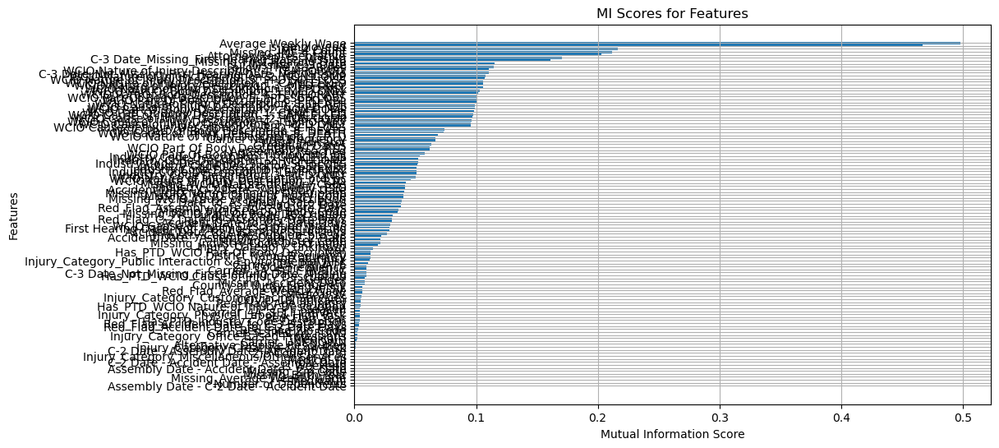

Testing 1 features with RFE...
Testing 4 features with RFE...
Testing 7 features with RFE...
Testing 10 features with RFE...
Testing 13 features with RFE...
Testing 16 features with RFE...
Testing 19 features with RFE...
Testing 22 features with RFE...
Testing 25 features with RFE...
Testing 28 features with RFE...
Testing 31 features with RFE...
Testing 34 features with RFE...
Testing 37 features with RFE...
Testing 40 features with RFE...
Testing 43 features with RFE...
Testing 46 features with RFE...
Testing 49 features with RFE...
Testing 52 features with RFE...
Testing 55 features with RFE...
Testing 58 features with RFE...
Testing 61 features with RFE...
Testing 64 features with RFE...
Testing 67 features with RFE...
Optimum number of features: 34
Best F1 Macro Score: 0.4367
Number of iterations performed: [151]
Features selected by Lasso (Threshold > 0.01): 54
['Agreement Reached', 'is_employeed', 'IME-4 Count', 'Average Weekly Wage', 'Missing_IME-4 Count', 'WCIO Part Of Body De

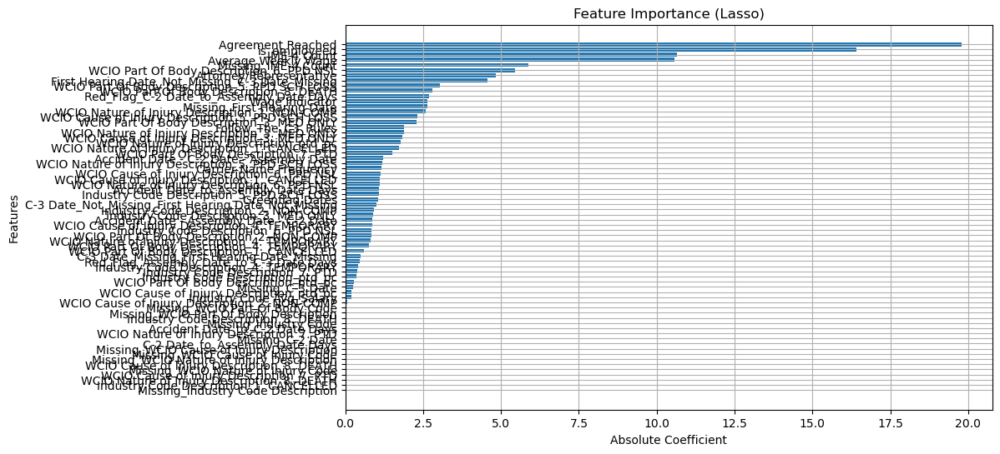

[I 2024-12-22 01:12:11,895] A new study created in memory with name: no-name-e2e5dde5-5e65-453d-802d-6f5db655066b


Otimização para log...


[I 2024-12-22 01:12:16,281] Trial 0 finished with value: 0.38247887195717134 and parameters: {'C': 13.993528959665849, 'penalty': 'l2', 'solver': 'lbfgs', 'max_iter': 157, 'multi_class': 'multinomial'}. Best is trial 0 with value: 0.38247887195717134.
[I 2024-12-22 01:12:33,579] Trial 1 finished with value: 0.3679399023560237 and parameters: {'C': 44.64305444868106, 'penalty': 'l2', 'solver': 'lbfgs', 'max_iter': 895, 'multi_class': 'ovr'}. Best is trial 0 with value: 0.38247887195717134.
[I 2024-12-22 01:15:19,236] Trial 2 finished with value: 0.37056977245490824 and parameters: {'C': 3.126675765868489, 'penalty': 'none', 'solver': 'sag', 'max_iter': 554, 'multi_class': 'ovr'}. Best is trial 0 with value: 0.38247887195717134.
[I 2024-12-22 01:15:30,549] Trial 3 finished with value: 0.3713181779909013 and parameters: {'C': 0.00015164871560309408, 'penalty': 'none', 'solver': 'lbfgs', 'max_iter': 215, 'multi_class': 'ovr'}. Best is trial 0 with value: 0.38247887195717134.
[I 2024-12-22 

Otimização para mlp...


[I 2024-12-22 01:30:08,205] Trial 0 finished with value: 0.382470567485763 and parameters: {'hidden_layer_sizes': (200,), 'activation': 'tanh', 'solver': 'adam', 'alpha': 0.01708001377721356, 'learning_rate': 'adaptive', 'learning_rate_init': 0.0006058965616205773, 'max_iter': 929}. Best is trial 0 with value: 0.382470567485763.
[I 2024-12-22 01:30:16,188] Trial 1 finished with value: 0.39373107178352507 and parameters: {'hidden_layer_sizes': (100,), 'activation': 'relu', 'solver': 'adam', 'alpha': 0.0001023686082083905, 'learning_rate': 'invscaling', 'learning_rate_init': 0.034999248862086614, 'max_iter': 520}. Best is trial 1 with value: 0.39373107178352507.
[I 2024-12-22 01:31:17,887] Trial 2 finished with value: 0.33970762326305826 and parameters: {'hidden_layer_sizes': (100,), 'activation': 'relu', 'solver': 'sgd', 'alpha': 0.176096360756763, 'learning_rate': 'adaptive', 'learning_rate_init': 0.006428841162734762, 'max_iter': 967}. Best is trial 1 with value: 0.39373107178352507.


Otimização para rf...


[I 2024-12-22 02:38:31,659] Trial 0 finished with value: 0.3315660434025969 and parameters: {'n_estimators': 159, 'max_depth': 7, 'min_samples_split': 3, 'min_samples_leaf': 5, 'max_features': 'auto', 'bootstrap': True}. Best is trial 0 with value: 0.3315660434025969.
[I 2024-12-22 02:38:34,814] Trial 1 finished with value: 0.21475653373125245 and parameters: {'n_estimators': 61, 'max_depth': 3, 'min_samples_split': 11, 'min_samples_leaf': 12, 'max_features': 'auto', 'bootstrap': True}. Best is trial 0 with value: 0.3315660434025969.
[I 2024-12-22 02:38:52,992] Trial 2 finished with value: 0.29897350902954534 and parameters: {'n_estimators': 292, 'max_depth': 5, 'min_samples_split': 16, 'min_samples_leaf': 15, 'max_features': 'log2', 'bootstrap': False}. Best is trial 0 with value: 0.3315660434025969.
[I 2024-12-22 02:39:08,237] Trial 3 finished with value: 0.3016922086767032 and parameters: {'n_estimators': 224, 'max_depth': 5, 'min_samples_split': 19, 'min_samples_leaf': 8, 'max_feat

Otimização para lgbm...
[LightGBM] [Warning] lambda_l1 is set=0.001152984736935751, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.001152984736935751
[LightGBM] [Warning] lambda_l2 is set=1.0901040048682077e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0901040048682077e-05
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=0.001152984736935751, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.001152984736935751
[LightGBM] [Warning] lambda_l2 is set=1.0901040048682077e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.0901040048682077e-05
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002314 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1133
[LightGBM] [Info] Number of data points in the train set: 76536, number of use

[I 2024-12-22 02:44:25,801] Trial 0 finished with value: 0.4115350294171114 and parameters: {'max_depth': 3, 'learning_rate': 0.03495480600062643, 'n_estimators': 189, 'num_leaves': 129, 'min_child_samples': 55, 'subsample': 0.745572644393236, 'colsample_bytree': 0.8689207982374845, 'lambda_l1': 0.001152984736935751, 'lambda_l2': 1.0901040048682077e-05, 'scale_pos_weight': 6.76939502677849}. Best is trial 0 with value: 0.4115350294171114.


[LightGBM] [Warning] lambda_l1 is set=3.35991087320986e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.35991087320986e-08
[LightGBM] [Warning] lambda_l2 is set=7.365043840404552e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.365043840404552e-08
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=3.35991087320986e-08, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.35991087320986e-08
[LightGBM] [Warning] lambda_l2 is set=7.365043840404552e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=7.365043840404552e-08
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.009743 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1133
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 29
[LightGBM] [Info] Start training from score -3.828537
[LightGBM] [Info] Start

[I 2024-12-22 02:44:31,321] Trial 1 finished with value: 0.4009949421607192 and parameters: {'max_depth': 4, 'learning_rate': 0.019809400885119254, 'n_estimators': 145, 'num_leaves': 253, 'min_child_samples': 89, 'subsample': 0.7911909683664109, 'colsample_bytree': 0.5620020909973849, 'lambda_l1': 3.35991087320986e-08, 'lambda_l2': 7.365043840404552e-08, 'scale_pos_weight': 6.225703177064545}. Best is trial 0 with value: 0.4115350294171114.


[LightGBM] [Warning] lambda_l1 is set=0.5969471699011387, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5969471699011387
[LightGBM] [Warning] lambda_l2 is set=1.4406786161834106e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4406786161834106e-08
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=0.5969471699011387, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5969471699011387
[LightGBM] [Warning] lambda_l2 is set=1.4406786161834106e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=1.4406786161834106e-08
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002878 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1133
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 29
[LightGBM] [Info]

[I 2024-12-22 02:44:35,505] Trial 2 finished with value: 0.39717490803264177 and parameters: {'max_depth': 8, 'learning_rate': 0.0978230481062199, 'n_estimators': 60, 'num_leaves': 143, 'min_child_samples': 21, 'subsample': 0.7296109060746293, 'colsample_bytree': 0.6957800840043681, 'lambda_l1': 0.5969471699011387, 'lambda_l2': 1.4406786161834106e-08, 'scale_pos_weight': 1.7443138481056542}. Best is trial 0 with value: 0.4115350294171114.


[LightGBM] [Warning] lambda_l1 is set=3.927791971524572e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.927791971524572e-07
[LightGBM] [Warning] lambda_l2 is set=4.13216131664074e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.13216131664074e-06
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=3.927791971524572e-07, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.927791971524572e-07
[LightGBM] [Warning] lambda_l2 is set=4.13216131664074e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.13216131664074e-06
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.010388 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1133
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 29
[LightGBM] [Info] Start training from score -3.828537
[LightGBM] [Info] Start

[I 2024-12-22 02:44:39,150] Trial 3 finished with value: 0.3396606385576248 and parameters: {'max_depth': 6, 'learning_rate': 0.011860610498934476, 'n_estimators': 64, 'num_leaves': 138, 'min_child_samples': 62, 'subsample': 0.7124701870927607, 'colsample_bytree': 0.5445773944100165, 'lambda_l1': 3.927791971524572e-07, 'lambda_l2': 4.13216131664074e-06, 'scale_pos_weight': 7.746891690674799}. Best is trial 0 with value: 0.4115350294171114.


[LightGBM] [Warning] lambda_l1 is set=0.00017849762318260888, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00017849762318260888
[LightGBM] [Warning] lambda_l2 is set=4.059671152554215e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.059671152554215e-06
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=0.00017849762318260888, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00017849762318260888
[LightGBM] [Warning] lambda_l2 is set=4.059671152554215e-06, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.059671152554215e-06
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002917 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1133
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 29
[Ligh

[I 2024-12-22 02:44:46,198] Trial 4 finished with value: 0.42222161754585535 and parameters: {'max_depth': 9, 'learning_rate': 0.014641478796532275, 'n_estimators': 123, 'num_leaves': 89, 'min_child_samples': 49, 'subsample': 0.5082977612688964, 'colsample_bytree': 0.9324093690283647, 'lambda_l1': 0.00017849762318260888, 'lambda_l2': 4.059671152554215e-06, 'scale_pos_weight': 9.982031411044924}. Best is trial 4 with value: 0.42222161754585535.


[LightGBM] [Warning] lambda_l1 is set=3.1267572557041496e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.1267572557041496e-05
[LightGBM] [Warning] lambda_l2 is set=0.007545344210041686, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.007545344210041686
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=3.1267572557041496e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=3.1267572557041496e-05
[LightGBM] [Warning] lambda_l2 is set=0.007545344210041686, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.007545344210041686
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003528 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1133
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 29
[LightGBM

[I 2024-12-22 02:44:49,456] Trial 5 finished with value: 0.38106139287493235 and parameters: {'max_depth': 4, 'learning_rate': 0.01701285527074563, 'n_estimators': 91, 'num_leaves': 49, 'min_child_samples': 39, 'subsample': 0.8855893165515223, 'colsample_bytree': 0.7115141795976299, 'lambda_l1': 3.1267572557041496e-05, 'lambda_l2': 0.007545344210041686, 'scale_pos_weight': 6.342477521277563}. Best is trial 4 with value: 0.42222161754585535.


[LightGBM] [Warning] lambda_l1 is set=0.5273168827394141, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5273168827394141
[LightGBM] [Warning] lambda_l2 is set=0.8481767654170369, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8481767654170369
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=0.5273168827394141, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.5273168827394141
[LightGBM] [Warning] lambda_l2 is set=0.8481767654170369, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8481767654170369
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002740 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1133
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 29
[LightGBM] [Info] Start training 

[I 2024-12-22 02:44:58,983] Trial 6 finished with value: 0.4282305614186472 and parameters: {'max_depth': 6, 'learning_rate': 0.04505634265693972, 'n_estimators': 203, 'num_leaves': 160, 'min_child_samples': 63, 'subsample': 0.5540683058341971, 'colsample_bytree': 0.6661613390579673, 'lambda_l1': 0.5273168827394141, 'lambda_l2': 0.8481767654170369, 'scale_pos_weight': 2.3353336258219377}. Best is trial 6 with value: 0.4282305614186472.


[LightGBM] [Warning] lambda_l1 is set=1.3602795778860734e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3602795778860734e-06
[LightGBM] [Warning] lambda_l2 is set=0.2316642751546094, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2316642751546094
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=1.3602795778860734e-06, reg_alpha=0.0 will be ignored. Current value: lambda_l1=1.3602795778860734e-06
[LightGBM] [Warning] lambda_l2 is set=0.2316642751546094, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.2316642751546094
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002612 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1133
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 29
[LightGBM] [Info]

[I 2024-12-22 02:45:03,644] Trial 7 finished with value: 0.39661847303011744 and parameters: {'max_depth': 4, 'learning_rate': 0.018418290095505187, 'n_estimators': 137, 'num_leaves': 149, 'min_child_samples': 95, 'subsample': 0.6861142117605196, 'colsample_bytree': 0.7406634609467975, 'lambda_l1': 1.3602795778860734e-06, 'lambda_l2': 0.2316642751546094, 'scale_pos_weight': 6.632186740152779}. Best is trial 6 with value: 0.4282305614186472.


[LightGBM] [Warning] lambda_l1 is set=0.0012914319273214872, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0012914319273214872
[LightGBM] [Warning] lambda_l2 is set=0.008137993750469754, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.008137993750469754
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=0.0012914319273214872, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0012914319273214872
[LightGBM] [Warning] lambda_l2 is set=0.008137993750469754, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.008137993750469754
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.006671 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1133
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 29
[LightGBM] [I

[I 2024-12-22 02:45:11,396] Trial 8 finished with value: 0.4104373543959018 and parameters: {'max_depth': 4, 'learning_rate': 0.13659646261686223, 'n_estimators': 221, 'num_leaves': 189, 'min_child_samples': 18, 'subsample': 0.8716280301308135, 'colsample_bytree': 0.7571099465493845, 'lambda_l1': 0.0012914319273214872, 'lambda_l2': 0.008137993750469754, 'scale_pos_weight': 4.422327643494941}. Best is trial 6 with value: 0.4282305614186472.


[LightGBM] [Warning] lambda_l1 is set=5.3198191274869215e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.3198191274869215e-05
[LightGBM] [Warning] lambda_l2 is set=4.473973067444771e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.473973067444771e-08
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=5.3198191274869215e-05, reg_alpha=0.0 will be ignored. Current value: lambda_l1=5.3198191274869215e-05
[LightGBM] [Warning] lambda_l2 is set=4.473973067444771e-08, reg_lambda=0.0 will be ignored. Current value: lambda_l2=4.473973067444771e-08
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.015301 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1133
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 29
[LightGBM] [Info] Start training from score -3.828537
[LightGBM] [Inf

[I 2024-12-22 02:45:15,127] Trial 9 finished with value: 0.38026246679873904 and parameters: {'max_depth': 3, 'learning_rate': 0.020276615439146026, 'n_estimators': 118, 'num_leaves': 142, 'min_child_samples': 40, 'subsample': 0.8644921030278043, 'colsample_bytree': 0.8784075021357207, 'lambda_l1': 5.3198191274869215e-05, 'lambda_l2': 4.473973067444771e-08, 'scale_pos_weight': 7.836821101332031}. Best is trial 6 with value: 0.4282305614186472.


[LightGBM] [Warning] lambda_l1 is set=0.9117868930390856, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9117868930390856
[LightGBM] [Warning] lambda_l2 is set=0.8842361435507751, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8842361435507751
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=0.9117868930390856, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.9117868930390856
[LightGBM] [Warning] lambda_l2 is set=0.8842361435507751, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8842361435507751
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002721 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1133
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 29
[LightGBM] [Info] Start training 

[I 2024-12-22 02:45:30,592] Trial 10 finished with value: 0.429401343861636 and parameters: {'max_depth': 7, 'learning_rate': 0.28193184891837425, 'n_estimators': 279, 'num_leaves': 213, 'min_child_samples': 75, 'subsample': 0.5022989734639706, 'colsample_bytree': 0.6106876071175258, 'lambda_l1': 0.9117868930390856, 'lambda_l2': 0.8842361435507751, 'scale_pos_weight': 1.0185602171253345}. Best is trial 10 with value: 0.429401343861636.


[LightGBM] [Warning] lambda_l1 is set=0.7828403990487288, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7828403990487288
[LightGBM] [Warning] lambda_l2 is set=0.8384360770965815, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8384360770965815
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=0.7828403990487288, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.7828403990487288
[LightGBM] [Warning] lambda_l2 is set=0.8384360770965815, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.8384360770965815
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002572 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1133
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 29
[LightGBM] [Info] Start training 

[I 2024-12-22 02:45:46,881] Trial 11 finished with value: 0.42781598718233005 and parameters: {'max_depth': 7, 'learning_rate': 0.2759052269685569, 'n_estimators': 297, 'num_leaves': 216, 'min_child_samples': 79, 'subsample': 0.5222476585215887, 'colsample_bytree': 0.6235105068023021, 'lambda_l1': 0.7828403990487288, 'lambda_l2': 0.8384360770965815, 'scale_pos_weight': 1.1430983226698717}. Best is trial 10 with value: 0.429401343861636.


[LightGBM] [Warning] lambda_l1 is set=0.02414635069372792, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.02414635069372792
[LightGBM] [Warning] lambda_l2 is set=0.019625091466339176, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.019625091466339176
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=0.02414635069372792, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.02414635069372792
[LightGBM] [Warning] lambda_l2 is set=0.019625091466339176, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.019625091466339176
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002433 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1133
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 29
[LightGBM] [Info] Sta

[I 2024-12-22 02:45:59,574] Trial 12 finished with value: 0.4300167747077078 and parameters: {'max_depth': 6, 'learning_rate': 0.051379385624287933, 'n_estimators': 263, 'num_leaves': 197, 'min_child_samples': 70, 'subsample': 0.593839395137986, 'colsample_bytree': 0.6321901773668077, 'lambda_l1': 0.02414635069372792, 'lambda_l2': 0.019625091466339176, 'scale_pos_weight': 2.98261973122103}. Best is trial 12 with value: 0.4300167747077078.


[LightGBM] [Warning] lambda_l1 is set=0.026760294571551223, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.026760294571551223
[LightGBM] [Warning] lambda_l2 is set=0.010427934078146607, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.010427934078146607
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=0.026760294571551223, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.026760294571551223
[LightGBM] [Warning] lambda_l2 is set=0.010427934078146607, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.010427934078146607
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002839 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1133
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 29
[LightGBM] [Info]

[I 2024-12-22 02:46:23,599] Trial 13 finished with value: 0.428673821755194 and parameters: {'max_depth': 10, 'learning_rate': 0.08405889022138714, 'n_estimators': 285, 'num_leaves': 222, 'min_child_samples': 78, 'subsample': 0.6168929611482312, 'colsample_bytree': 0.5024720096854206, 'lambda_l1': 0.026760294571551223, 'lambda_l2': 0.010427934078146607, 'scale_pos_weight': 3.445435742173867}. Best is trial 12 with value: 0.4300167747077078.


[LightGBM] [Warning] lambda_l1 is set=0.021804811909104178, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.021804811909104178
[LightGBM] [Warning] lambda_l2 is set=0.0006060394647450987, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006060394647450987
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=0.021804811909104178, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.021804811909104178
[LightGBM] [Warning] lambda_l2 is set=0.0006060394647450987, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0006060394647450987
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002488 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1133
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 29
[LightGBM] [I

[I 2024-12-22 02:46:38,528] Trial 14 finished with value: 0.3707156578107185 and parameters: {'max_depth': 7, 'learning_rate': 0.28556829156454333, 'n_estimators': 254, 'num_leaves': 194, 'min_child_samples': 76, 'subsample': 0.5857852057994589, 'colsample_bytree': 0.5875158869397359, 'lambda_l1': 0.021804811909104178, 'lambda_l2': 0.0006060394647450987, 'scale_pos_weight': 3.0977731828798722}. Best is trial 12 with value: 0.4300167747077078.


[LightGBM] [Warning] lambda_l1 is set=0.018458243615156366, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.018458243615156366
[LightGBM] [Warning] lambda_l2 is set=0.05615302409153811, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.05615302409153811
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=0.018458243615156366, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.018458243615156366
[LightGBM] [Warning] lambda_l2 is set=0.05615302409153811, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.05615302409153811
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002652 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1133
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 29
[LightGBM] [Info] Sta

[I 2024-12-22 02:46:51,601] Trial 15 finished with value: 0.4266260060090989 and parameters: {'max_depth': 6, 'learning_rate': 0.16156899537961295, 'n_estimators': 250, 'num_leaves': 249, 'min_child_samples': 100, 'subsample': 0.9981168442342344, 'colsample_bytree': 0.6347422599407095, 'lambda_l1': 0.018458243615156366, 'lambda_l2': 0.05615302409153811, 'scale_pos_weight': 4.3002431333294435}. Best is trial 12 with value: 0.4300167747077078.


[LightGBM] [Warning] lambda_l1 is set=0.051085152622566875, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.051085152622566875
[LightGBM] [Warning] lambda_l2 is set=0.00029445214280249195, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00029445214280249195
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=0.051085152622566875, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.051085152622566875
[LightGBM] [Warning] lambda_l2 is set=0.00029445214280249195, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00029445214280249195
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002491 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1133
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 29
[LightGBM

[I 2024-12-22 02:47:08,281] Trial 16 finished with value: 0.4270210226132807 and parameters: {'max_depth': 8, 'learning_rate': 0.07188790470232972, 'n_estimators': 257, 'num_leaves': 185, 'min_child_samples': 67, 'subsample': 0.6340420250440002, 'colsample_bytree': 0.7920798580853254, 'lambda_l1': 0.051085152622566875, 'lambda_l2': 0.00029445214280249195, 'scale_pos_weight': 1.0845870515837346}. Best is trial 12 with value: 0.4300167747077078.


[LightGBM] [Warning] lambda_l1 is set=0.0030625955746841124, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0030625955746841124
[LightGBM] [Warning] lambda_l2 is set=0.050735667273458476, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.050735667273458476
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=0.0030625955746841124, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.0030625955746841124
[LightGBM] [Warning] lambda_l2 is set=0.050735667273458476, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.050735667273458476
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003152 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1133
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 29
[LightGBM] [I

[I 2024-12-22 02:47:18,404] Trial 17 finished with value: 0.4211360115591683 and parameters: {'max_depth': 5, 'learning_rate': 0.03203402190649996, 'n_estimators': 230, 'num_leaves': 221, 'min_child_samples': 83, 'subsample': 0.6542784544817484, 'colsample_bytree': 0.6159384807148712, 'lambda_l1': 0.0030625955746841124, 'lambda_l2': 0.050735667273458476, 'scale_pos_weight': 2.567825691435661}. Best is trial 12 with value: 0.4300167747077078.


[LightGBM] [Warning] lambda_l1 is set=0.18899740602462176, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.18899740602462176
[LightGBM] [Warning] lambda_l2 is set=0.00283101270115671, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00283101270115671
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=0.18899740602462176, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.18899740602462176
[LightGBM] [Warning] lambda_l2 is set=0.00283101270115671, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00283101270115671
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.009085 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1133
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 29
[LightGBM] [Info] Start training from score -3.828537
[LightGBM] [Info] Start training fr

[I 2024-12-22 02:47:35,298] Trial 18 finished with value: 0.43845809077969655 and parameters: {'max_depth': 8, 'learning_rate': 0.05313467004377827, 'n_estimators': 273, 'num_leaves': 174, 'min_child_samples': 70, 'subsample': 0.5788295795901185, 'colsample_bytree': 0.5098780992883558, 'lambda_l1': 0.18899740602462176, 'lambda_l2': 0.00283101270115671, 'scale_pos_weight': 4.44703617921475}. Best is trial 18 with value: 0.43845809077969655.


[LightGBM] [Warning] lambda_l1 is set=0.09429223360976631, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.09429223360976631
[LightGBM] [Warning] lambda_l2 is set=0.001835281785978889, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.001835281785978889
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=0.09429223360976631, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.09429223360976631
[LightGBM] [Warning] lambda_l2 is set=0.001835281785978889, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.001835281785978889
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.010971 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1133
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 29
[LightGBM] [Info] Start training from score -3.828537
[LightGBM] [Info] Start trainin

[I 2024-12-22 02:47:46,904] Trial 19 finished with value: 0.4354409064187582 and parameters: {'max_depth': 9, 'learning_rate': 0.054482923497575234, 'n_estimators': 177, 'num_leaves': 103, 'min_child_samples': 47, 'subsample': 0.5810331107983716, 'colsample_bytree': 0.5191915663343802, 'lambda_l1': 0.09429223360976631, 'lambda_l2': 0.001835281785978889, 'scale_pos_weight': 4.3996126081410845}. Best is trial 18 with value: 0.43845809077969655.


[LightGBM] [Warning] lambda_l1 is set=0.09103806678835595, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.09103806678835595
[LightGBM] [Warning] lambda_l2 is set=0.001406877057532284, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.001406877057532284
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=0.09103806678835595, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.09103806678835595
[LightGBM] [Warning] lambda_l2 is set=0.001406877057532284, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.001406877057532284
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.008589 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1133
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 29
[LightGBM] [Info] Start training from score -3.828537
[LightGBM] [Info] Start trainin

[I 2024-12-22 02:47:57,670] Trial 20 finished with value: 0.4263694478924134 and parameters: {'max_depth': 10, 'learning_rate': 0.028945803634919155, 'n_estimators': 166, 'num_leaves': 98, 'min_child_samples': 31, 'subsample': 0.8152801806186798, 'colsample_bytree': 0.5021471224020736, 'lambda_l1': 0.09103806678835595, 'lambda_l2': 0.001406877057532284, 'scale_pos_weight': 4.923896606911692}. Best is trial 18 with value: 0.43845809077969655.


[LightGBM] [Warning] lambda_l1 is set=0.005839505394614654, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.005839505394614654
[LightGBM] [Warning] lambda_l2 is set=2.5036958060205302e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5036958060205302e-05
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=0.005839505394614654, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.005839505394614654
[LightGBM] [Warning] lambda_l2 is set=2.5036958060205302e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=2.5036958060205302e-05
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.010217 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1133
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 29
[LightGBM] [Info] Start training from score -3.828537
[LightGBM] [Info] S

[I 2024-12-22 02:48:13,097] Trial 21 finished with value: 0.43649858956602067 and parameters: {'max_depth': 9, 'learning_rate': 0.05592738650414579, 'n_estimators': 226, 'num_leaves': 111, 'min_child_samples': 51, 'subsample': 0.5861432409164389, 'colsample_bytree': 0.5387332627366368, 'lambda_l1': 0.005839505394614654, 'lambda_l2': 2.5036958060205302e-05, 'scale_pos_weight': 3.827815331310554}. Best is trial 18 with value: 0.43845809077969655.


[LightGBM] [Warning] lambda_l1 is set=0.00554493837988937, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00554493837988937
[LightGBM] [Warning] lambda_l2 is set=3.288148777910484e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.288148777910484e-05
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=0.00554493837988937, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00554493837988937
[LightGBM] [Warning] lambda_l2 is set=3.288148777910484e-05, reg_lambda=0.0 will be ignored. Current value: lambda_l2=3.288148777910484e-05
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.003104 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1133
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 29
[LightGBM] [Info]

[I 2024-12-22 02:48:28,565] Trial 22 finished with value: 0.4348504731663503 and parameters: {'max_depth': 9, 'learning_rate': 0.064198911589096, 'n_estimators': 212, 'num_leaves': 109, 'min_child_samples': 49, 'subsample': 0.5649080354668379, 'colsample_bytree': 0.5419550292639159, 'lambda_l1': 0.00554493837988937, 'lambda_l2': 3.288148777910484e-05, 'scale_pos_weight': 3.8565461322897843}. Best is trial 18 with value: 0.43845809077969655.


[LightGBM] [Warning] lambda_l1 is set=0.10439959775209527, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.10439959775209527
[LightGBM] [Warning] lambda_l2 is set=0.0001175296651194514, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001175296651194514
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=0.10439959775209527, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.10439959775209527
[LightGBM] [Warning] lambda_l2 is set=0.0001175296651194514, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.0001175296651194514
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002919 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 1133
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 29
[LightGBM] [Info]

[I 2024-12-22 02:48:39,384] Trial 23 finished with value: 0.43418483204016856 and parameters: {'max_depth': 9, 'learning_rate': 0.043966166754811305, 'n_estimators': 177, 'num_leaves': 63, 'min_child_samples': 56, 'subsample': 0.6644139750381967, 'colsample_bytree': 0.5045087644311665, 'lambda_l1': 0.10439959775209527, 'lambda_l2': 0.0001175296651194514, 'scale_pos_weight': 5.514668926232552}. Best is trial 18 with value: 0.43845809077969655.


[LightGBM] [Warning] lambda_l1 is set=0.00057378533260771, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00057378533260771
[LightGBM] [Warning] lambda_l2 is set=6.302533744028843e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.302533744028843e-07
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=0.00057378533260771, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.00057378533260771
[LightGBM] [Warning] lambda_l2 is set=6.302533744028843e-07, reg_lambda=0.0 will be ignored. Current value: lambda_l2=6.302533744028843e-07
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.010271 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 1133
[LightGBM] [Info] Number of data points in the train set: 76536, number of used features: 29
[LightGBM] [Info] Start training from score -3.828537
[LightGBM] [Info] Start tra

[I 2024-12-22 02:48:52,807] Trial 24 finished with value: 0.4264023308119901 and parameters: {'max_depth': 8, 'learning_rate': 0.06199993556835959, 'n_estimators': 224, 'num_leaves': 69, 'min_child_samples': 39, 'subsample': 0.5529218131824098, 'colsample_bytree': 0.5649618787280482, 'lambda_l1': 0.00057378533260771, 'lambda_l2': 6.302533744028843e-07, 'scale_pos_weight': 5.286555050722249}. Best is trial 18 with value: 0.43845809077969655.
[I 2024-12-22 02:48:52,808] A new study created in memory with name: no-name-4c6251cb-9b24-425f-bba4-caa635549b82


Otimização para xgb...


[I 2024-12-22 02:48:57,346] Trial 0 finished with value: 0.44110219159455766 and parameters: {'max_depth': 8, 'learning_rate': 0.1925782285548377, 'n_estimators': 194, 'min_child_weight': 9, 'gamma': 0.9013636334569839, 'subsample': 0.9928605836074036, 'colsample_bytree': 0.7704592839766755, 'reg_alpha': 1.2944441108098132e-06, 'reg_lambda': 0.0015020448781401456}. Best is trial 0 with value: 0.44110219159455766.
[I 2024-12-22 02:49:00,005] Trial 1 finished with value: 0.3814330827042256 and parameters: {'max_depth': 10, 'learning_rate': 0.041742356813622976, 'n_estimators': 51, 'min_child_weight': 9, 'gamma': 0.2347226371386829, 'subsample': 0.527346406321437, 'colsample_bytree': 0.9699426595600056, 'reg_alpha': 0.04955662427373781, 'reg_lambda': 1.4563593926727466e-06}. Best is trial 0 with value: 0.44110219159455766.
[I 2024-12-22 02:49:02,556] Trial 2 finished with value: 0.3583047684090769 and parameters: {'max_depth': 3, 'learning_rate': 0.047035635055944894, 'n_estimators': 95, 

Training model: Logistic Regression
Logistic Regression - Accuracy: 0.7807, F1 Macro: 0.3854, F1 Weighted: 0.7308, Precision: 0.7466, Recall: 0.7807
Training model: Random Forest
Random Forest - Accuracy: 0.7917, F1 Macro: 0.3628, F1 Weighted: 0.7396, Precision: 0.7783, Recall: 0.7917
Training model: XGBoost
XGBoost - Accuracy: 0.7998, F1 Macro: 0.4623, F1 Weighted: 0.7613, Precision: 0.7689, Recall: 0.7998
Training model: LightGBM
[LightGBM] [Warning] lambda_l1 is set=0.18899740602462176, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.18899740602462176
[LightGBM] [Warning] lambda_l2 is set=0.00283101270115671, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00283101270115671
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] lambda_l1 is set=0.18899740602462176, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.18899740602462176
[LightGBM] [Warning] lambda_l2 is set=0.00283101270115671, reg_lambda=0.0 will

[I 2024-12-22 03:10:56,333] A new study created in memory with name: no-name-8e279603-8487-4ba4-b67e-59b11dea9583
[I 2024-12-22 03:10:56,465] Trial 0 finished with value: 0.4215595203186234 and parameters: {'weight_rf': 6, 'weight_xgb': 0, 'weight_lgbm': 9, 'weight_log_reg': 2, 'weight_mlp': 6}. Best is trial 0 with value: 0.4215595203186234.
[I 2024-12-22 03:10:56,569] Trial 1 finished with value: 0.4295701078721116 and parameters: {'weight_rf': 6, 'weight_xgb': 3, 'weight_lgbm': 10, 'weight_log_reg': 0, 'weight_mlp': 4}. Best is trial 1 with value: 0.4295701078721116.
[I 2024-12-22 03:10:56,669] Trial 2 finished with value: 0.42322717892557155 and parameters: {'weight_rf': 9, 'weight_xgb': 8, 'weight_lgbm': 6, 'weight_log_reg': 6, 'weight_mlp': 9}. Best is trial 1 with value: 0.4295701078721116.
[I 2024-12-22 03:10:56,770] Trial 3 finished with value: 0.4189318545240218 and parameters: {'weight_rf': 8, 'weight_xgb': 3, 'weight_lgbm': 8, 'weight_log_reg': 4, 'weight_mlp': 8}. Best is 

Best Weights Found: {'weight_rf': 0, 'weight_xgb': 10, 'weight_lgbm': 0, 'weight_log_reg': 0, 'weight_mlp': 0}
Validation F1 Macro: 0.4623
Validation Accuracy: 0.7998
[LightGBM] [Warning] lambda_l1 is set=0.18899740602462176, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.18899740602462176
[LightGBM] [Warning] lambda_l2 is set=0.00283101270115671, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00283101270115671


[I 2024-12-22 03:12:47,852] A new study created in memory with name: no-name-0deebfd3-ec59-4077-b7fb-f33bf61c8a96


Original class distribution: Counter({1: 194052, 3: 99005, 2: 45937, 4: 32187, 0: 8318, 5: 2807, 7: 314, 6: 64})


[I 2024-12-22 03:13:13,963] Trial 0 finished with value: 0.4824963188118424 and parameters: {'smote_increase_class_0': 13637, 'smote_increase_class_2': 12434, 'smote_increase_class_5': 9682, 'smote_increase_class_6': 372, 'smote_increase_class_7': 1351, 'undersample_factor_class_1': 0.6601837941131403, 'undersample_factor_class_3': 0.5515031098760933}. Best is trial 0 with value: 0.4824963188118424.
[I 2024-12-22 03:13:35,640] Trial 1 finished with value: 0.4847351281526252 and parameters: {'smote_increase_class_0': 6742, 'smote_increase_class_2': 14205, 'smote_increase_class_5': 9105, 'smote_increase_class_6': 76, 'smote_increase_class_7': 1392, 'undersample_factor_class_1': 0.43742256375636046, 'undersample_factor_class_3': 0.4631062007616123}. Best is trial 1 with value: 0.4847351281526252.
[I 2024-12-22 03:13:57,267] Trial 2 finished with value: 0.49078216957672866 and parameters: {'smote_increase_class_0': 12192, 'smote_increase_class_2': 19740, 'smote_increase_class_5': 3838, 'sm

Best parameters: {'smote_increase_class_0': 13746, 'smote_increase_class_2': 65607, 'smote_increase_class_5': 4373, 'smote_increase_class_6': 512, 'smote_increase_class_7': 1521, 'undersample_factor_class_1': 0.6021897686365212, 'undersample_factor_class_3': 0.37767707350708607}
Final class distribution: Counter({1: 116856, 2: 111544, 3: 37391, 4: 32187, 0: 22064, 5: 7180, 7: 1835, 6: 576})
Training model: Logistic Regression
Logistic Regression - Accuracy: 0.6531, F1 Macro: 0.4087, F1 Weighted: 0.6664, Precision: 0.7588, Recall: 0.6531
Training model: Random Forest
Random Forest - Accuracy: 0.7325, F1 Macro: 0.4436, F1 Weighted: 0.7333, Precision: 0.7529, Recall: 0.7325
Training model: XGBoost
XGBoost - Accuracy: 0.7663, F1 Macro: 0.4929, F1 Weighted: 0.7565, Precision: 0.7576, Recall: 0.7663
Training model: LightGBM
[LightGBM] [Warning] lambda_l1 is set=0.18899740602462176, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.18899740602462176
[LightGBM] [Warning] lambda_l2 is s

[I 2024-12-22 03:43:07,311] A new study created in memory with name: no-name-3c4475b4-9b1c-41af-ab56-15aa9f024d42
[I 2024-12-22 03:43:07,442] Trial 0 finished with value: 0.4524120374222885 and parameters: {'weight_rf': 8, 'weight_xgb': 2, 'weight_lgbm': 2, 'weight_log_reg': 3, 'weight_mlp': 0}. Best is trial 0 with value: 0.4524120374222885.
[I 2024-12-22 03:43:07,552] Trial 1 finished with value: 0.4652659760995188 and parameters: {'weight_rf': 2, 'weight_xgb': 6, 'weight_lgbm': 8, 'weight_log_reg': 10, 'weight_mlp': 5}. Best is trial 1 with value: 0.4652659760995188.
[I 2024-12-22 03:43:07,654] Trial 2 finished with value: 0.4380100987021263 and parameters: {'weight_rf': 8, 'weight_xgb': 1, 'weight_lgbm': 0, 'weight_log_reg': 8, 'weight_mlp': 3}. Best is trial 1 with value: 0.4652659760995188.
[I 2024-12-22 03:43:07,759] Trial 3 finished with value: 0.4644197354762262 and parameters: {'weight_rf': 10, 'weight_xgb': 10, 'weight_lgbm': 0, 'weight_log_reg': 5, 'weight_mlp': 3}. Best is

Best Weights Found: {'weight_rf': 0, 'weight_xgb': 6, 'weight_lgbm': 0, 'weight_log_reg': 0, 'weight_mlp': 1}
Validation F1 Macro: 0.4975
Validation Accuracy: 0.7659
[LightGBM] [Warning] lambda_l1 is set=0.18899740602462176, reg_alpha=0.0 will be ignored. Current value: lambda_l1=0.18899740602462176
[LightGBM] [Warning] lambda_l2 is set=0.00283101270115671, reg_lambda=0.0 will be ignored. Current value: lambda_l2=0.00283101270115671


In [47]:
from sklearn.model_selection import StratifiedKFold

# Set up StratifiedKFold
n_splits = 3
skf = StratifiedKFold(n_splits=n_splits, shuffle=True, random_state=42)

# Initialize dictionary to save results
results = {}

# Iterate over each stratified split
for fold_idx, (train_index, test_index) in enumerate(skf.split(X, y)):
    print(f"--- Fold {fold_idx + 1} ---")
    
    # Divide data 
    X_train, X_test = X.iloc[train_index], X.iloc[test_index]
    y_train, y_test = y.iloc[train_index], y.iloc[test_index]
    
    # Call Exodia
    X_train, X_test, y_train, y_test, best_params, \
    selected_features_rfe, selected_features_lasso, \
    final_selected_features, results_df, f1_per_class_df, \
    ensemble,ensemble_kaggle, trained_models, final_X, final_y, results_df_rs, f1_per_class_df_rs, \
    ensemble_rs,ensemble_kaggle_rs ,trained_models_rs, y_pred_test, final_weights, y_pred_kaggle, \
    y_pred_test_rs, final_weights_rs, y_pred_kaggle_rs, kaggle, kaggle_rs, f1, f1_rs = Exodia(X_train, X_test, y_train, y_test, test)

    # Save results
    results[fold_idx + 1] = {
        'X_train': X_train,
        'X_test': X_test,
        'y_train': y_train,
        'y_test': y_test,
        'best_params': best_params,
        'selected_features_rfe': selected_features_rfe,
        'selected_features_lasso': selected_features_lasso,
        'final_selected_features': final_selected_features,
        'results_df': results_df,
        'f1_per_class_df': f1_per_class_df,
        'ensemble': ensemble,
        'ensemble_kaggle': ensemble_kaggle,
        'trained_models':trained_models,
        'final_X':final_X, 
        'final_y':final_y,
        'results_df_rs': results_df_rs,
        'f1_per_class_df_rs': f1_per_class_df_rs,
        'ensemble_rs': ensemble_rs,
        'ensemble_kaggle_rs': ensemble_kaggle_rs,
        'trained_models_rs': trained_models_rs,
        'y_pred_test': y_pred_test, 
        'final_weights': final_weights, 
        'y_pred_kaggle': y_pred_kaggle,
        'y_pred_test_rs': y_pred_test_rs, 
        'final_weights_rs': final_weights_rs, 
        'y_pred_kaggle_rs': y_pred_kaggle_rs,
        'kaggle':kaggle,
        'kaggle_rs': kaggle_rs, 
        'f1': f1, 
        'f1_rs':f1_rs
    }

# <a class='anchor' id='5'></a>
## **Evaluation**

In [58]:
print(classification_report(results[1]['y_test'],results[1]['y_pred_test_rs'], digits= 3))

              precision    recall  f1-score   support

           0      0.635     0.602     0.618      4159
           1      0.876     0.936     0.905     97026
           2      0.360     0.270     0.309     22968
           3      0.831     0.676     0.746     49503
           4      0.537     0.849     0.658     16094
           5      0.161     0.066     0.093      1403
           6      0.077     0.031     0.044        32
           7      0.563     0.656     0.606       157

    accuracy                          0.768    191342
   macro avg      0.505     0.511     0.497    191342
weighted avg      0.763     0.768     0.759    191342



In [56]:
print(classification_report(results[2]['y_test'],results[2]['y_pred_test_rs'], digits= 3))

              precision    recall  f1-score   support

           0      0.589     0.607     0.598      4159
           1      0.884     0.906     0.895     97026
           2      0.339     0.299     0.318     22969
           3      0.826     0.693     0.754     49502
           4      0.546     0.829     0.658     16093
           5      0.149     0.133     0.141      1404
           6      0.000     0.000     0.000        32
           7      0.641     0.580     0.609       157

    accuracy                          0.759    191342
   macro avg      0.497     0.506     0.496    191342
weighted avg      0.763     0.759     0.757    191342



In [57]:
print(classification_report(results[3]['y_test'],results[3]['y_pred_test_rs'], digits= 3))

              precision    recall  f1-score   support

           0      0.600     0.595     0.598      4159
           1      0.874     0.930     0.902     97026
           2      0.351     0.262     0.300     22969
           3      0.822     0.689     0.750     49502
           4      0.549     0.840     0.664     16093
           5      0.147     0.056     0.081      1404
           6      0.375     0.091     0.146        33
           7      0.497     0.590     0.540       156

    accuracy                          0.766    191342
   macro avg      0.527     0.507     0.498    191342
weighted avg      0.759     0.766     0.757    191342



In [76]:
print(classification_report(results[1]['y_test'],results[1]['y_pred_test'], digits= 3))

              precision    recall  f1-score   support

           0      0.740     0.517     0.609      4159
           1      0.864     0.970     0.914     97026
           2      0.568     0.092     0.158     22968
           3      0.743     0.901     0.814     49503
           4      0.671     0.651     0.661     16094
           5      0.400     0.003     0.006      1403
           6      0.000     0.000     0.000        32
           7      0.673     0.484     0.563       157

    accuracy                          0.802    191342
   macro avg      0.582     0.452     0.466    191342
weighted avg      0.774     0.802     0.762    191342



In [77]:
print(classification_report(results[2]['y_test'],results[2]['y_pred_test'], digits= 3))

              precision    recall  f1-score   support

           0      0.732     0.501     0.595      4159
           1      0.863     0.970     0.913     97026
           2      0.574     0.090     0.155     22969
           3      0.744     0.902     0.816     49502
           4      0.667     0.650     0.658     16093
           5      0.300     0.002     0.004      1404
           6      0.000     0.000     0.000        32
           7      0.667     0.510     0.578       157

    accuracy                          0.802    191342
   macro avg      0.568     0.453     0.465    191342
weighted avg      0.774     0.802     0.762    191342



In [78]:
print(classification_report(results[3]['y_test'],results[3]['y_pred_test'], digits= 3))

              precision    recall  f1-score   support

           0      0.721     0.505     0.594      4159
           1      0.863     0.968     0.912     97026
           2      0.543     0.099     0.168     22969
           3      0.743     0.894     0.811     49502
           4      0.663     0.648     0.656     16093
           5      0.258     0.006     0.011      1404
           6      0.000     0.000     0.000        33
           7      0.611     0.494     0.546       156

    accuracy                          0.800    191342
   macro avg      0.550     0.452     0.462    191342
weighted avg      0.769     0.800     0.761    191342



In [79]:
results[1]['final_weights'] # FOLD 1

{'weight_rf': 0.0,
 'weight_xgb': 0.7777777777777778,
 'weight_lgbm': 0.2222222222222222,
 'weight_log_reg': 0.0,
 'weight_mlp': 0.0}

In [80]:
results[2]['final_weights'] # FOLD 2

{'weight_rf': 0.0,
 'weight_xgb': 0.8181818181818182,
 'weight_lgbm': 0.18181818181818182,
 'weight_log_reg': 0.0,
 'weight_mlp': 0.0}

In [81]:
results[3]['final_weights'] # FOLD 3

{'weight_rf': 0.0,
 'weight_xgb': 1.0,
 'weight_lgbm': 0.0,
 'weight_log_reg': 0.0,
 'weight_mlp': 0.0}

In [59]:
results[1]['final_weights_rs'] # FOLD 1

{'weight_rf': 0.0,
 'weight_xgb': 1.0,
 'weight_lgbm': 0.0,
 'weight_log_reg': 0.0,
 'weight_mlp': 0.0}

In [60]:
results[2]['final_weights_rs'] # FOLD 2

{'weight_rf': 0.0,
 'weight_xgb': 0.5714285714285714,
 'weight_lgbm': 0.0,
 'weight_log_reg': 0.2857142857142857,
 'weight_mlp': 0.14285714285714285}

In [61]:
results[3]['final_weights_rs'] # FOLD 3

{'weight_rf': 0.0,
 'weight_xgb': 0.8571428571428571,
 'weight_lgbm': 0.0,
 'weight_log_reg': 0.0,
 'weight_mlp': 0.14285714285714285}

# <a class='anchor' id='6'></a>

## **Open Ended Section**

In the following section, we will explore the feature contribution for the prediction of each class of the target variable.

In [62]:
from lime.lime_tabular import LimeTabularExplainer
from sklearn.preprocessing import LabelEncoder

y_train = toggle_mapping(y_train)

def lime(X_train, y_train, best_params):
    # Encode class labels to numeric values for compatibility with XGBoost
    label_encoder = LabelEncoder()
    y_train_encoded = label_encoder.fit_transform(y_train)

    # Train a model using XGBoost
    model = XGBClassifier(**best_params['xgb'])
    model.fit(X_train, y_train_encoded)

    # Create a LIME explainer
    explainer = LimeTabularExplainer(
        training_data=X_train.values,
        feature_names=X_train.columns,
        class_names=label_encoder.classes_,  # Use the original class names
        mode='classification'
    )

    # Select a test instance
    test_instance = X_train.iloc[0].values

    # Generate explanations for all classes
    for label_idx, label_name in enumerate(label_encoder.classes_):
        print(f"Explanation for class {label_name}:")
        explanation = explainer.explain_instance(
            data_row=test_instance,
            predict_fn=model.predict_proba,
            labels=[label_idx]  # Specify the numeric class to explain
        )

        # Visualize the explanation
        explanation.show_in_notebook()

        # Extract explanation details
        feature_names, contributions = zip(*explanation.as_list(label=label_idx))

        # Custom visualization for each class
        fig, ax = plt.subplots(figsize=(10, 6))

        # Colors based on contribution sign
        colors = ['green' if c > 0 else 'red' for c in contributions]

        # Horizontal bar chart
        ax.barh(feature_names, contributions, color=colors, edgecolor='black')

        # Add value annotations to the bars
        for i, (feature, contribution) in enumerate(zip(feature_names, contributions)):
            ax.text(
                contribution, i, f"{contribution:.2f}",
                ha='left' if contribution > 0 else 'right', va='center',
                color='black', fontsize=10
            )

        # Add titles and labels
        ax.set_title(f"LIME Explanation - Feature Contributions for Class {label_name}", fontsize=16, fontweight='bold')
        ax.set_xlabel("Contribution to Prediction", fontsize=12)
        ax.set_ylabel("Features", fontsize=12)
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)

        # Adjust layout for better appearance
        plt.tight_layout()
        plt.show()


Explanation for class 1. CANCELLED:


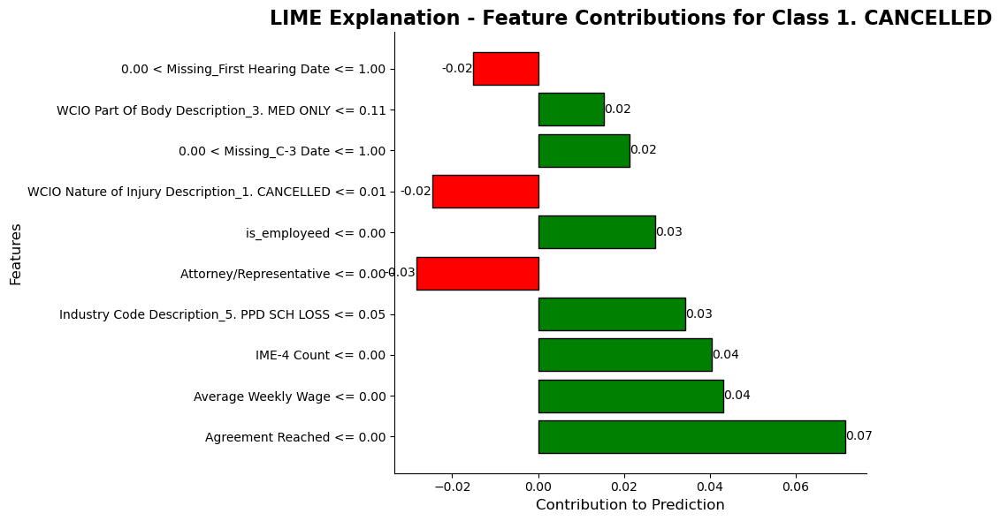

Explanation for class 2. NON-COMP:


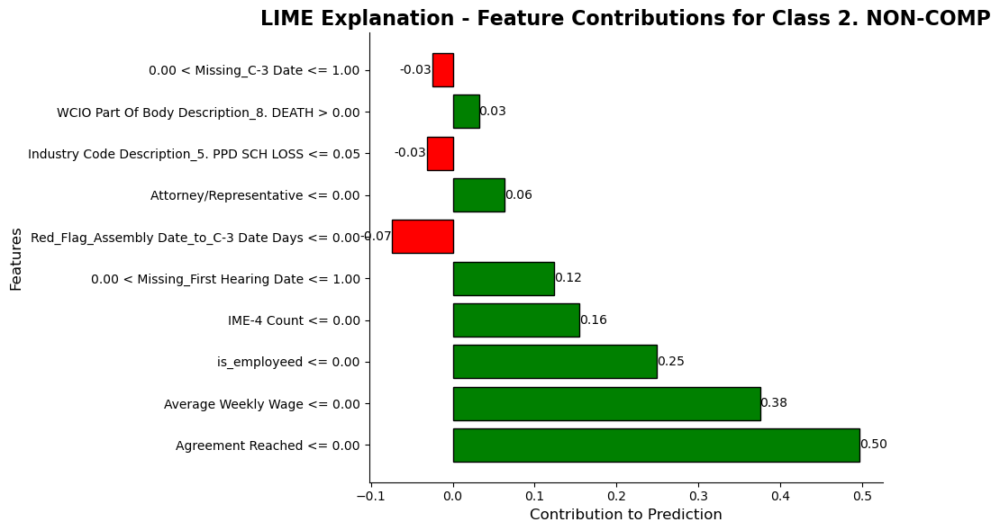

Explanation for class 3. MED ONLY:


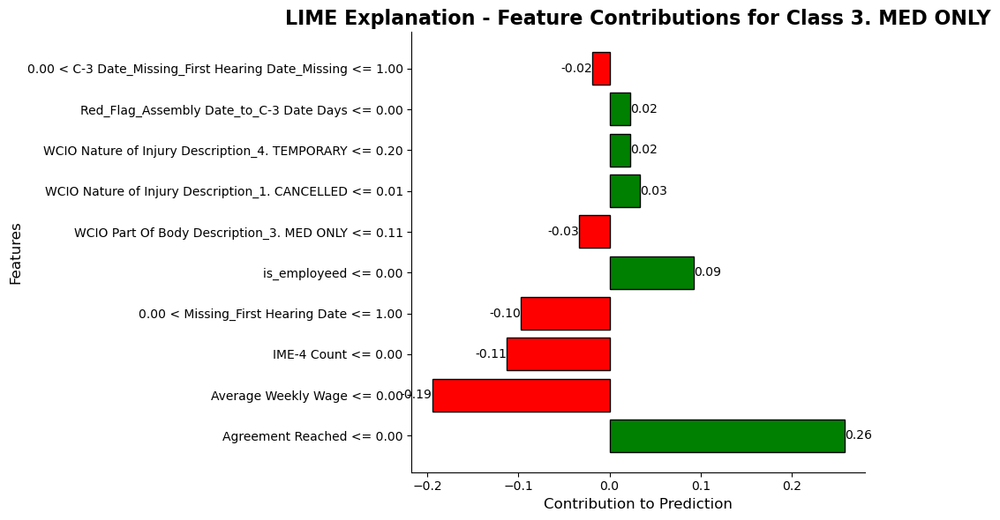

Explanation for class 4. TEMPORARY:


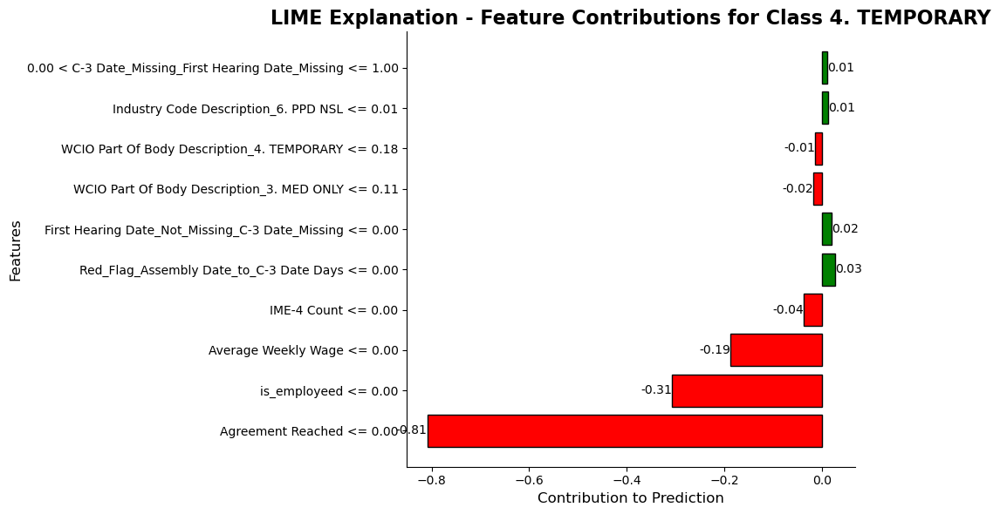

Explanation for class 5. PPD SCH LOSS:


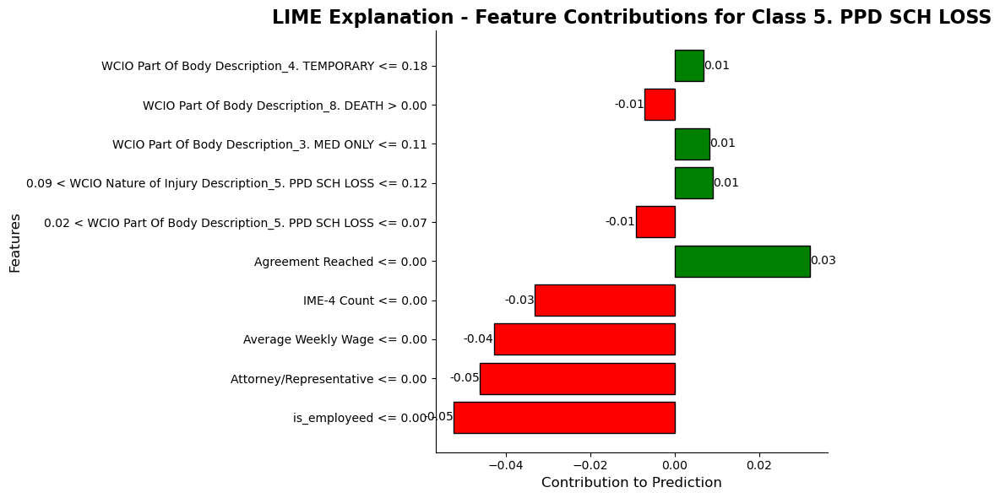

Explanation for class 6. PPD NSL:


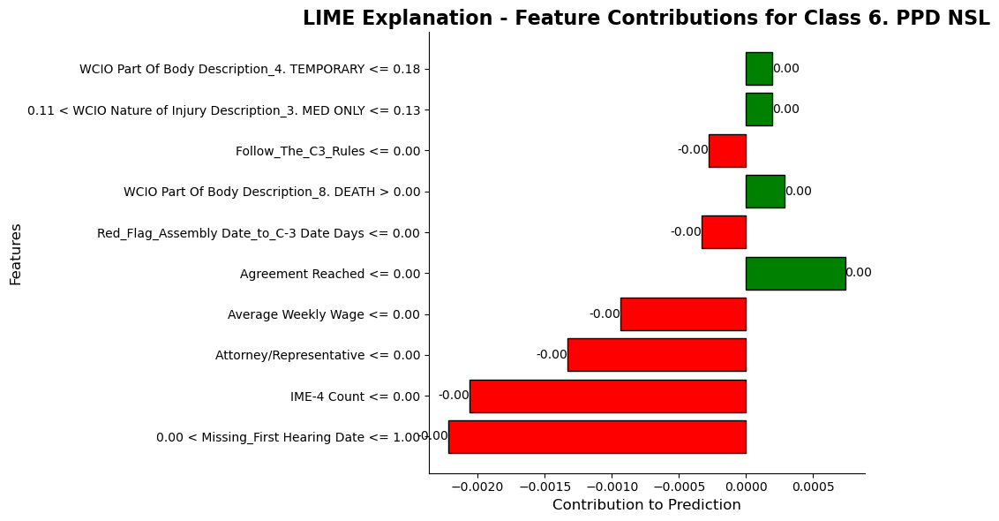

Explanation for class 7. PTD:


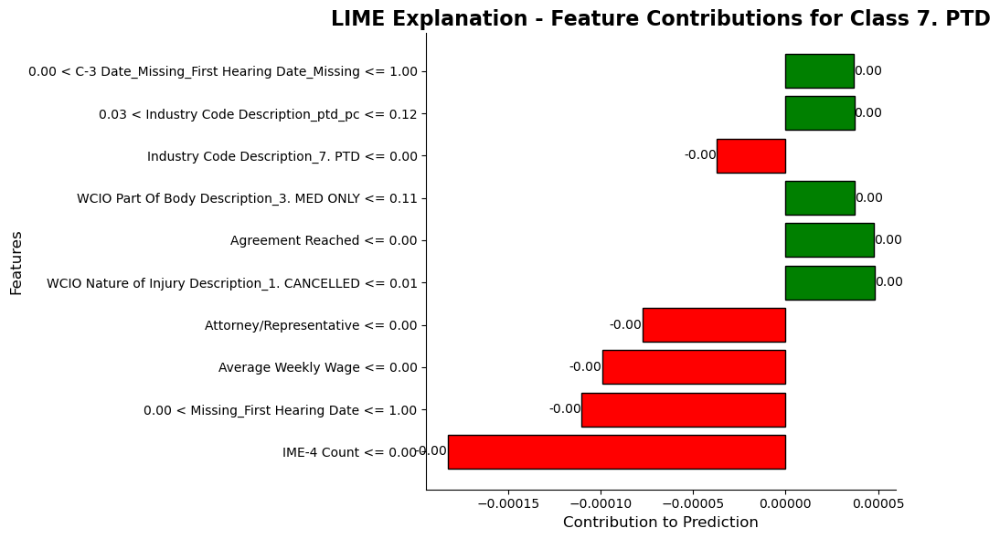

Explanation for class 8. DEATH:


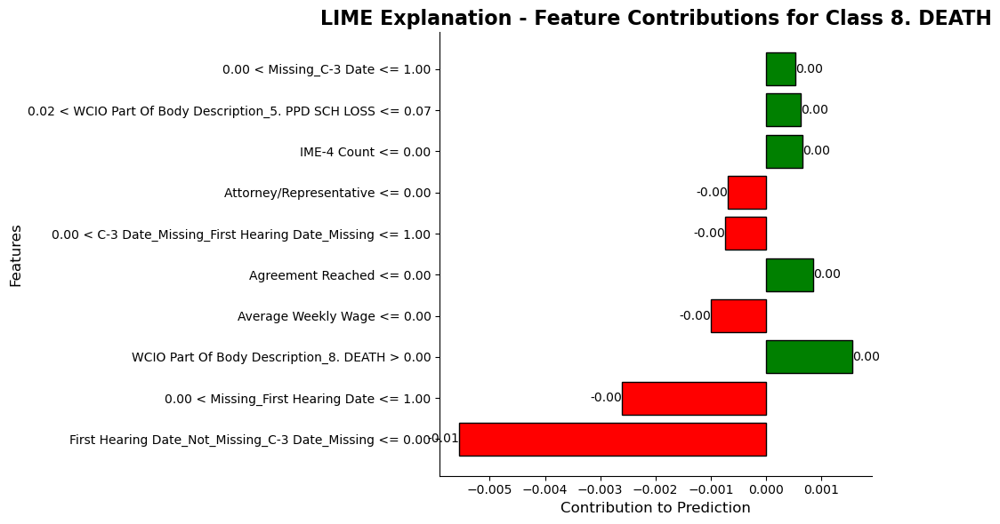

In [63]:
lime(X_train, y_train, best_params)

In [74]:
results[1]['kaggle'].to_csv('kaggle.csv', index=False)

In [75]:
results[1]['kaggle_rs'].to_csv('kaggle_rs.csv',index=False)